The goal of this notebook is to go through each step of the modularization process described in the paper "On decomposing a deep neural network into modules" by Pan & Rajan.

The source code was based on the [github page](https://github.com/rangeetpan/decomposeDNNintoModules) they used to document their work.

In [10]:
import os
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import keras
from keras.models import load_model
import pandas as pd


from utils.mnistutil import MNISTUitl
from utils.sliceutil import Slice
from utils.logger import setup_logger

sx = 28
sy = 28
path = "data/intermediate"

setup_logger('TI-I_FMNIST-1')
# from keras.models import load_model
# from datetime import datetime

accuracyCheck=[]
labs = [0,1,2,3,4,5,6,7,8,9]

In [53]:
def concat_series(param, path):
    result = pd.DataFrame()
    for index, file in [(file.split('_')[0], file) for file in os.listdir(path) if param in file]:
        df = pd.read_csv(os.path.join(path, file))
        
        if type(df) == pd.core.frame.DataFrame:
            df = df.drop(columns=['Unnamed: 0']).assign(digit=index)
            result = pd.concat([result, df])
        else:
            df = df['0'].rename(index)
            result = pd.concat([result, df], axis=1)
        
    
    return result

def plot_neuron_weights(W, neuron, pad=0, subplot_sizex=10, subplot_sizey=10):
    fig, axes = plt.subplots(subplot_sizex, subplot_sizey, figsize=(20, 20))

    for i, ax in enumerate(axes.flat):
        W[W.neuron == (i+pad)][['digit', str(neuron)]].set_index('digit').plot(ax=ax)
        ax.set_title(f'Weight {i+pad}')
        ax.legend().remove()

    plt.tight_layout()  # Adjust the spacing between subplots
    plt.show()

def plot_neuron_weights_05xticks(W, neuron, pad=0):
    fig, axes = plt.subplots(10, 10, figsize=(20, 20))

    for i, ax in enumerate(axes.flat):
        W[W.neuron == (i+pad)][['digit', str(neuron)]].set_index('digit').plot(ax=ax)
        ax.set_title(f'Neuron {i+pad}')
        ax.legend().remove()
        # ax.set_xticks([0, 1, 2, 3, 4, 5])

    plt.tight_layout()  # Adjust the spacing between subplots
    plt.show()

# Loading the data and training the model

In [2]:
mn = MNISTUitl()
X, Y, x, y = mn.getdata2(0,0,sx,sy)
#nm , xt, yt = mn.train2(X, Y, x,y,sx,sy,10,50)
xt, yt, xT, yT = mn.trainData(X, Y, x,y,sx,sy,10,50)

x_train shape: (48000, 28, 28, 1)
(48000, 28, 28, 1) 48000 train samples (48000,)
8000 test samples
(48000,) (48000,)


# Understanding how it breaks a single module

In [3]:
j = 2

First, it gets the weights and biases from the model.

In [4]:
slicingModel=load_model('emnist.h5')
#X, Y, x, y = mn.getdata2(0,0,sx,sy)
model=load_model('emnist.h5')
digit  = []
slc = Slice()
W1, W2, b1, b2 = slc.getweights(slicingModel)

In [5]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input (Flatten)             (None, 784)               0         
                                                                 
 H (Dense)                   (None, 49)                38465     
                                                                 
 output (Dense)              (None, 10)                500       
                                                                 
Total params: 38,965
Trainable params: 38,965
Non-trainable params: 0
_________________________________________________________________


Just one dense layer

Then, it gets the examples that belong to the module. In the code below, it sets apart only the True Positives (TP), meaning only the samples from the desired label that our model guessed correctly.

In [6]:
for i in range(0,len(yt)):
    if yT[i] == j and model.predict(xT[i:i+1])[0][j] >.9:
        digit.append(xT[i])

1/1 [==============================] - 0s 29ms/step


Observations:
- We can calculate this once, outside the for loop that the authors created.
- they are using the test samples. should they? How will they evaluate the model later?

In [7]:
digit

[array([[[0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00]],
 
        [[0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         

The variable digit contains the input values as arrays for all the true positives, regarding our module label.

# Concern Identification (CI)

Below, The authors perform the Concern Identification (CI) step of the approach.

- They go through each TP in the test set and update the weights and biases of the model, according to the output of the neurons.
    - If the output of a neuron is less than or equal to zero, the updated weight for the neuron is zero
    - If the output of a neuron is greater than zero
        - the updated weight gets the result of min(|model_weight|, updated_weight)
        - if the resulting updated weight is less than 0, then the updated weight is zero.
- The operation in lines 5 and 6 are done in order to not leave the module too sparse. 
    - If the last dense layer has less than 45 weights above 0, then the module is considered sparse


Observations:
- Why the min operation takes place? 
- How would different operations impact?
- Does the order of the TP matter?
- If the resulting model is sparse, then they reset the operation?

In [8]:
mc = 0
for x in digit:
    W1, W2,b1,b2 = slc.modifyThroughInterSection(slicingModel,x,mc,sx,sy)
    mc=mc+1
    if np.count_nonzero(slc.D2) < 45:
        #print("Breaking at mc ", mc,np.count_nonzero(slc.D2))
        slc.first = True

In [11]:
b1 = concat_series('b1', path)
print(f"Shape of b1: {b1.shape}")
b2 = concat_series('b2', path)
print(f"Shape of b2: {b2.shape}")
d1 = concat_series('dd1', path)
print(f"Shape of d1: {d1.shape}")
d2 = concat_series('dd2', path)
print(f"Shape of d2: {d2.shape}")
X1 = concat_series('X1', path)
print(f"Shape of X1: {X1.shape}")
X2 = concat_series('X2', path)
print(f"Shape of X2: {X2.shape}")
D1 = concat_series('D1', path)
print(f"Shape of D1: {D1.shape}")
D2 = concat_series('D2', path)
print(f"Shape of D2: {D2.shape}")
W1 = concat_series('W1', path)
print(f"Shape of W1: {W1.shape}")
W2 = concat_series('W2', path)
print(f"Shape of W2: {W2.shape}")

Shape of b1: (25480, 2)
Shape of b2: (5200, 2)
Shape of d1: (25480, 2)
Shape of d2: (5200, 2)
Shape of X1: (25480, 2)
Shape of X2: (5200, 2)
Shape of D1: (407680, 50)
Shape of D2: (25480, 11)
Shape of W1: (407680, 50)
Shape of W2: (25480, 11)


In [13]:
X1['output'] = X1['0']
X1 = X1.reset_index(names=['neuron']).drop(columns=['0'])

X2['output'] = X2['0']
X2 = X2.reset_index(names=['neuron']).drop(columns=['0'])

In [14]:
D1 = D1.reset_index(names=['neuron'])
W1 = W1.reset_index(names=['neuron'])

D2 = D2.reset_index(names=['neuron'])
W2 = W2.reset_index(names=['neuron'])

In [15]:
D1.digit = D1.digit.astype('int')
D1['weight'] = D1.groupby('digit')['digit'].transform('cumcount')
D1 = D1.sort_values(['digit', 'weight'])

D2.digit = D2.digit.astype('int')
D2['weight'] = D2.groupby('digit')['digit'].transform('cumcount')
D2 = D2.sort_values(['digit', 'weight'])

## Analysis of the initial executions

In [16]:
neuron = 39

#### Sample 0

In [17]:
X1[(X1.neuron == neuron) & (X1.digit == 0)]

,neuron,digit,output


In [18]:
D1_digit0_n28 = D1[D1['digit'] == 0][str(neuron)]
W1_n28 = W1[W1['digit'] == '0'][str(neuron)]

In [19]:
W1_n28

0      0.061867
1      0.043789
2     -0.006928
3     -0.035734
4      0.209710
         ...   
779    0.036392
780    0.069504
781    0.003899
782   -0.003720
783   -0.016240
Name: 39, Length: 784, dtype: float64

In [20]:
D1_digit0_n28

0      0.061867
1      0.043789
2     -0.006928
3     -0.035734
4      0.209710
         ...   
779    0.036392
780    0.069504
781    0.003899
782   -0.003720
783   -0.016240
Name: 39, Length: 784, dtype: float64

In [21]:
(D1_digit0_n28 - W1_n28).value_counts()

39
0.0    784
Name: count, dtype: int64

In the very first sample, the values of D are initialized with the values of W.

#### Sample 1

In [22]:
D1_digit1_n28 = D1[D1['digit'] == 1][str(neuron)]
W1_n28 = W1[W1['digit'] == '1'][str(neuron)]

In [23]:
X1[(X1.neuron == neuron)&(X1.digit == 1)]

,neuron,digit,output


Digit 1 output in this layer is above zero, so the weights should not be all updated to zero

In [24]:
D1_digit1_n28

87024    0.061867
87025    0.043789
87026    0.000000
87027    0.000000
87028    0.209710
           ...   
87803    0.036392
87804    0.069504
87805    0.003899
87806    0.000000
87807    0.000000
Name: 39, Length: 784, dtype: float64

In [25]:
W1_n28

87024    0.061867
87025    0.043789
87026   -0.006928
87027   -0.035734
87028    0.209710
           ...   
87803    0.036392
87804    0.069504
87805    0.003899
87806   -0.003720
87807   -0.016240
Name: 39, Length: 784, dtype: float64

In [26]:
D1_digit0_n28

0      0.061867
1      0.043789
2     -0.006928
3     -0.035734
4      0.209710
         ...   
779    0.036392
780    0.069504
781    0.003899
782   -0.003720
783   -0.016240
Name: 39, Length: 784, dtype: float64

The three first weights are below zero both in digit 0 and in the weight. so, the comparison would make the updated weight 0.

### Sample 2

In [27]:
D1_digit2_n28 = D1[D1['digit'] == 2][str(neuron)]
W1_n28 = W1[W1['digit'] == '2'][str(neuron)]

In [29]:
X1[(X1.neuron == neuron)&(X1.digit == '2')]

,neuron,digit,output
10917,39,2,0.574568


Digit 2 output in this layer is above zero, so the weights should not be all updated to zero

In [30]:
D1_digit2_n28

174048    0.061867
174049    0.043789
174050    0.000000
174051    0.000000
174052    0.209710
            ...   
174827    0.036392
174828    0.069504
174829    0.003899
174830    0.000000
174831    0.000000
Name: 39, Length: 784, dtype: float64

In [31]:
W1_n28

174048    0.061867
174049    0.043789
174050   -0.006928
174051   -0.035734
174052    0.209710
            ...   
174827    0.036392
174828    0.069504
174829    0.003899
174830   -0.003720
174831   -0.016240
Name: 39, Length: 784, dtype: float64

In [32]:
D1_digit1_n28.reset_index(drop=True)

0      0.061867
1      0.043789
2      0.000000
3      0.000000
4      0.209710
         ...   
779    0.036392
780    0.069504
781    0.003899
782    0.000000
783    0.000000
Name: 39, Length: 784, dtype: float64

In [33]:
(D1_digit2_n28.reset_index(drop=True) - D1_digit1_n28.reset_index(drop=True)).sum()

0.0

The three first weights are below zero both in digit 0 and in the weight. so, the comparison would make the updated weight 0.

## Digging Deep into the observations

In order to understand the questions raised, the operation was executed and the variables were saved at each step.

In this section, we read the resulting files and try to reason.

### Neurons Output

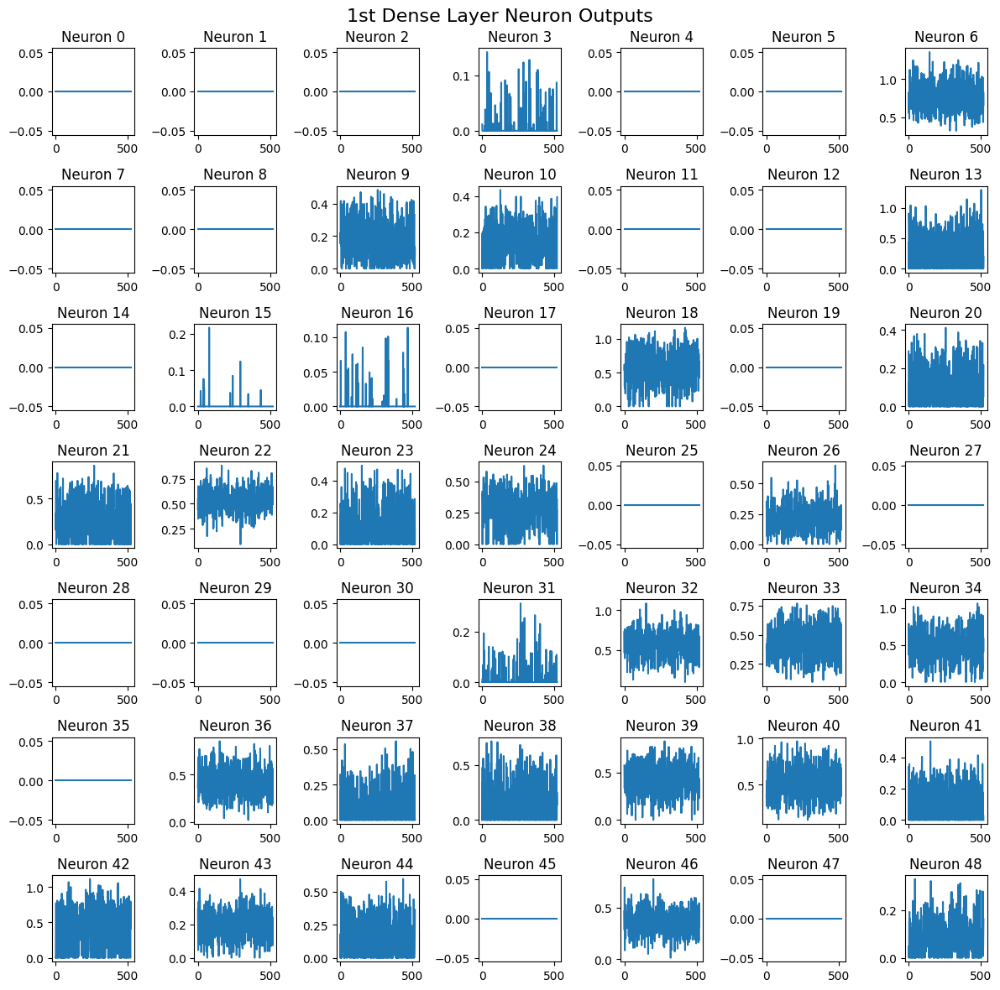

In [34]:
fig, axes = plt.subplots(7, 7, figsize=(12, 12))

for i, ax in enumerate(axes.flat):
    X1[X1.neuron == i].output.reset_index(drop=True).plot(ax=ax)
    ax.set_title(f'Neuron {i}')

fig.suptitle("1st Dense Layer Neuron Outputs", fontsize=16)
plt.tight_layout()  # Adjust the spacing between subplots
plt.show()

- Some neurons are not activated at all. E.g.: n0, n1, n25, n27, n47
- Because of the ReLU function, no output value is below zero. This can be clearly noticed in n3, n23, n38
- Neurons like n6, n22 and n3 behave as expected
- Neuron n15 looks interesting. Seems like just a few examples output something else than zero.

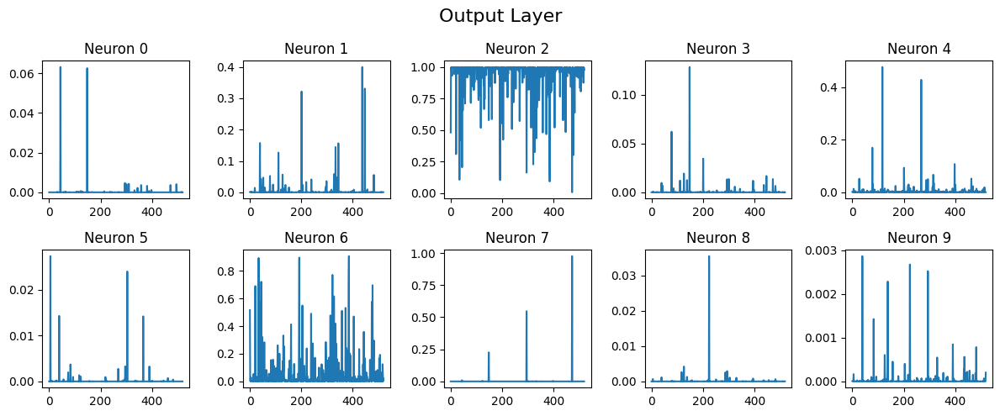

In [35]:
fig, axes = plt.subplots(2, 5, figsize=(12, 5))

for i, ax in enumerate(axes.flat):
    X2[X2.neuron == i].output.reset_index(drop=True).plot(ax=ax)
    ax.set_title(f'Neuron {i}')

fig.suptitle("Output Layer", fontsize=16)
plt.tight_layout()  # Adjust the spacing between subplots
plt.show()

In the output layer, Neuron 2 is the most activated. This is expected since we are dealing with the TP samples of this class. The other are also activated, but with lesser values.

All of them hit zero, besides Neuron 2.

### Dense layer

#### Regular Neuron

##### n6

In [38]:
r_neuron = 6

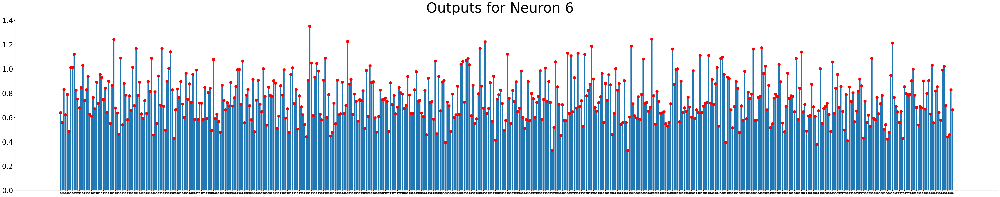

In [40]:
output_rn = X1[X1.neuron == r_neuron][['output', 'digit']].reset_index(drop=True)

fig, axes = plt.subplots(1, 1, figsize=(50, 10), sharex=True)

plt.bar(output_rn.digit, output_rn.output)
plt.scatter(output_rn.digit, output_rn.output, color='red', s=100)

axes.tick_params(axis='y', labelsize=25)

fig.suptitle(f"Outputs for Neuron {r_neuron}", fontsize=50)

# Display the plot
plt.tight_layout()
plt.show()

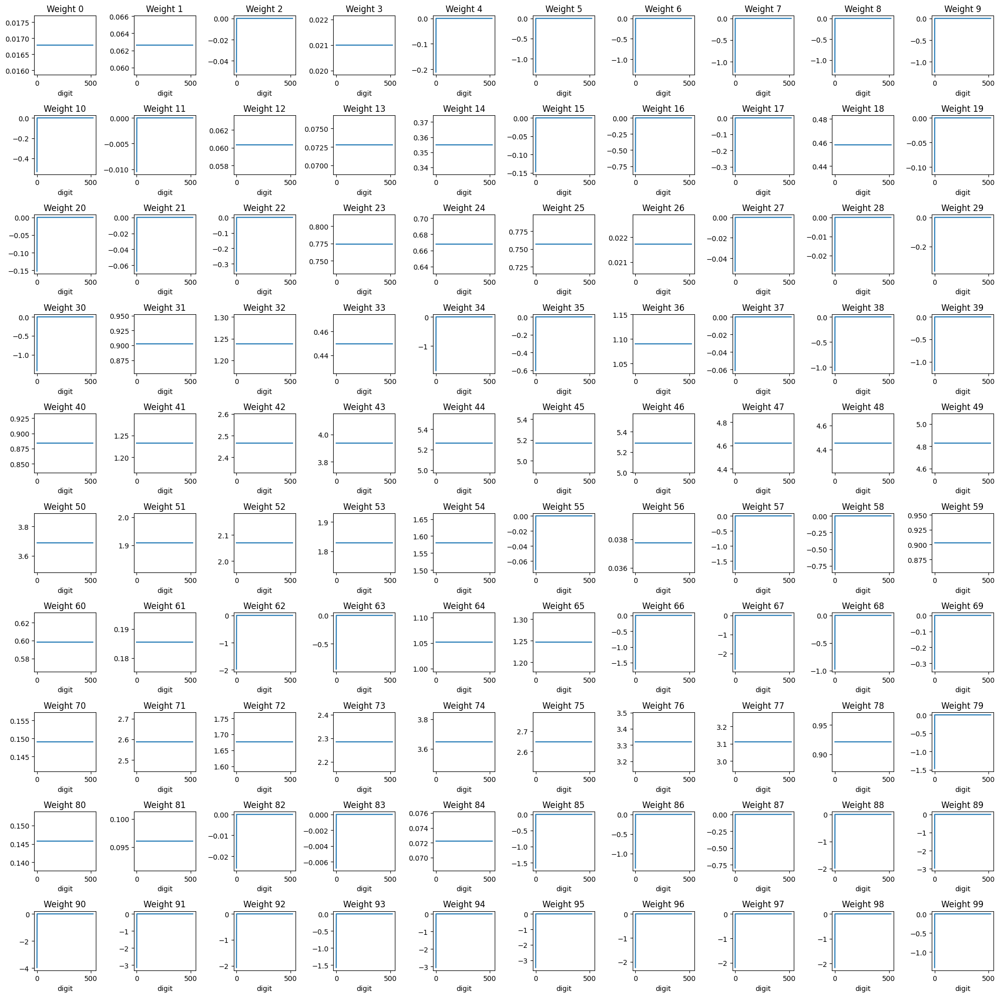

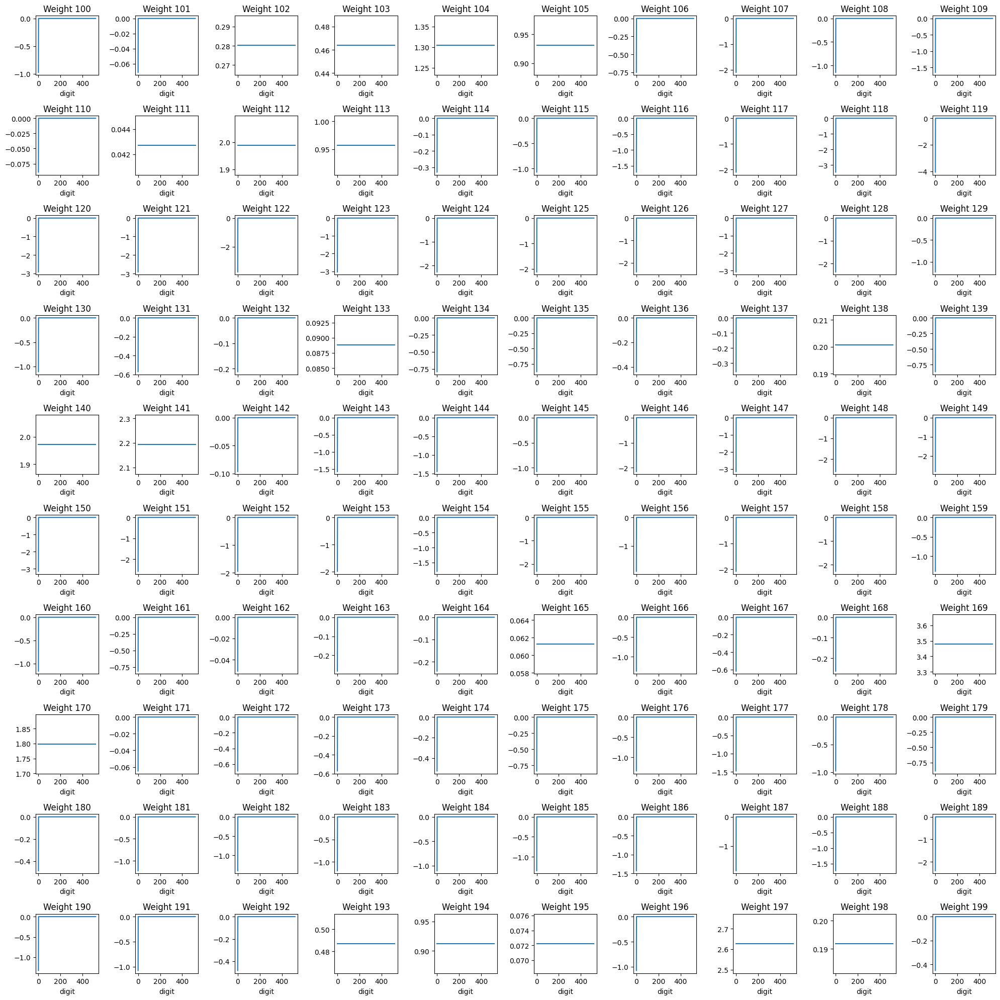

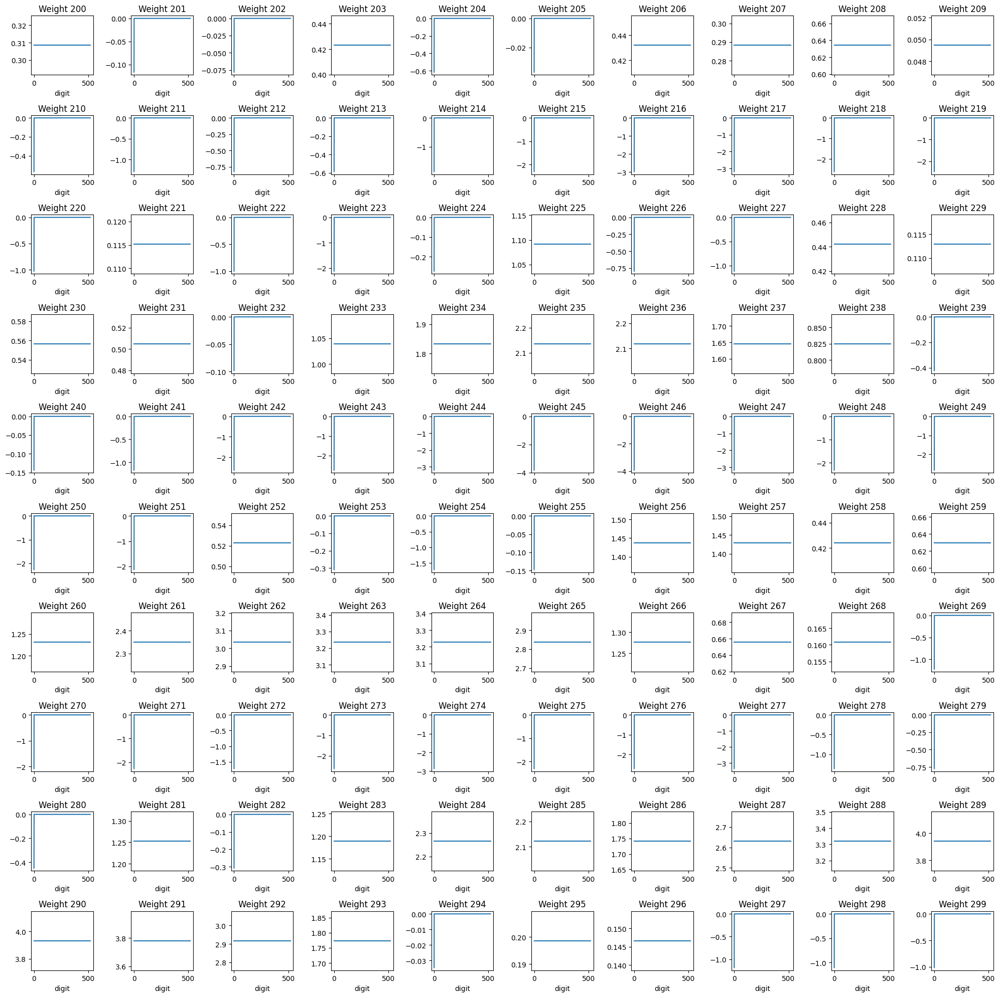

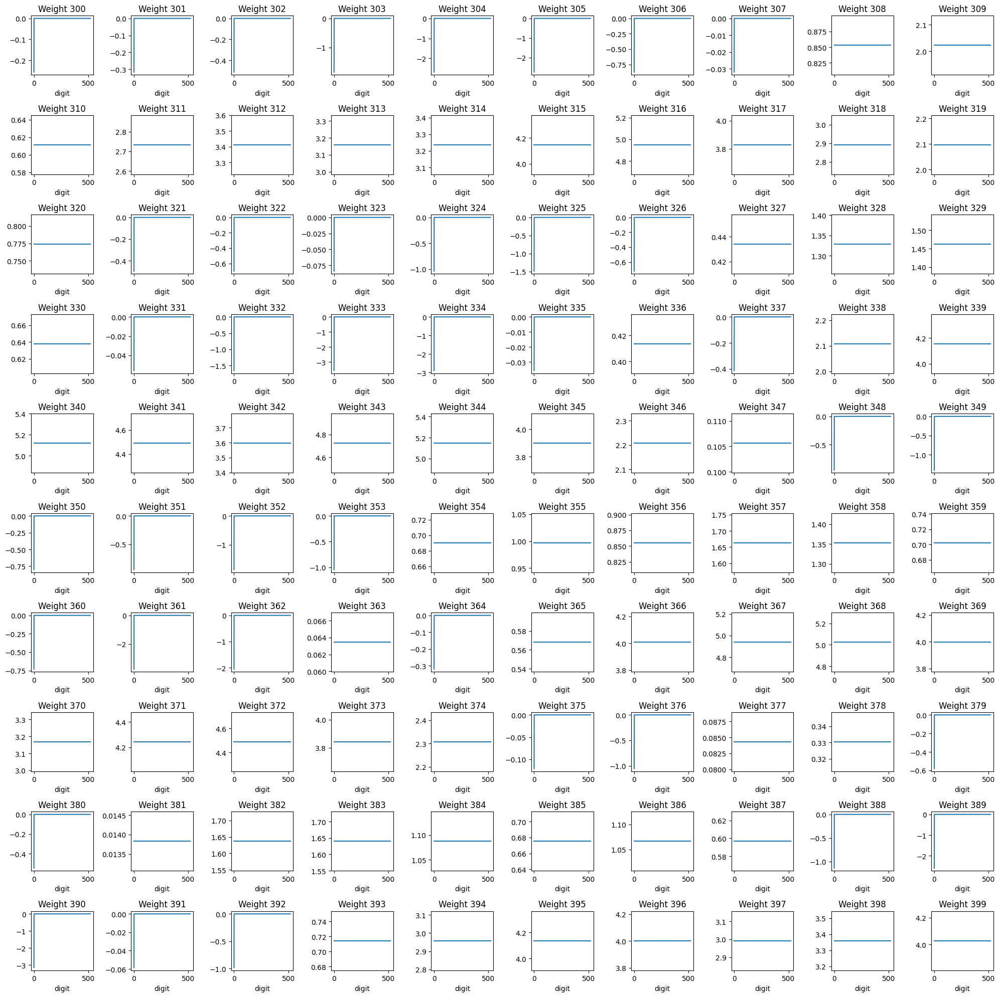

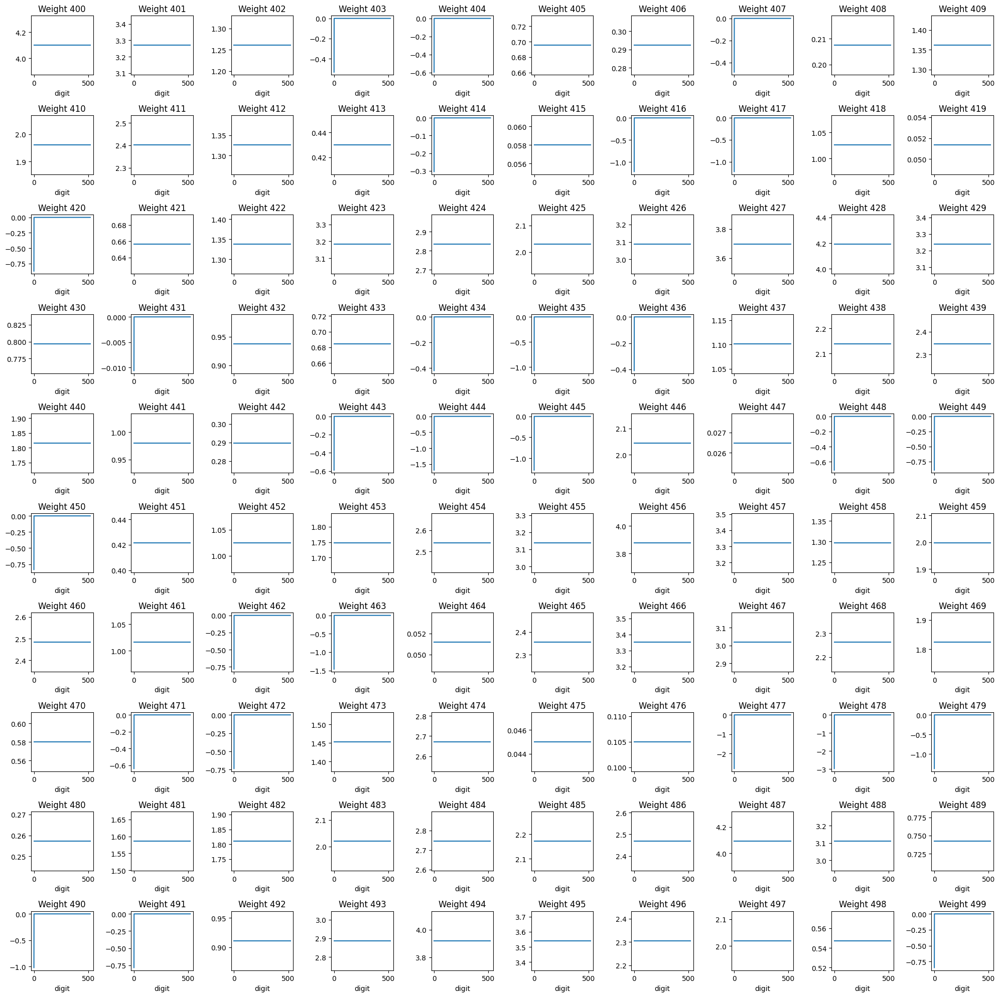

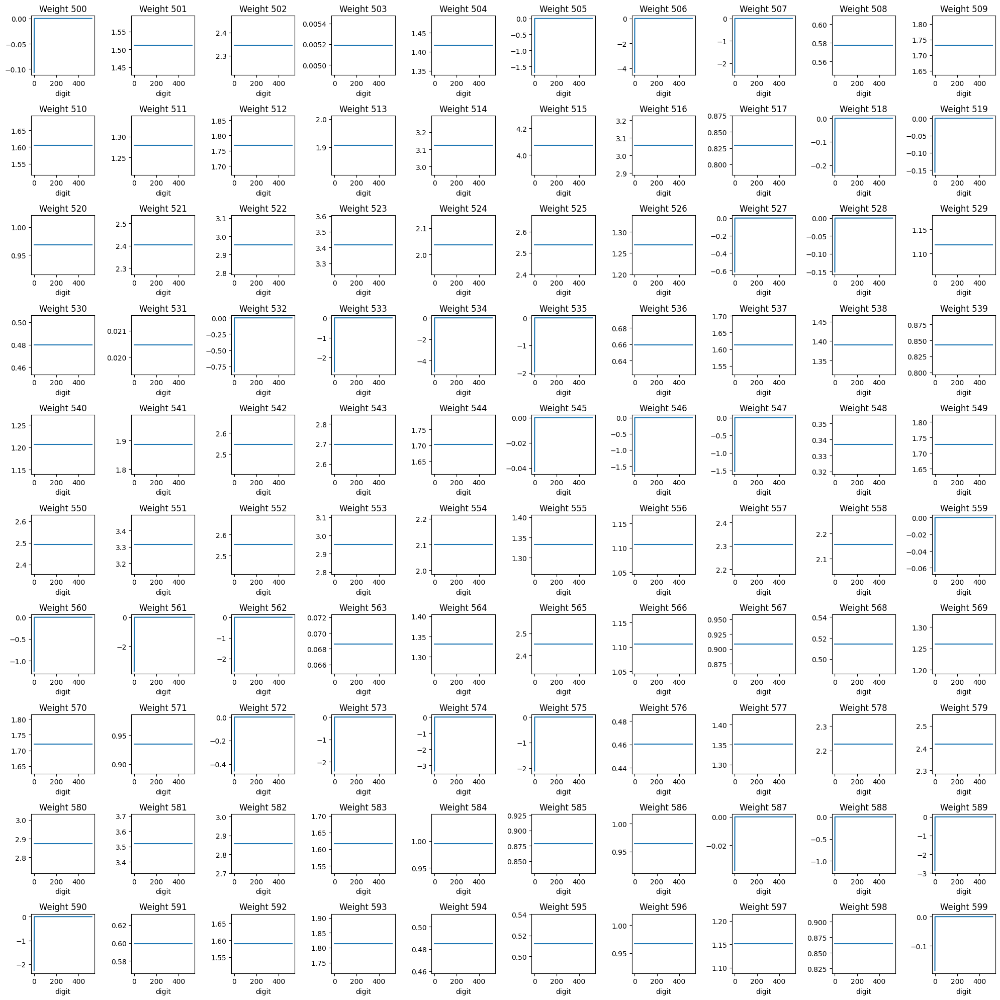

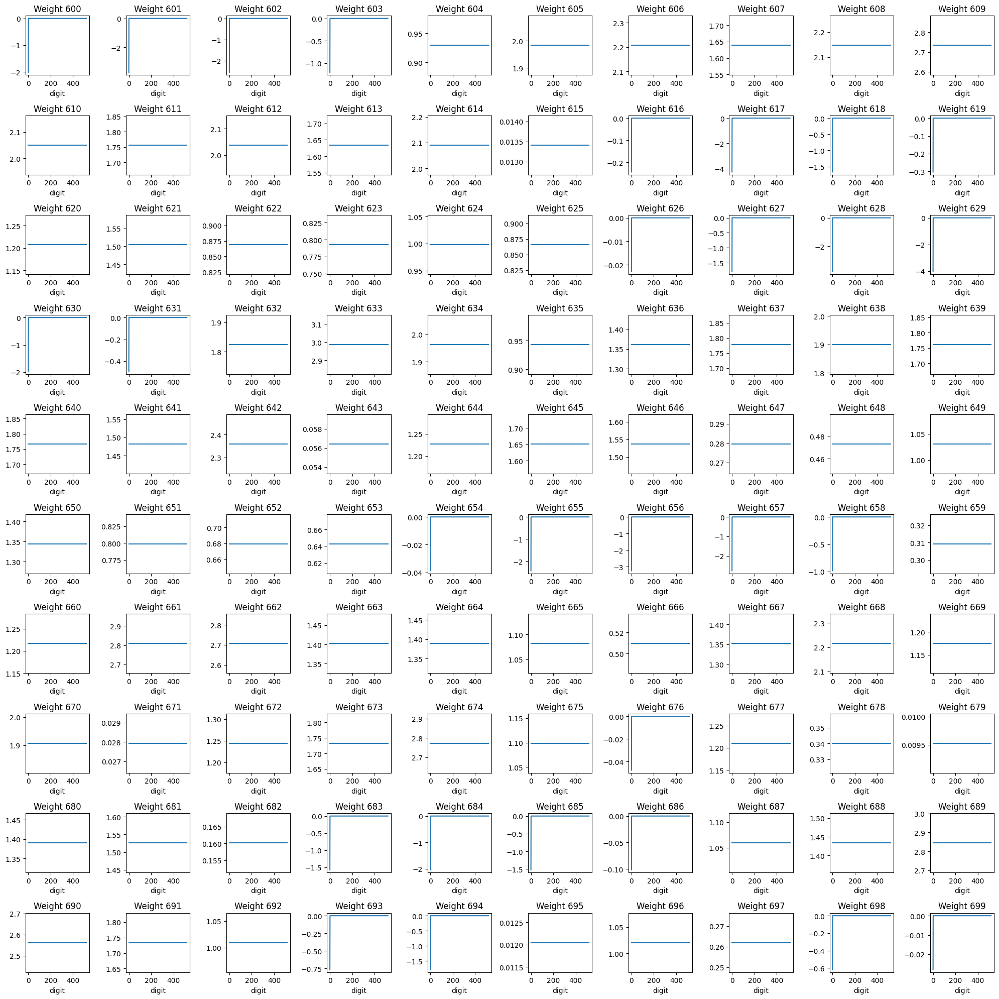

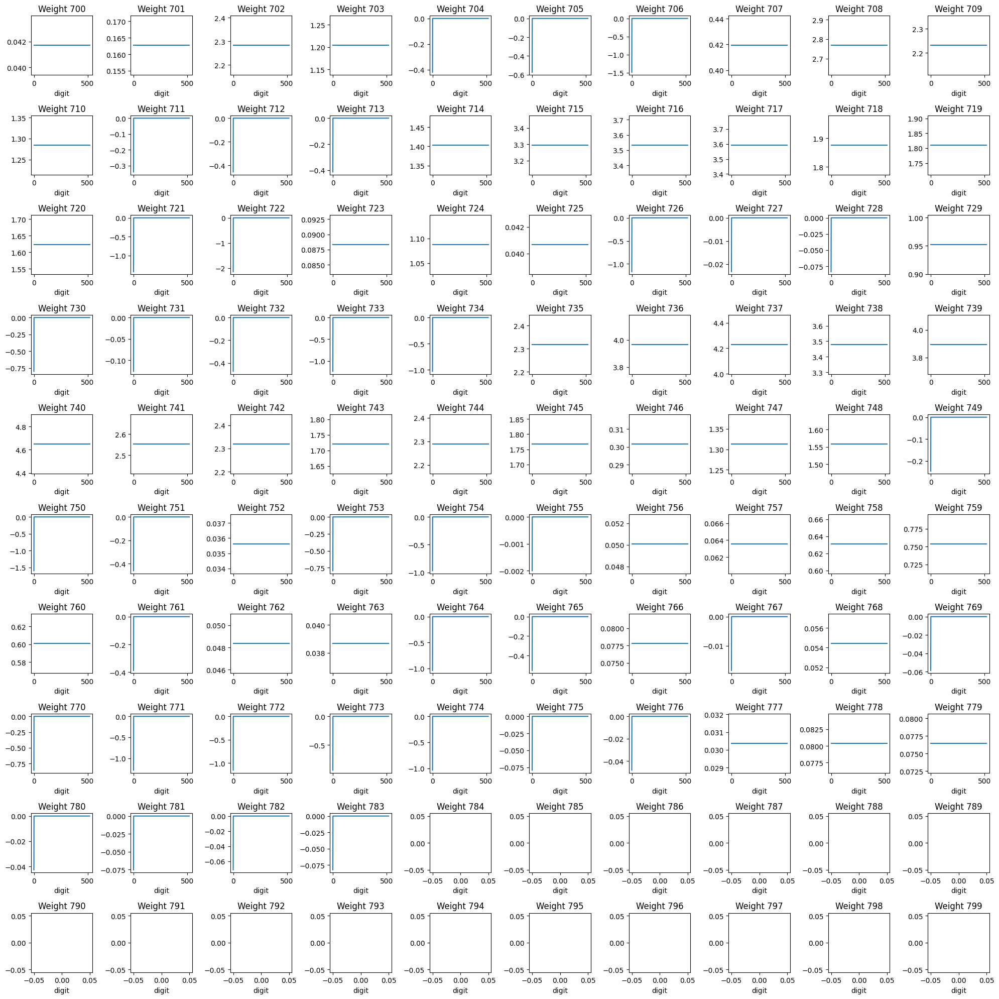

In [41]:
plot_neuron_weights(D1, r_neuron)
plot_neuron_weights(D1, r_neuron, pad=100)
plot_neuron_weights(D1, r_neuron, pad=200)
plot_neuron_weights(D1, r_neuron, pad=300)
plot_neuron_weights(D1, r_neuron, pad=400)
plot_neuron_weights(D1, r_neuron, pad=500)
plot_neuron_weights(D1, r_neuron, pad=600)
plot_neuron_weights(D1, r_neuron, pad=700)

- All the weights above 0 are kept, and the ones below zero are zeroed. 
    - One of the possible reasons is that negative weights would pull the output value down, thus not contibute to the final value - which goes through the ReLU function. Nevertheless, some more investigation should be taken w.r.t. understanding the role of the weight in the final module.
- The max and min operations seen in the code have no effect, since self.W1 never changes and D1 is set to self.W1 in first pass. Thus, all weights in self.W1 are equal to the weights in D1.

###### Analysis of the updated weights

In [42]:
post_ci_df_n6 = W1[W1.digit == str(519)][str(r_neuron)].rename('initial_weights').reset_index(drop=True).to_frame().reset_index(names='input_layer_neuron')
post_ci_df_n6['valid_initial_weights'] = post_ci_df_n6.initial_weights.map(lambda x: 0 if x <= 0 else 1)
post_ci_df_n6['updated_weights'] = D1[D1.digit == 519][str(r_neuron)].rename('updated_weights').reset_index(drop=True)
post_ci_df_n6['valid_updated_weights'] = post_ci_df_n6.updated_weights.map(lambda x: 0 if x == 0 else 1)

post_ci_df_n6

,input_layer_neuron,initial_weights,valid_initial_weights,updated_weights,valid_updated_weights
0,0,0.016780,1,0.016780,1
1,1,0.062608,1,0.062608,1
2,2,-0.050573,0,0.000000,0
3,3,0.020991,1,0.020991,1
4,4,-0.211404,0,0.000000,0
...,...,...,...,...,...
779,779,0.076473,1,0.076473,1
780,780,-0.042711,0,0.000000,0
781,781,-0.075414,0,0.000000,0
782,782,-0.071309,0,0.000000,0


In [43]:
print('All Negative or Zero weights were updated to zero?')
invalid_initial_weights = post_ci_df_n6[post_ci_df_n6.initial_weights <= 0]
display((invalid_initial_weights.valid_initial_weights == invalid_initial_weights.valid_updated_weights).value_counts())


valid_updated_weights = post_ci_df_n6[post_ci_df_n6.initial_weights > 0]
print('\nPositive weights before and after update:')
display((valid_updated_weights.valid_initial_weights == valid_updated_weights.valid_updated_weights).value_counts())

print('Values for positive weights before and after update are the same?')
display((valid_updated_weights.initial_weights == valid_updated_weights.updated_weights).value_counts())

All Negative or Zero weights were updated to zero?


True    347
Name: count, dtype: int64


Positive weights before and after update:


True    437
Name: count, dtype: int64

Values for positive weights before and after update are the same?


True    437
Name: count, dtype: int64

- The initial weights which were zero or negative were updated to zero.
- Weights above zero have the same values as the initial weights (were not updated)

<Axes: xlabel='updated_weights', ylabel='input_layer_neuron'>

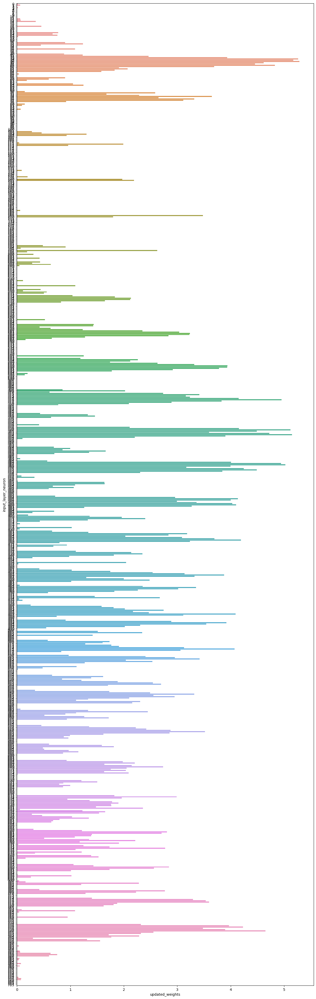

In [44]:
plt.figure(figsize=(15,50))
sns.barplot(x='updated_weights', y='input_layer_neuron', data=post_ci_df_n6, orient='h')

Text(0.5, 1.0, 'Weight Update')

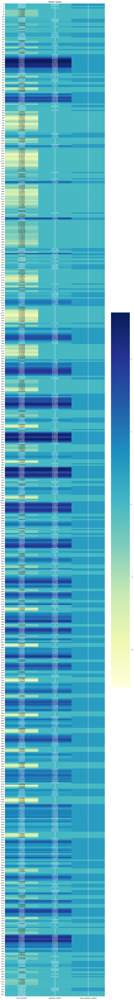

In [45]:
plt.figure(figsize=(15,120))
sns.heatmap(post_ci_df_n6[['initial_weights', 'updated_weights', 'valid_updated_weights']], annot=True, cmap='YlGnBu', fmt="g")
plt.title('Weight Update')

##### n36

In [46]:
r_neuron = 36

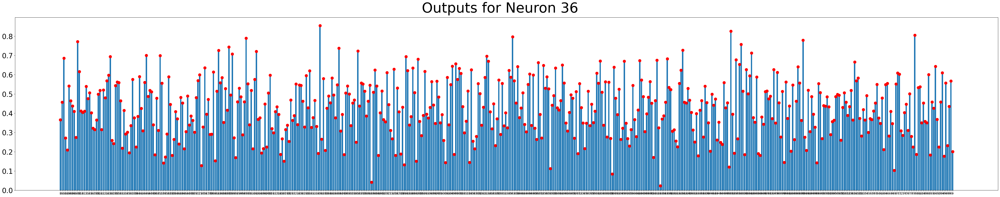

In [47]:
output_rn = X1[X1.neuron == r_neuron][['output', 'digit']].reset_index(drop=True)

fig, axes = plt.subplots(1, 1, figsize=(50, 10), sharex=True)

plt.bar(output_rn.digit, output_rn.output)
plt.scatter(output_rn.digit, output_rn.output, color='red', s=100)

axes.tick_params(axis='y', labelsize=25)

fig.suptitle(f"Outputs for Neuron {r_neuron}", fontsize=50)

# Display the plot
plt.tight_layout()
plt.show()

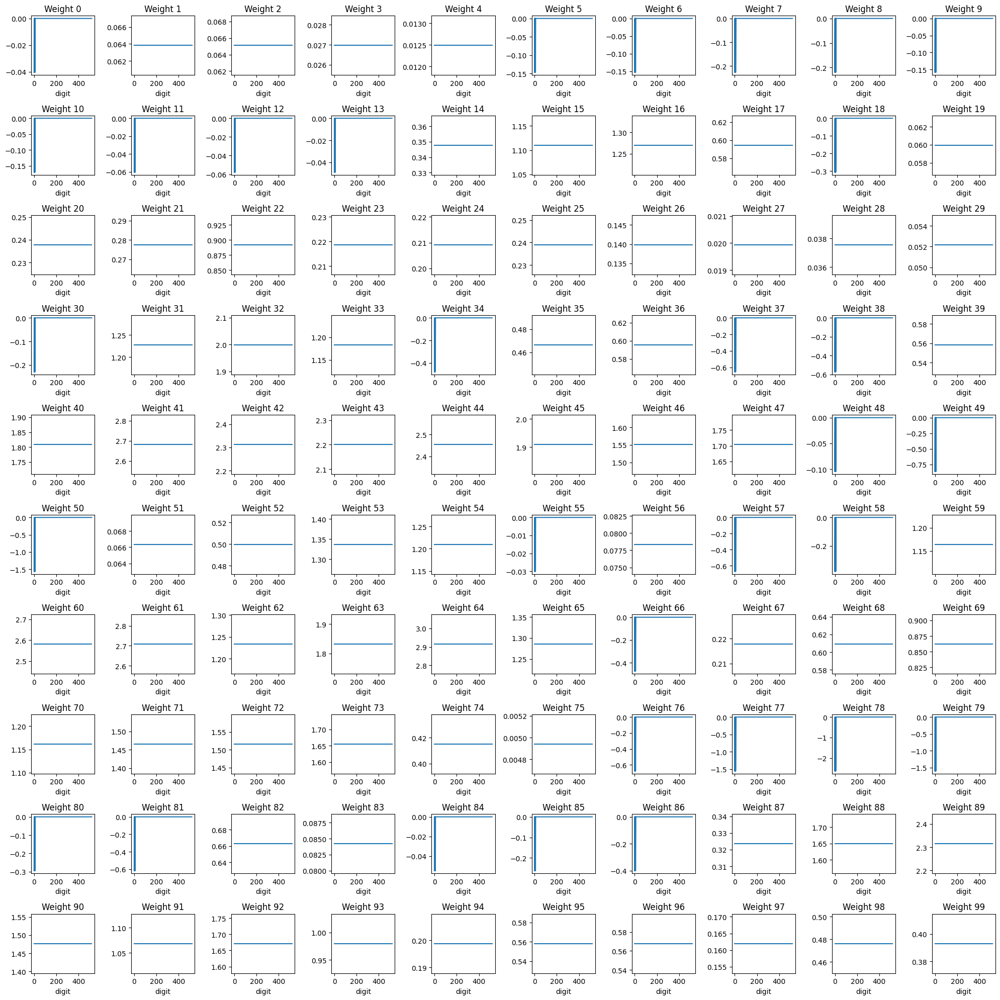

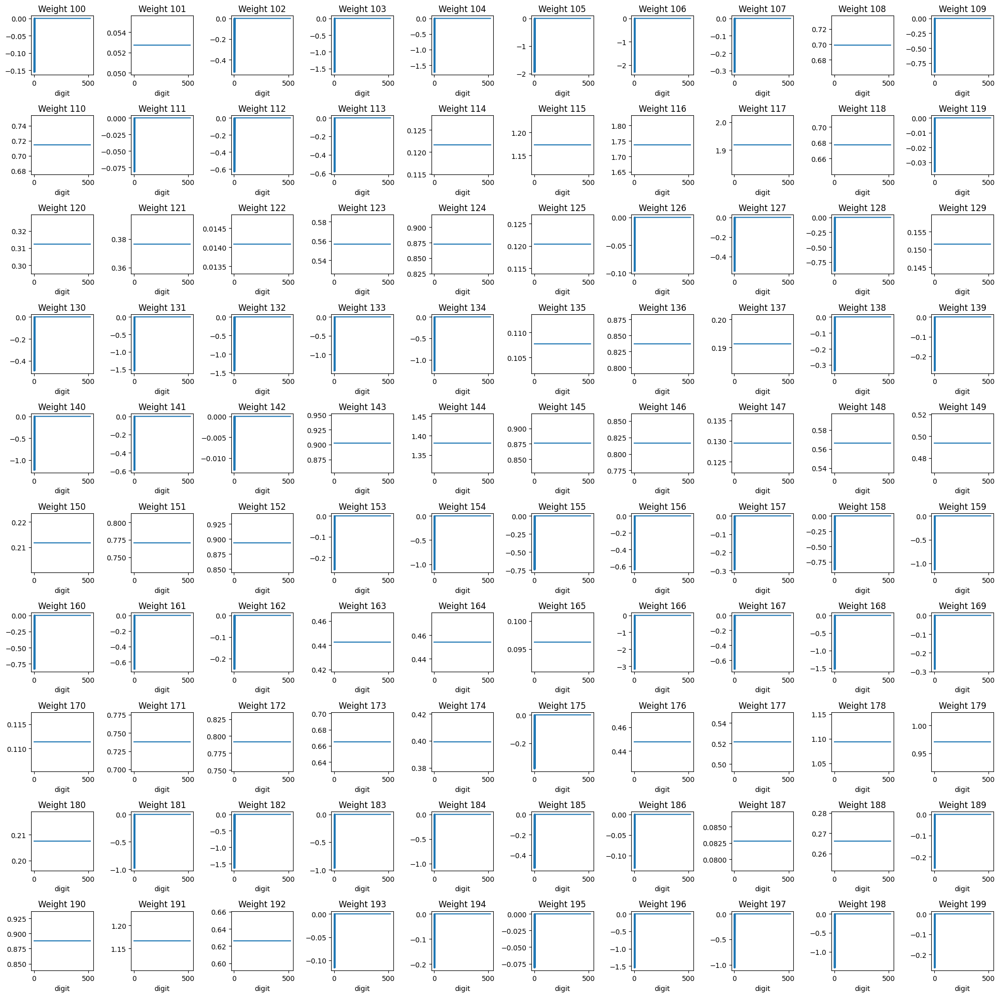

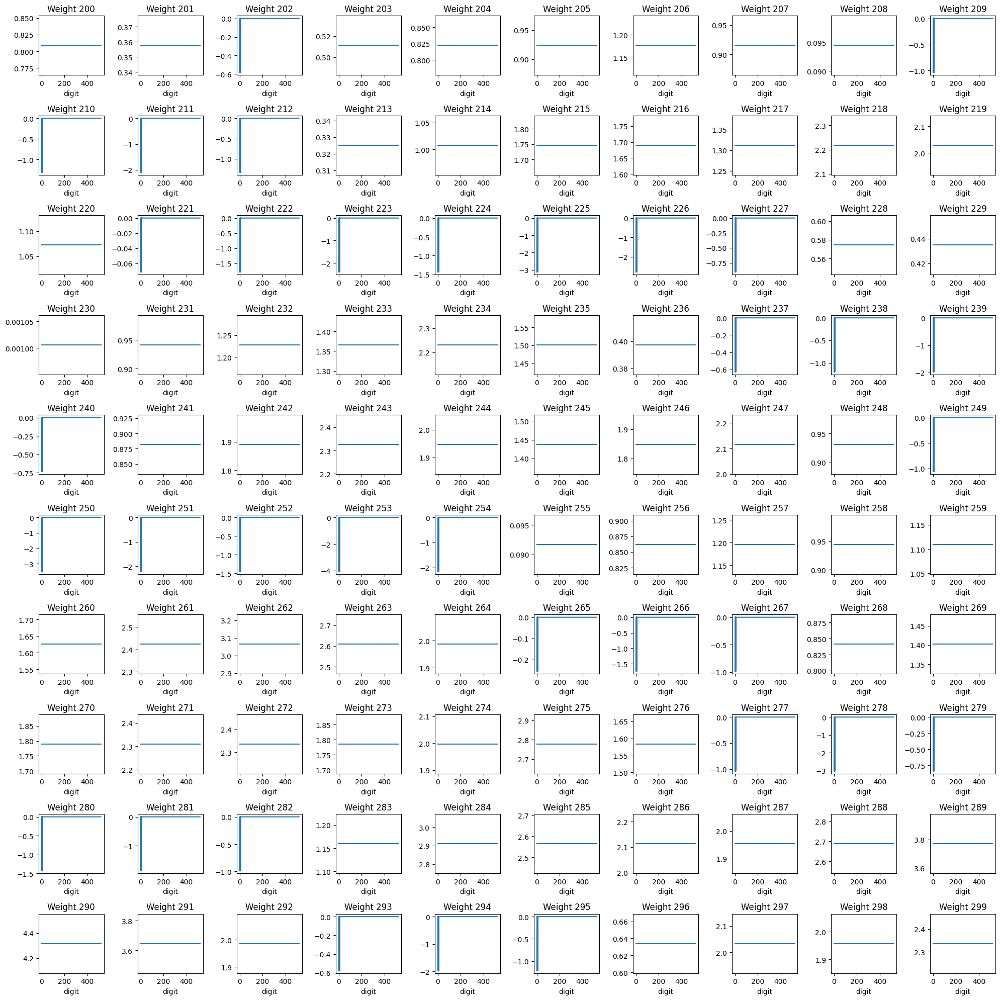

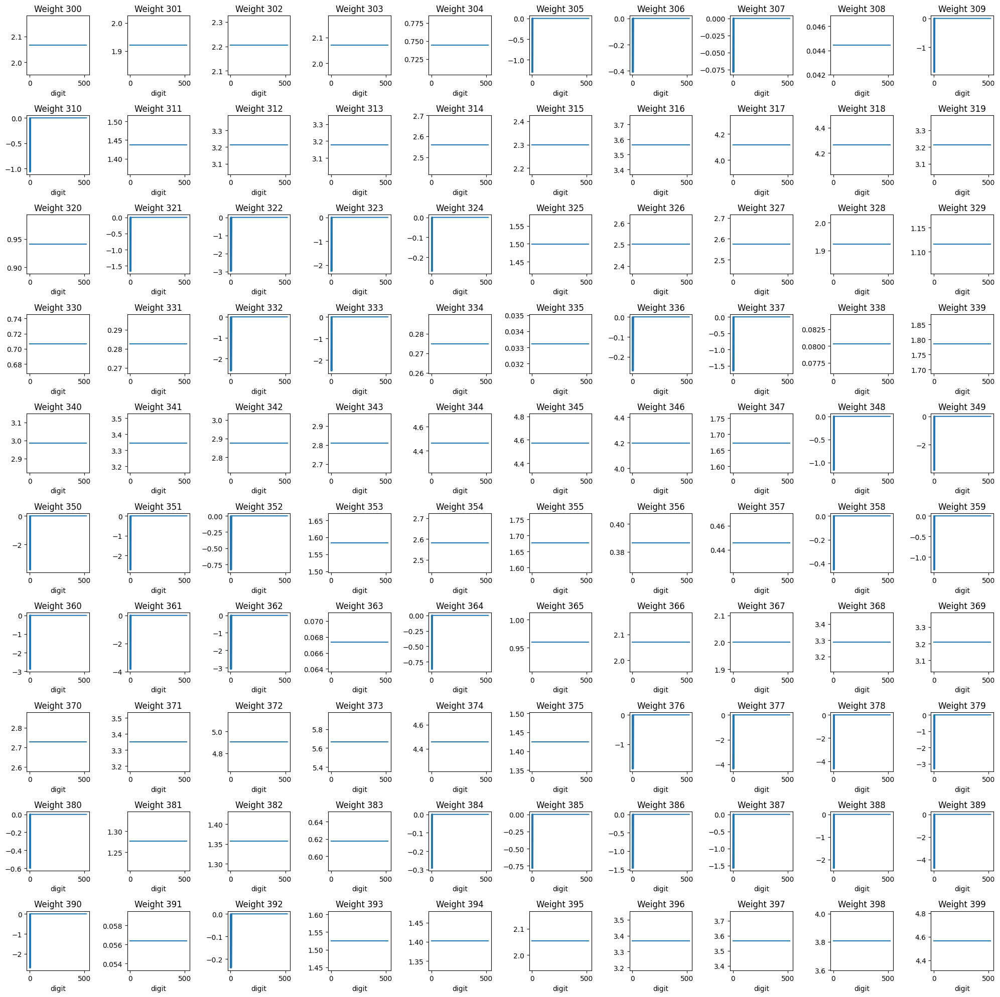

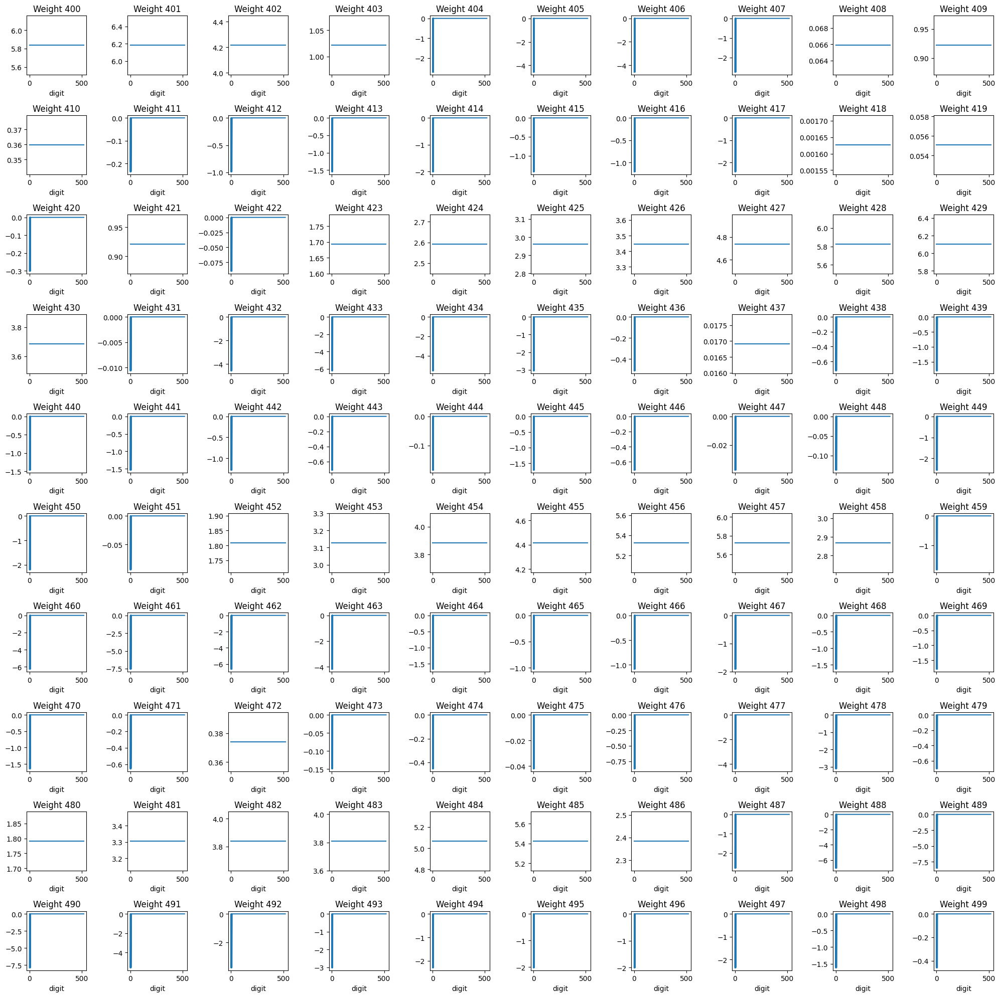

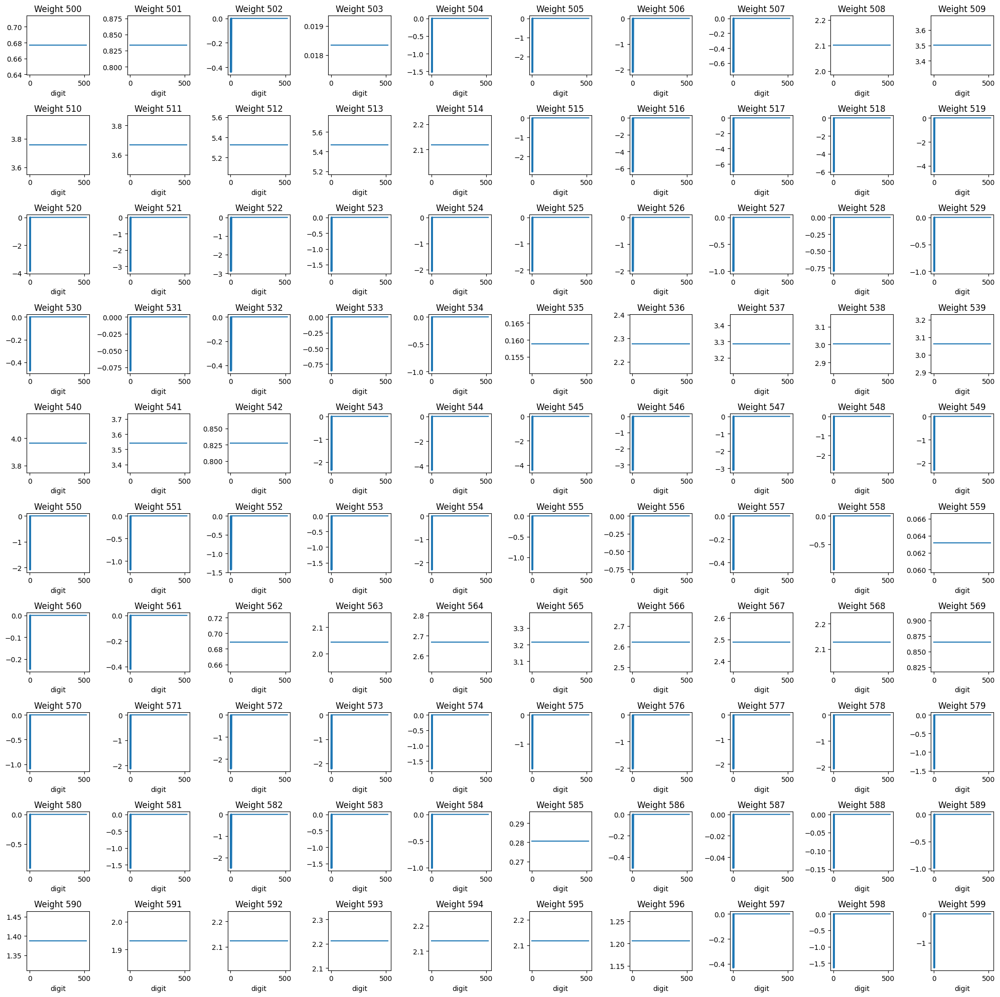

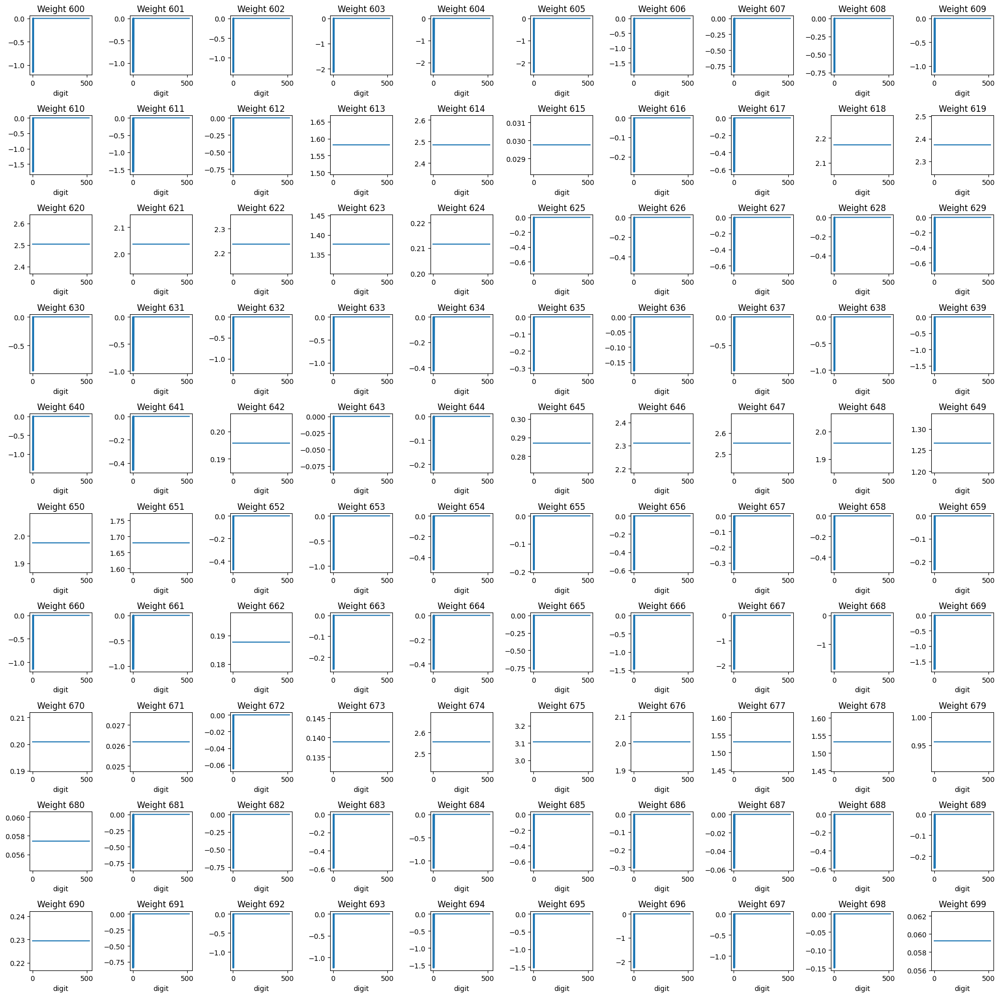

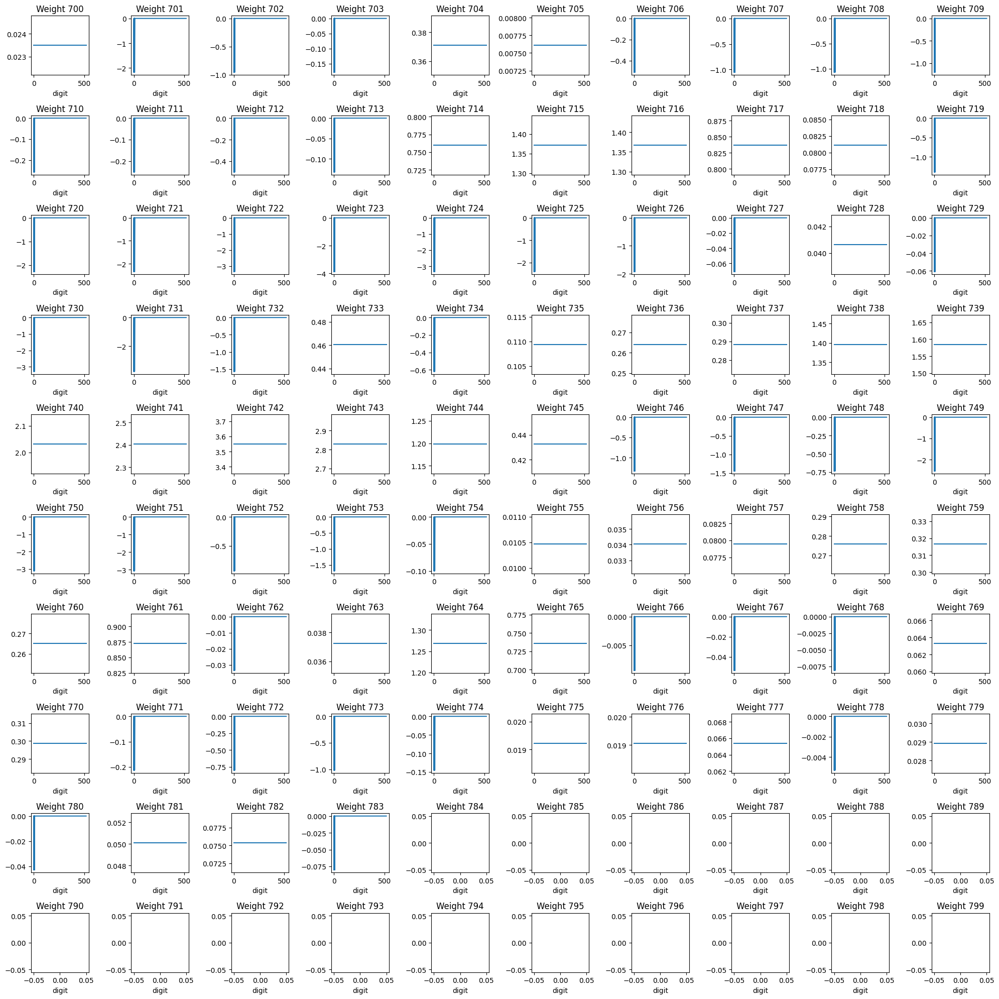

In [26]:
plot_neuron_weights(D1, r_neuron)
plot_neuron_weights(D1, r_neuron, pad=100)
plot_neuron_weights(D1, r_neuron, pad=200)
plot_neuron_weights(D1, r_neuron, pad=300)
plot_neuron_weights(D1, r_neuron, pad=400)
plot_neuron_weights(D1, r_neuron, pad=500)
plot_neuron_weights(D1, r_neuron, pad=600)
plot_neuron_weights(D1, r_neuron, pad=700)

###### Analysis of the updated weights

In [48]:
post_ci_df_n36 = W1[W1.digit == str(519)][str(r_neuron)].rename('initial_weights').reset_index(drop=True).to_frame().reset_index(names='input_layer_neuron')
post_ci_df_n36['valid_initial_weights'] = post_ci_df_n36.initial_weights.map(lambda x: 0 if x <= 0 else 1)
post_ci_df_n36['updated_weights'] = D1[D1.digit == 519][str(r_neuron)].rename('updated_weights').reset_index(drop=True)
post_ci_df_n36['valid_updated_weights'] = post_ci_df_n36.updated_weights.map(lambda x: 0 if x == 0 else 1)

post_ci_df_n36

,input_layer_neuron,initial_weights,valid_initial_weights,updated_weights,valid_updated_weights
0,0,-0.040352,0,0.000000,0
1,1,0.063832,1,0.063832,1
2,2,0.065109,1,0.065109,1
3,3,0.026972,1,0.026972,1
4,4,0.012486,1,0.012486,1
...,...,...,...,...,...
779,779,0.028930,1,0.028930,1
780,780,-0.042889,0,0.000000,0
781,781,0.050094,1,0.050094,1
782,782,0.075355,1,0.075355,1


In [49]:
print('All Negative or Zero weights were updated to zero?')
invalid_initial_weights = post_ci_df_n36[post_ci_df_n36.initial_weights <= 0]
display((invalid_initial_weights.valid_initial_weights == invalid_initial_weights.valid_updated_weights).value_counts())


valid_updated_weights = post_ci_df_n36[post_ci_df_n36.initial_weights > 0]
print('\nPositive weights before and after update:')
display((valid_updated_weights.valid_initial_weights == valid_updated_weights.valid_updated_weights).value_counts())

print('Values for positive weights before and after update are the same?')
display((valid_updated_weights.initial_weights == valid_updated_weights.updated_weights).value_counts())

All Negative or Zero weights were updated to zero?


True    401
Name: count, dtype: int64


Positive weights before and after update:


True    383
Name: count, dtype: int64

Values for positive weights before and after update are the same?


True    383
Name: count, dtype: int64

- The initial weights which were zero or negative were updated to zero.
- Weights above zero have the same values as the initial weights (were not updated)

<Axes: xlabel='updated_weights', ylabel='input_layer_neuron'>

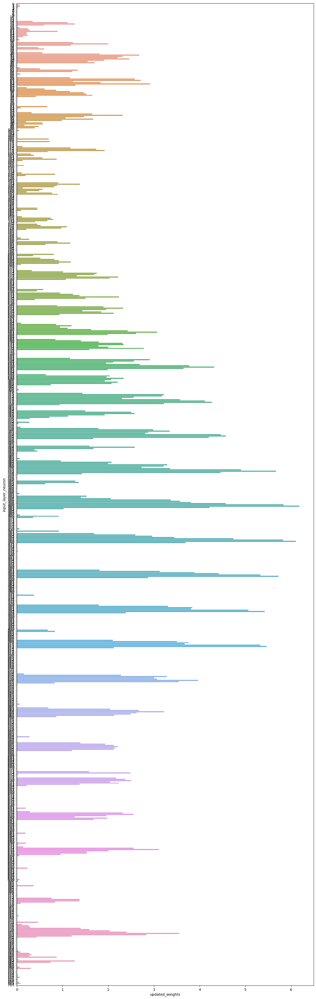

In [50]:
plt.figure(figsize=(15,50))
sns.barplot(x='updated_weights', y='input_layer_neuron', data=post_ci_df_n36, orient='h')

Text(0.5, 1.0, 'Weight Update')

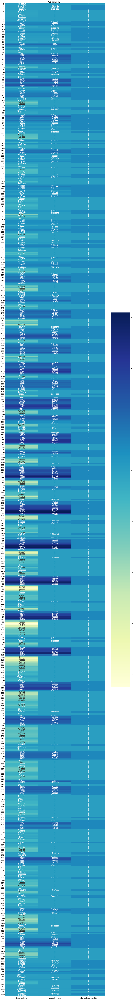

In [51]:
plt.figure(figsize=(15,120))
sns.heatmap(post_ci_df_n36[['initial_weights', 'updated_weights', 'valid_updated_weights']], annot=True, cmap='YlGnBu', fmt="g")
plt.title('Weight Update')

#### Nonactivated Neuron

In [52]:
na_neuron = 14

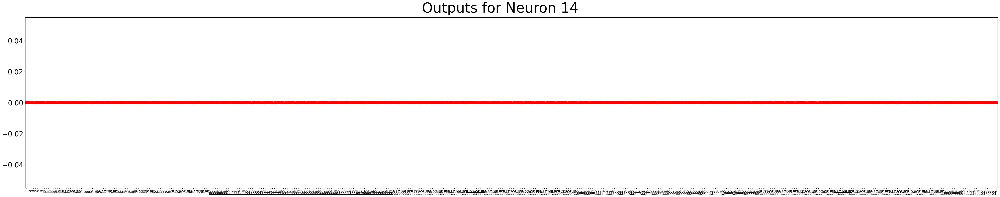

In [32]:
output_na = X1[X1.neuron == na_neuron].output.reset_index(drop=True)

fig, axes = plt.subplots(1, 1, figsize=(50, 10), sharex=True)

# output_rn.plot(ax=axes, color='red')
output_na.plot(kind='bar', ax=axes)
plt.scatter(output_na.index, output_na.values, color='red', s=100)

axes.tick_params(axis='y', labelsize=25)

fig.suptitle(f"Outputs for Neuron {na_neuron}", fontsize=50)

# Display the plot
plt.tight_layout()
plt.show()

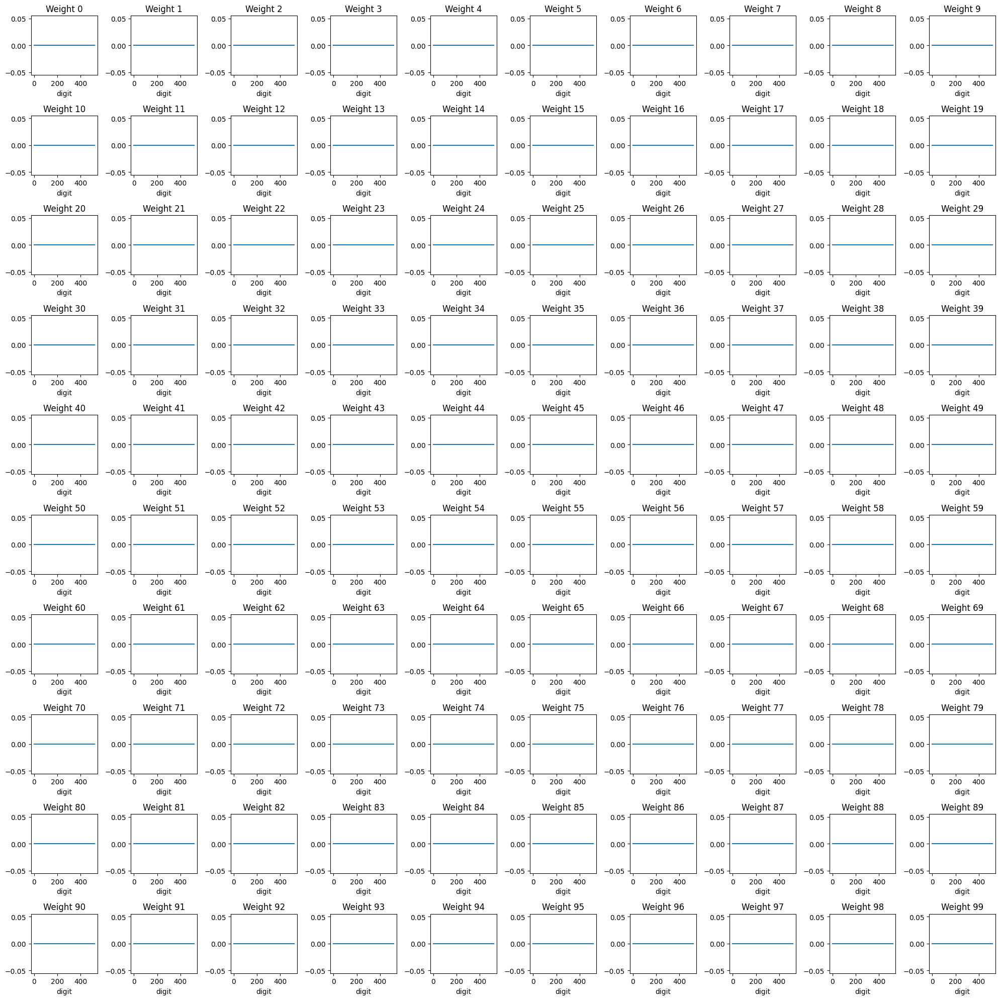

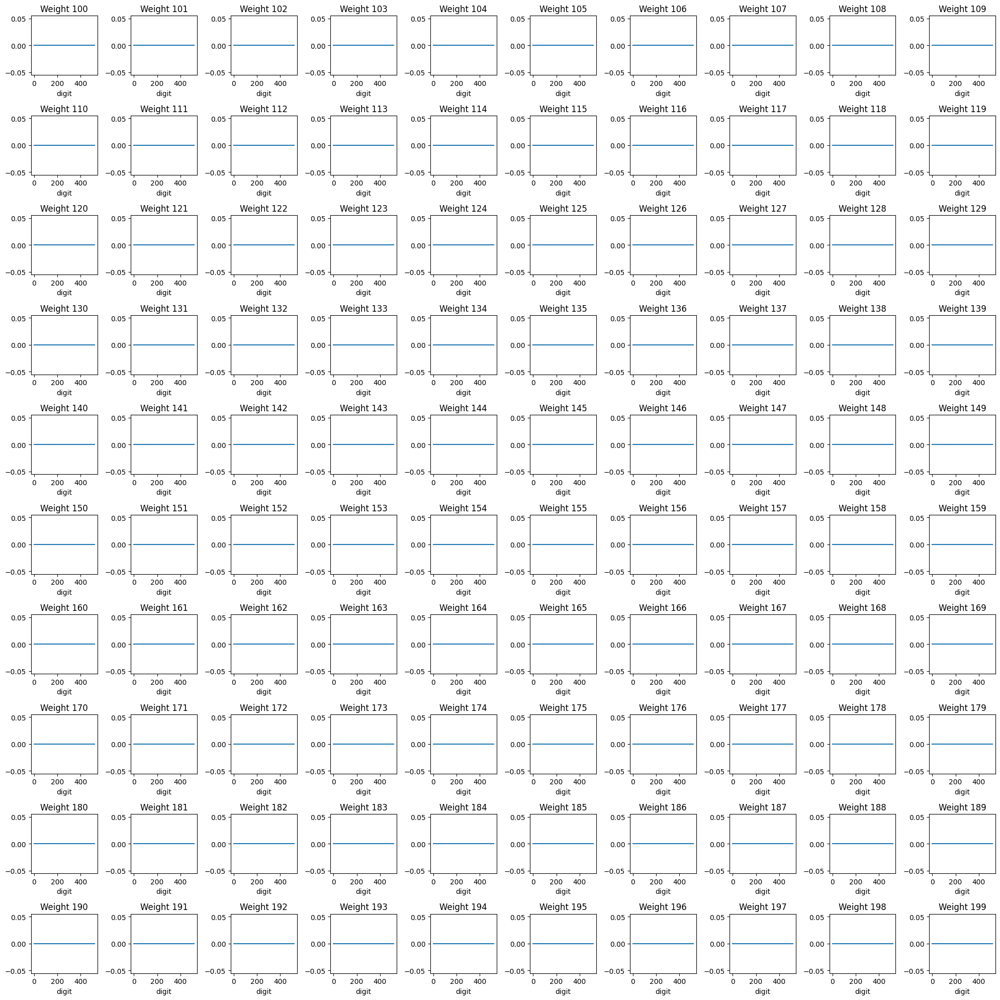

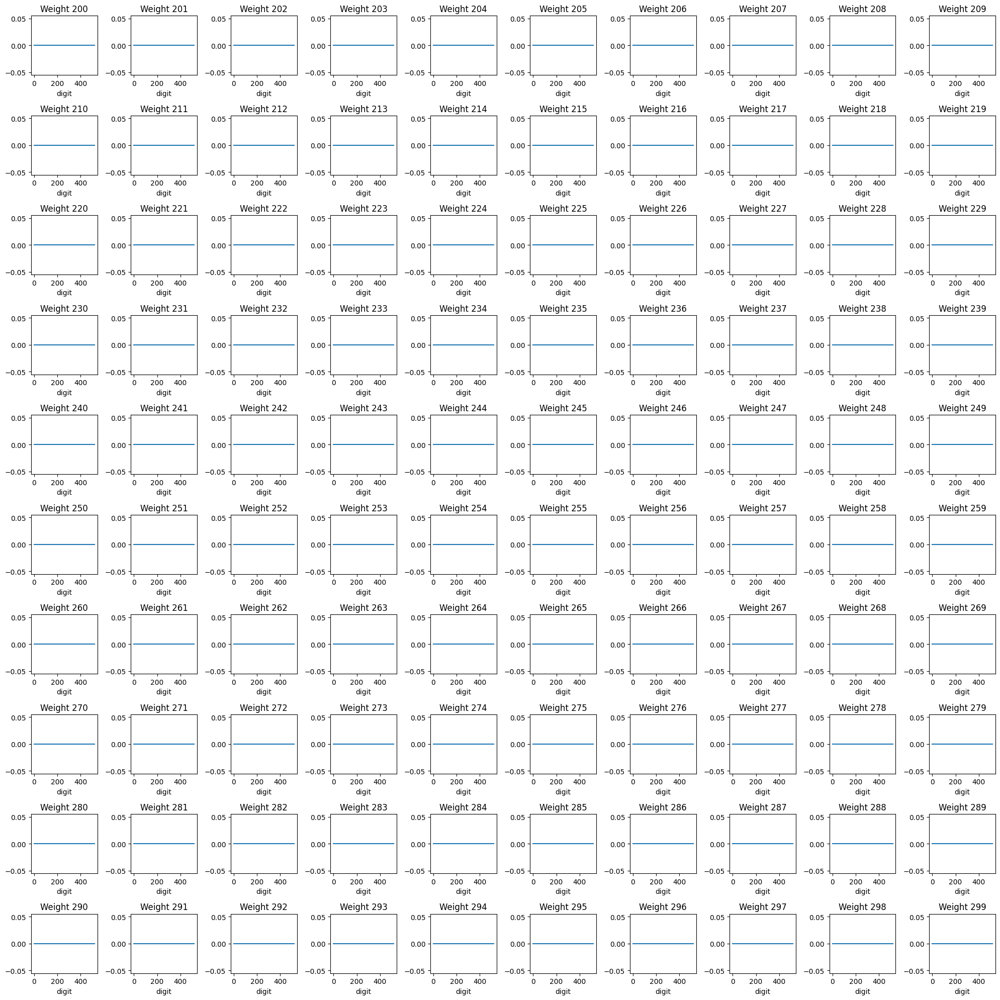

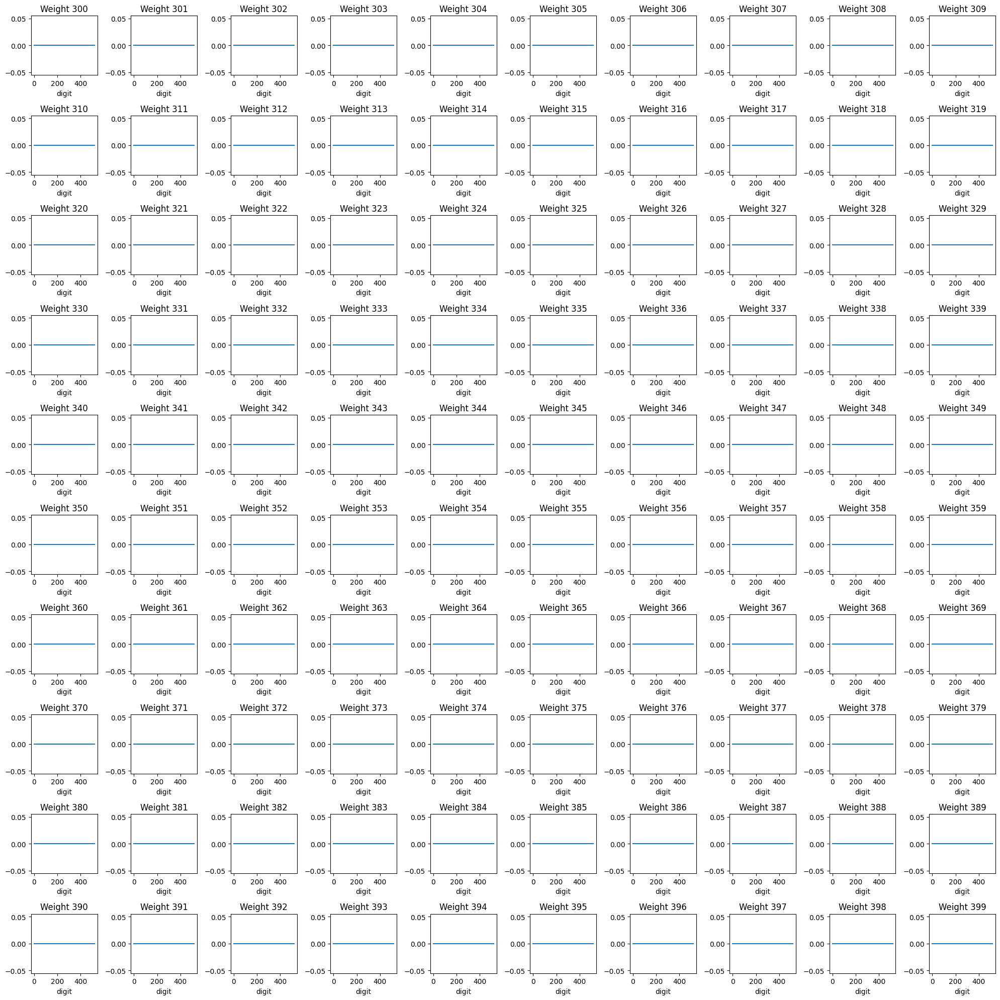

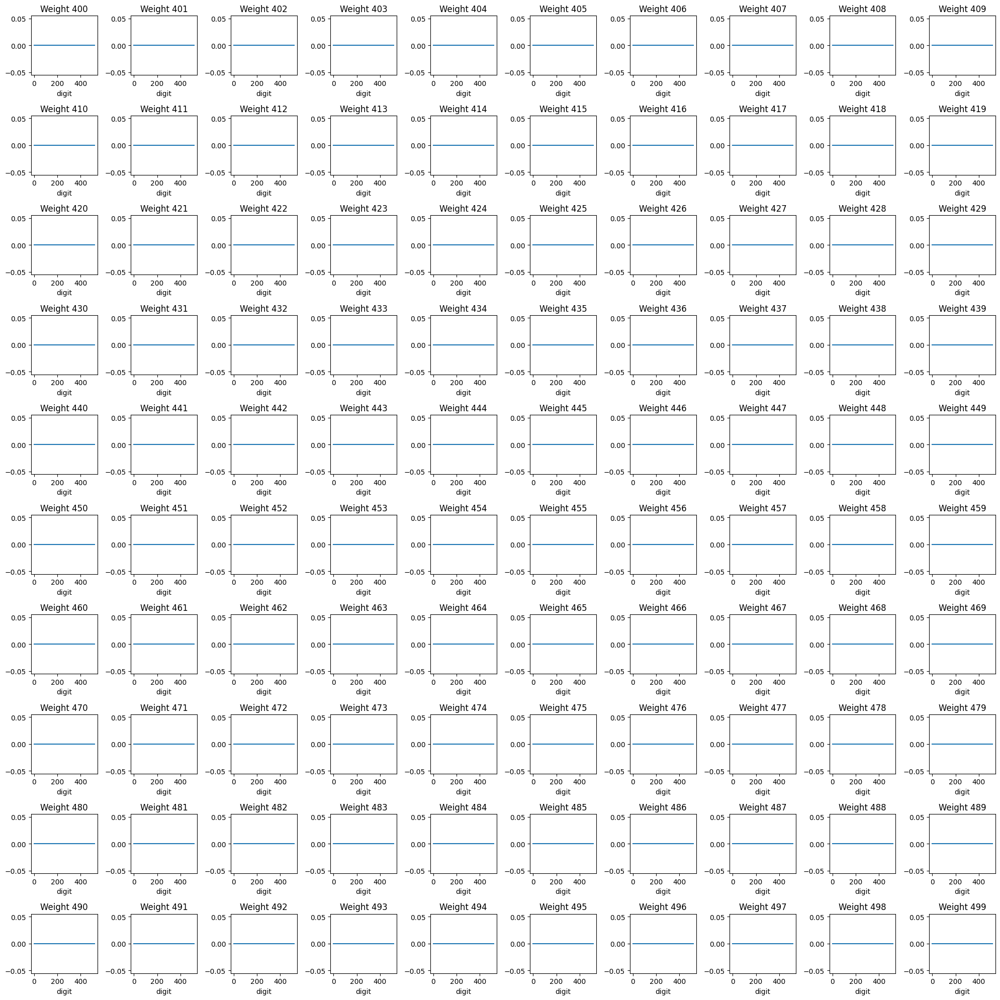

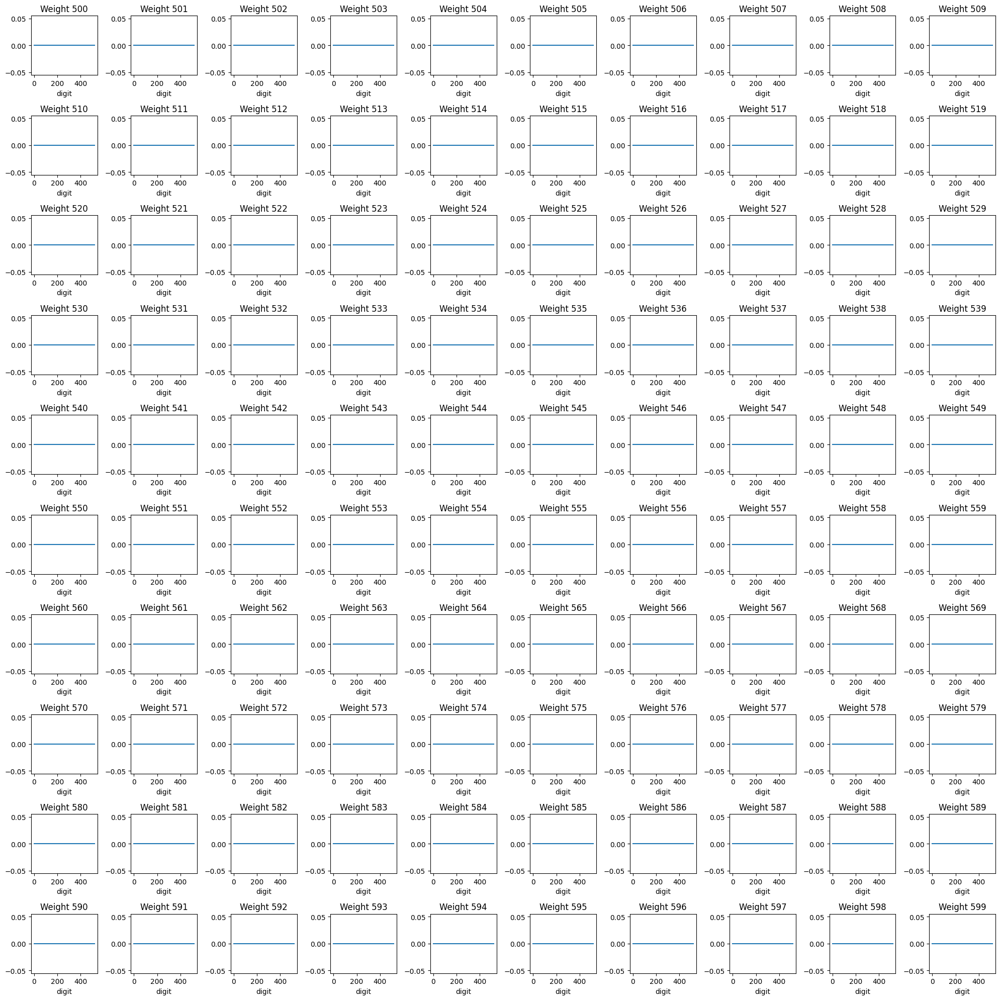

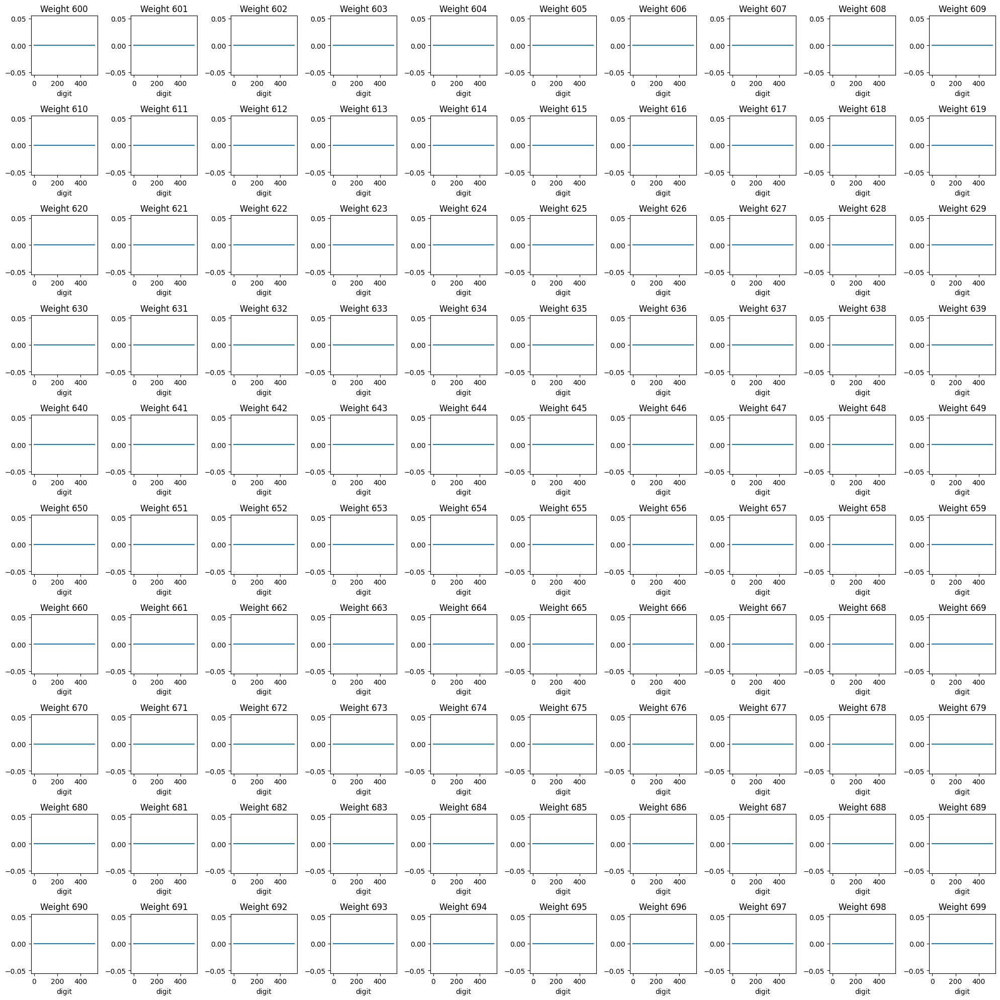

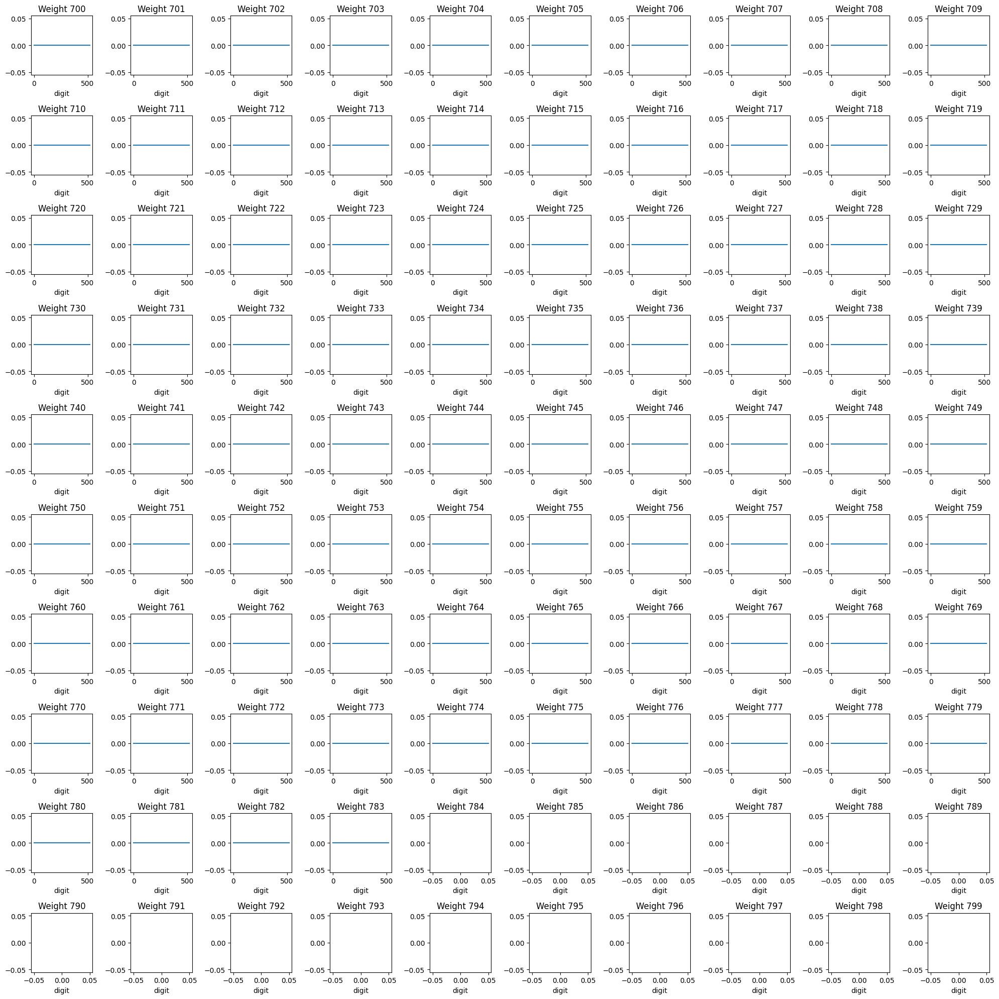

In [33]:
plot_neuron_weights(D1, na_neuron)
plot_neuron_weights(D1, na_neuron, pad=100)
plot_neuron_weights(D1, na_neuron, pad=200)
plot_neuron_weights(D1, na_neuron, pad=300)
plot_neuron_weights(D1, na_neuron, pad=400)
plot_neuron_weights(D1, na_neuron, pad=500)
plot_neuron_weights(D1, na_neuron, pad=600)
plot_neuron_weights(D1, na_neuron, pad=700)

All of the weights of this neuron are zero, which seems really weird. Below, I'll check if the original weights of the model are also zero. 

In [74]:
W1,b1 = model.layers[1].get_weights()
W2,b2 = model.layers[2].get_weights()
W1 = pd.DataFrame(W1).reset_index(names=['neuron'])

In [75]:
W1[na_neuron]

0      0.047469
1     -0.069550
2      0.060892
3      0.040558
4     -0.045248
         ...   
779   -0.074980
780    0.012592
781   -0.055211
782   -0.073279
783   -0.023481
Name: 14, Length: 784, dtype: float32

In [76]:
D1[str(na_neuron)]

0         0.0
1         0.0
2         0.0
3         0.0
4         0.0
         ... 
365339    0.0
365340    0.0
365341    0.0
365342    0.0
365343    0.0
Name: 14, Length: 407680, dtype: float64

Initially, the updated weights are set to zero and change if the first output is not zero.

By looking at the code, if the output of the neuron is zero, then the updated weights (D) and biases are set to zero. Since the first output and all the other ones are zero, the resulting weights are also zero.
- This is a clear indicator that these nodes should be removed from the modules.

#### Neurons with Outputs that hit zero

In [37]:
hz_neuron = 39

In [38]:
X1[X1.neuron == hz_neuron]

,neuron,digit,output
39,39,0,0.573472
88,39,0,0.445174
137,39,100,0.342677
186,39,101,0.330182
235,39,102,0.464420
...,...,...,...
25715,39,96,0.225522
25764,39,97,0.351482
25813,39,98,0.437525
25862,39,99,0.295446


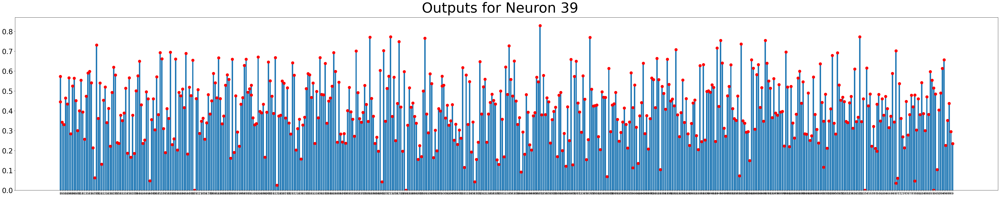

In [39]:
output_hz = X1[X1.neuron == hz_neuron][['output', 'digit']].reset_index(drop=True)

fig, axes = plt.subplots(1, 1, figsize=(50, 10), sharex=True)

# output_rn.plot(ax=axes, color='red')
# output_hz.plot(kind='bar', ax=axes)
plt.bar(output_hz.digit, output_hz.output)
plt.scatter(output_hz.digit, output_hz.output, color='red', s=100)

axes.tick_params(axis='y', labelsize=25)

fig.suptitle(f"Outputs for Neuron {hz_neuron}", fontsize=50)

# Display the plot
plt.tight_layout()
plt.show()

First zero is hit on example #53. Below, we see that after that the positive weights are all set to zero.

This is somewhat strange since it is a very active neuron.

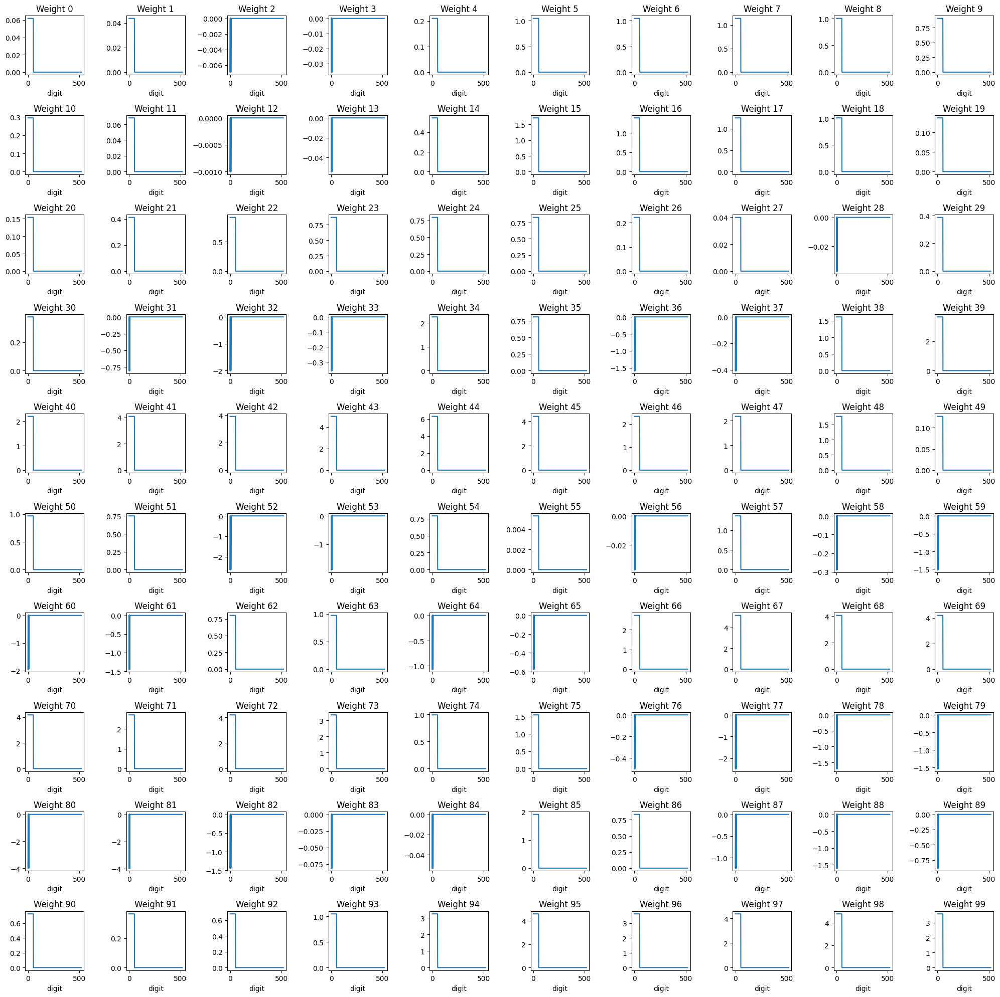

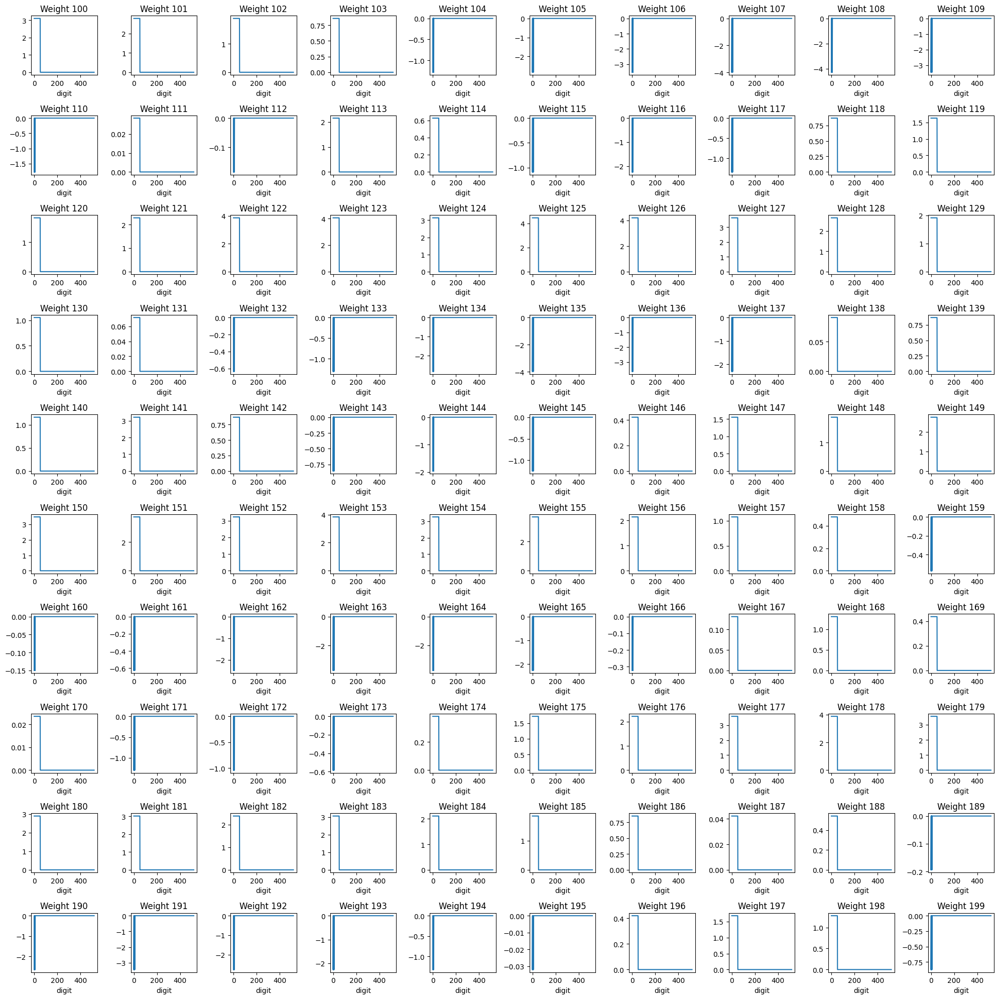

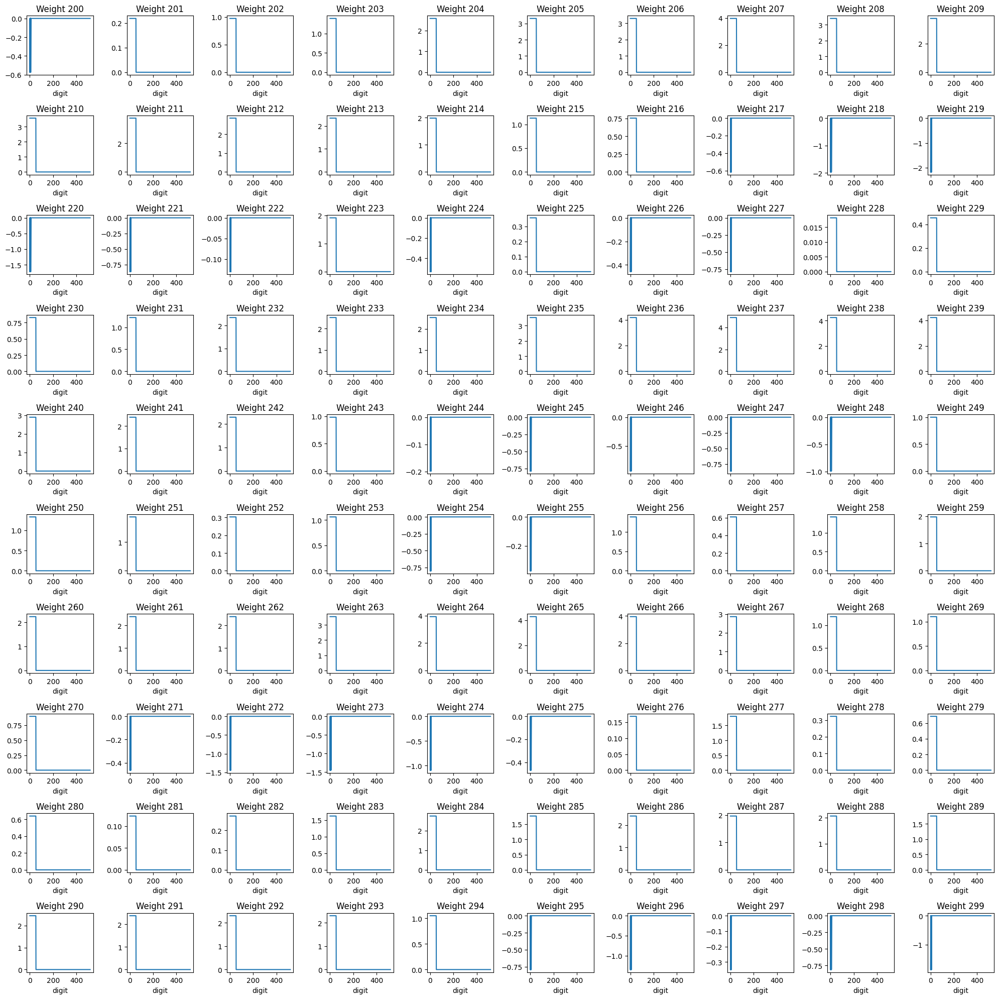

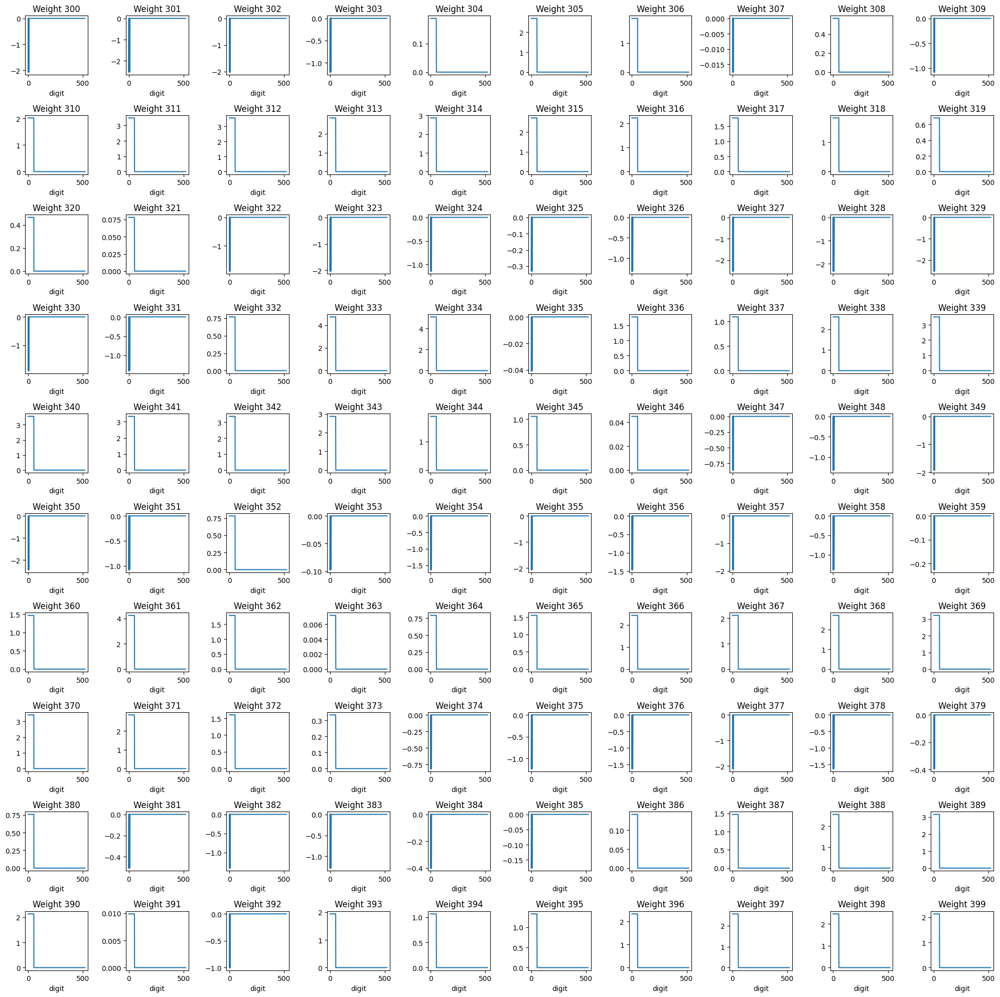

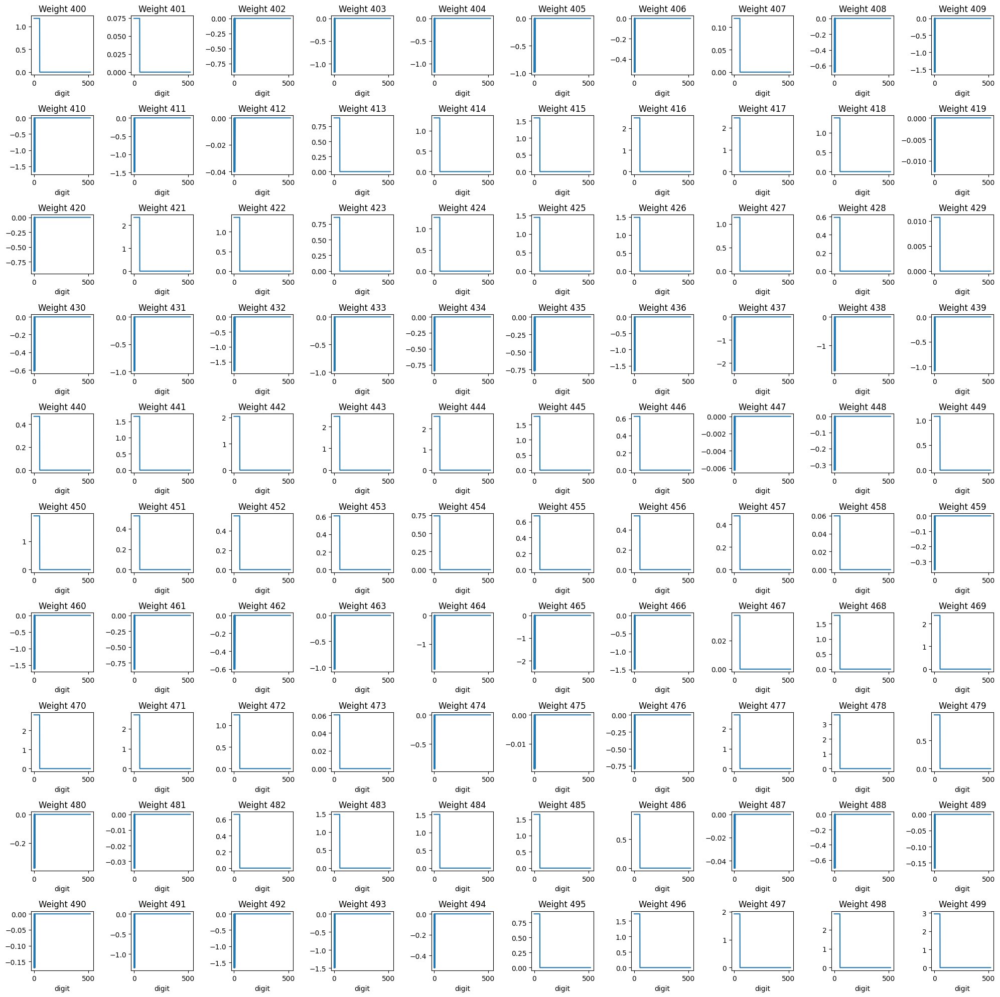

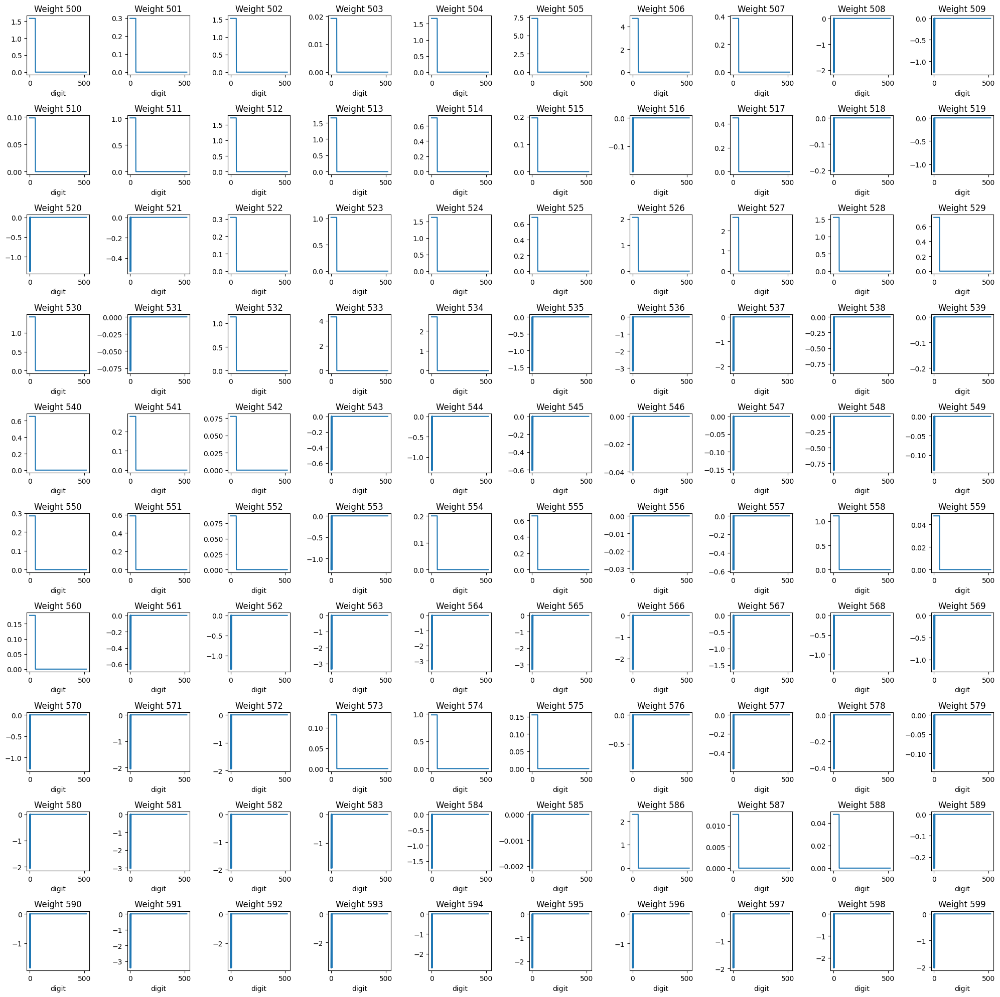

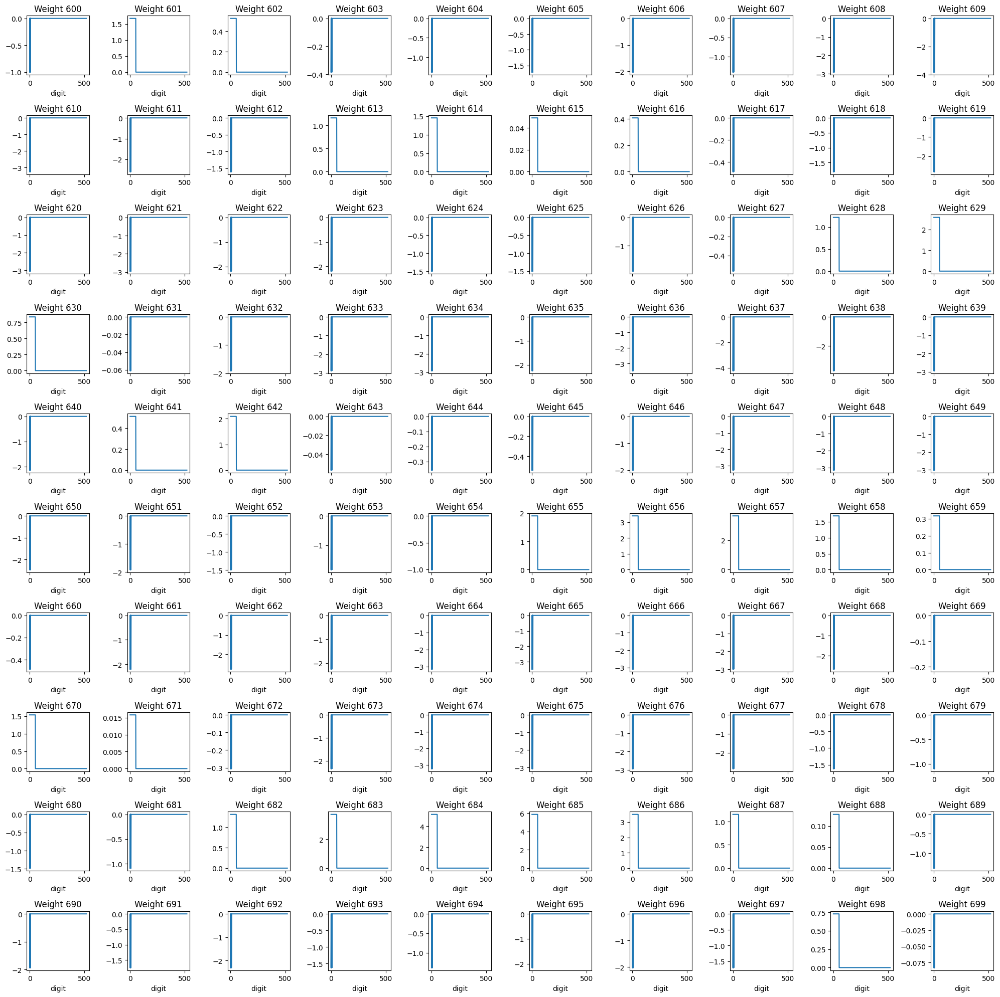

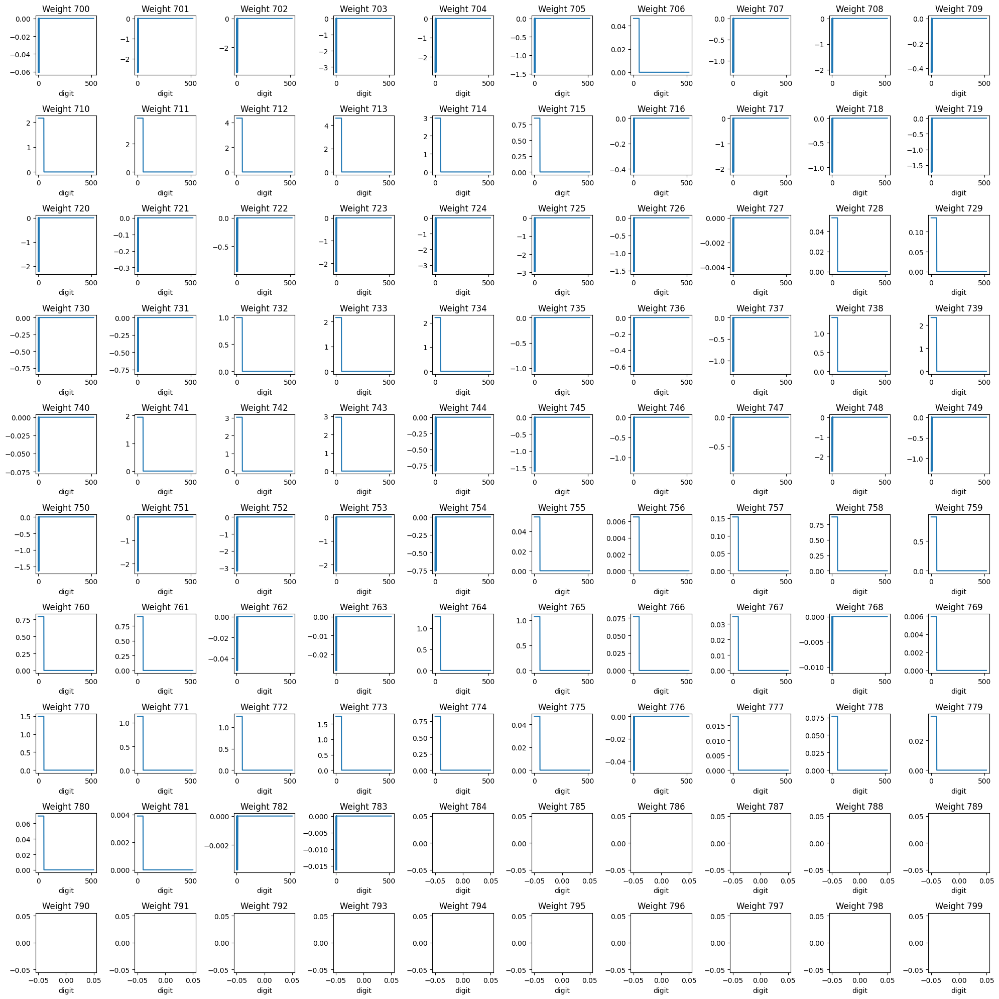

In [40]:
plot_neuron_weights(D1, hz_neuron)
plot_neuron_weights(D1, hz_neuron, pad=100)
plot_neuron_weights(D1, hz_neuron, pad=200)
plot_neuron_weights(D1, hz_neuron, pad=300)
plot_neuron_weights(D1, hz_neuron, pad=400)
plot_neuron_weights(D1, hz_neuron, pad=500)
plot_neuron_weights(D1, hz_neuron, pad=600)
plot_neuron_weights(D1, hz_neuron, pad=700)

At the first occurrence of a zero output, all the weights are updated to zero. The resulting weights are zero.

In [41]:
X1.digit = X1.digit.astype(int)
X1 = X1.sort_values('digit')
X1[X1.neuron == hz_neuron].reset_index(drop=True)[50:60]

,neuron,digit,output
50,39,41,0.448890
51,39,42,0.225338
52,39,43,0.500611
53,39,44,0.475075
54,39,45,0.292341
55,39,46,0.753948
56,39,47,0.223027
57,39,48,0.545588
58,39,49,0.442002
59,39,50,0.468424


The first occurrence of an ouptut zero is at the digit 53.

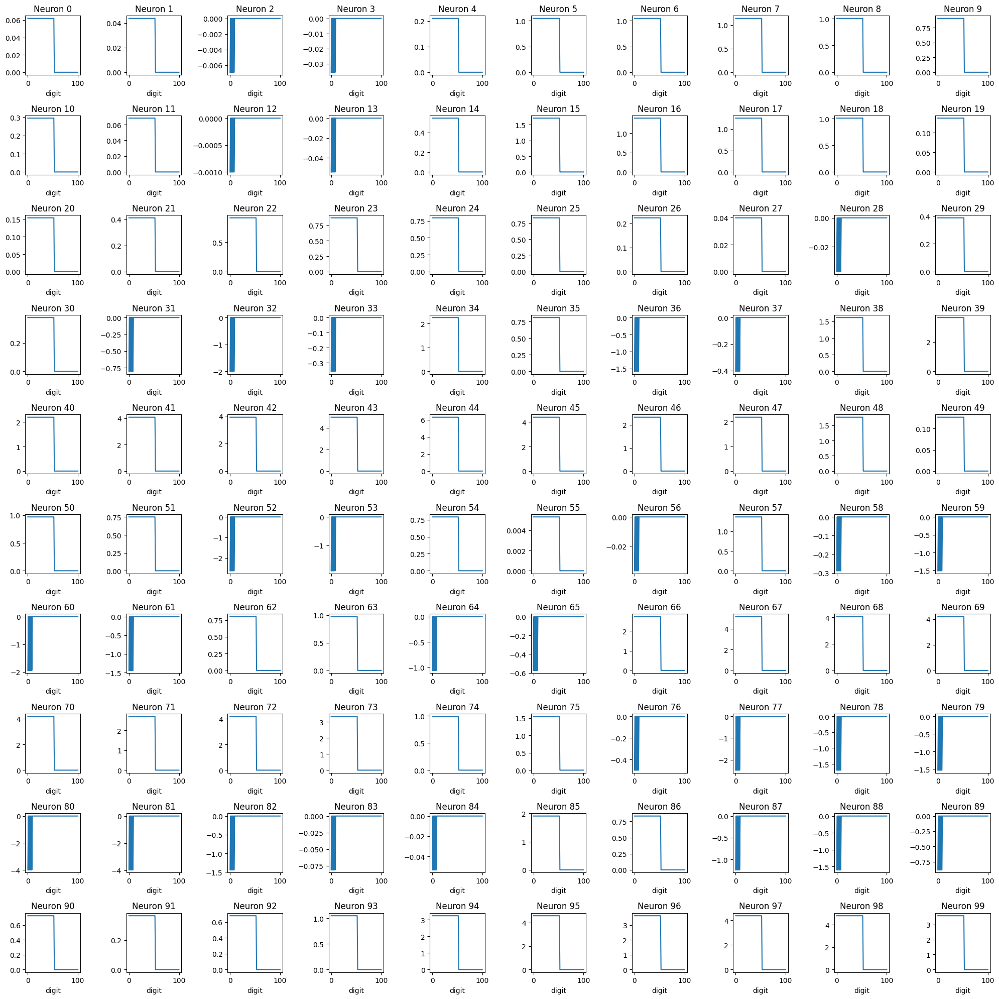

In [43]:
plot_neuron_weights_05xticks(D1[D1.digit <= 100], hz_neuron)
# plot_neuron_weights(D1, hz_neuron, pad=100)
# plot_neuron_weights(D1, hz_neuron, pad=200)
# plot_neuron_weights(D1, hz_neuron, pad=300)
# plot_neuron_weights(D1, hz_neuron, pad=400)
# plot_neuron_weights(D1, hz_neuron, pad=500)
# plot_neuron_weights(D1, hz_neuron, pad=600)
# plot_neuron_weights(D1, hz_neuron, pad=700)

As expected, negative weights are updated to zero after the first iteration, and when the digit two is processed.

#### Selected neurons and Weights

In [44]:
post_ci_df = D1[D1.digit == 519][[str(neuron) for neuron in range(1,49)]].transform(lambda x: x > 0).astype(int).reset_index(drop=True)

In [45]:
post_ci_df

,1,2,3,4,5,6,7,8,9,10,...,39,40,41,42,43,44,45,46,47,48
0,0,0,0,0,0,1,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
1,0,0,0,0,0,1,0,0,0,0,...,0,1,0,0,0,0,0,1,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,1,0,0
3,0,0,0,0,0,1,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
779,0,0,0,0,0,1,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
780,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,1,0,0
781,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
782,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Text(0.5, 1.0, 'Neurons selected for the module after CI procedure')

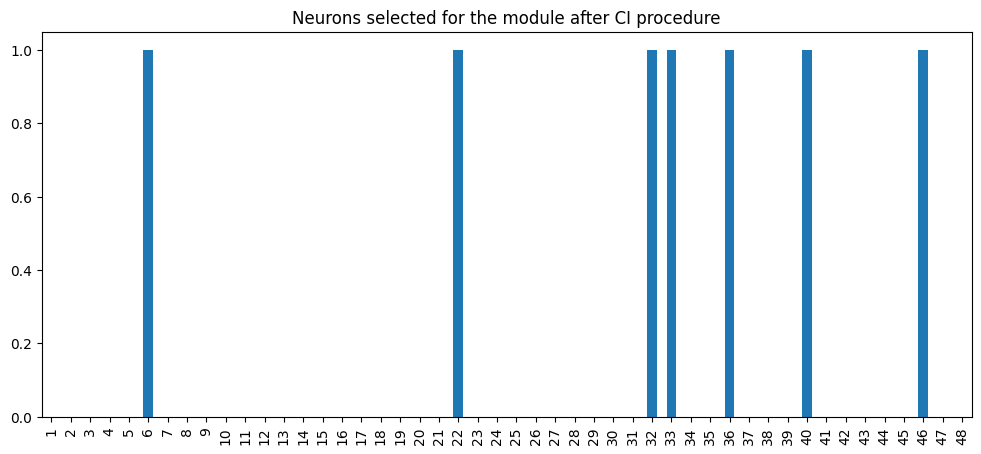

In [46]:
post_ci_df.sum().map(lambda x: 1 if x >= 1 else 0).plot(kind='bar', figsize=(12,5))
plt.title('Neurons selected for the module after CI procedure')

Only 7 neurons were selected during the CI phase of the algorithm.

Text(0.5, 1.0, 'Selected Weights for the module after CI procedure')

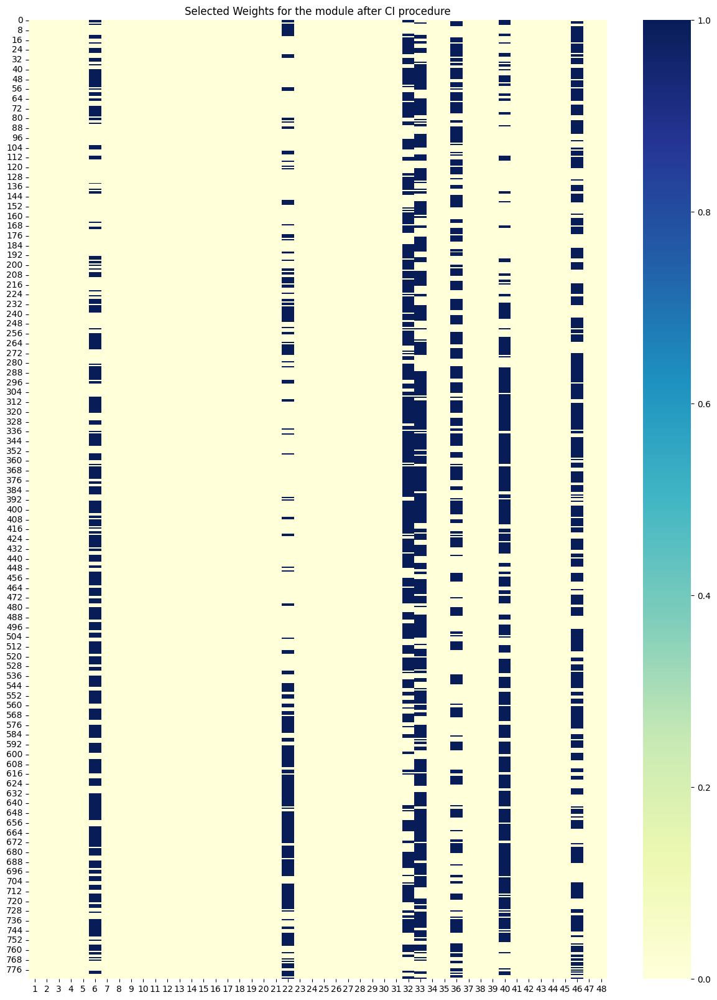

In [47]:
plt.figure(figsize=(15,20))
sns.heatmap(post_ci_df, cmap='YlGnBu', fmt="g")
plt.title('Selected Weights for the module after CI procedure')

From those, only a few weights will be used.

### Output layer

In [54]:
X2[X2.output <= 0]

,neuron,digit,output


No outputs were less than or equal to zero in the second layer.

##### n2 (Label Neuron)

In [55]:
r_neuron = 2

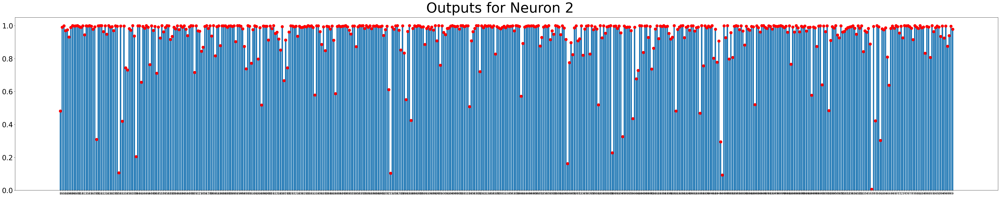

In [56]:
output_r = X2[X2.neuron == r_neuron][['output', 'digit']].reset_index(drop=True)

fig, axes = plt.subplots(1, 1, figsize=(50, 10), sharex=True)

plt.bar(output_r.digit, output_r.output)
plt.scatter(output_r.digit, output_r.output, color='red', s=100)

axes.tick_params(axis='y', labelsize=25)

fig.suptitle(f"Outputs for Neuron {r_neuron}", fontsize=50)

# Display the plot
plt.tight_layout()
plt.show()

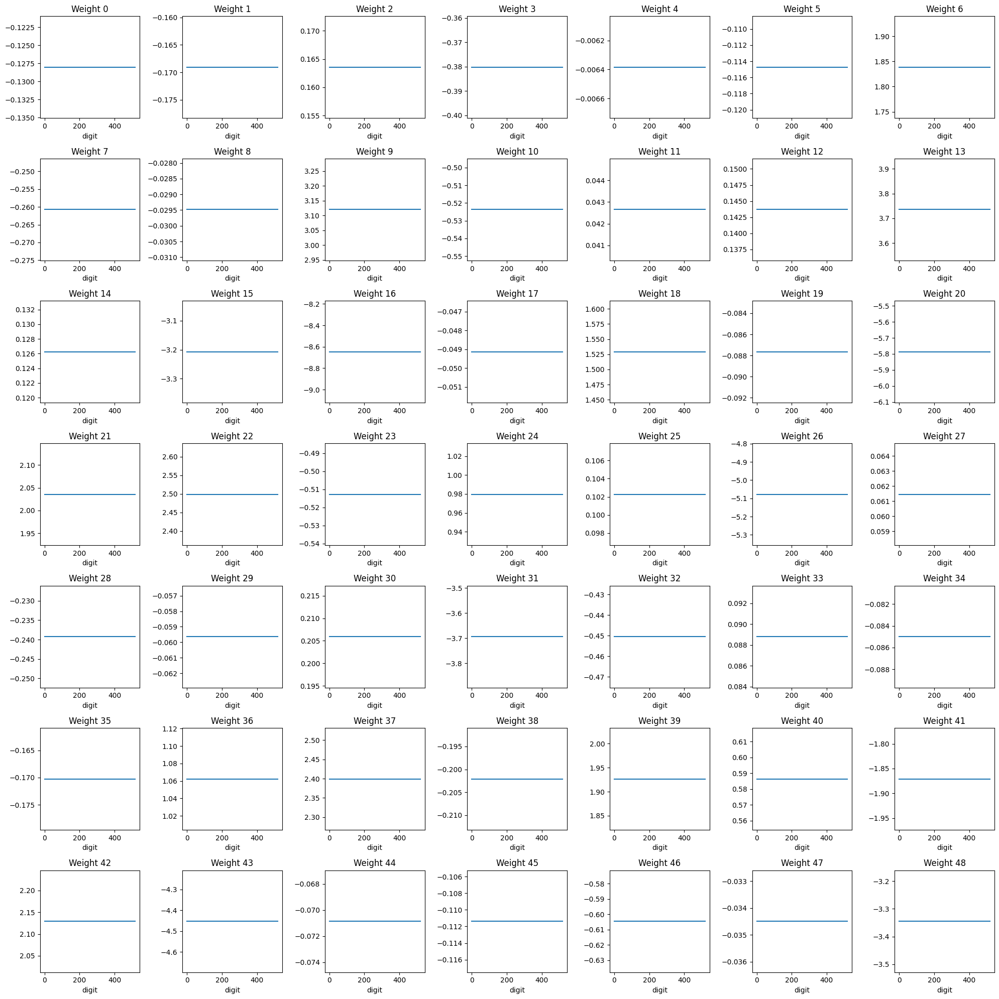

In [51]:
plot_neuron_weights(D2, r_neuron,subplot_sizex=7, subplot_sizey=7)

Same as before. The min max operation does not affect the resulting weight.

##### n6

In [57]:
r_neuron = 6

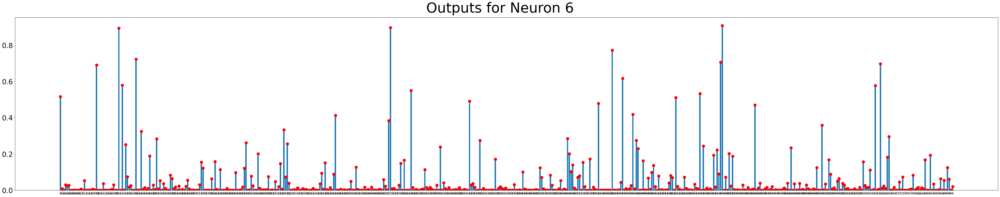

In [58]:
output_r = X2[X2.neuron == r_neuron][['output', 'digit']].reset_index(drop=True)

fig, axes = plt.subplots(1, 1, figsize=(50, 10), sharex=True)

plt.bar(output_r.digit, output_r.output)
plt.scatter(output_r.digit, output_r.output, color='red', s=100)

axes.tick_params(axis='y', labelsize=25)

fig.suptitle(f"Outputs for Neuron {r_neuron}", fontsize=50)

# Display the plot
plt.tight_layout()
plt.show()

In [59]:
output_r.sort_values(by='output').head(10)

,output,digit
288,0.000002,35
28,0.000004,125
472,0.000005,57
33,0.000008,12
505,0.000008,87
509,0.000009,90
134,0.000009,220
233,0.000011,30
263,0.000012,337
497,0.000013,7


Very small outputs, but no zeros!

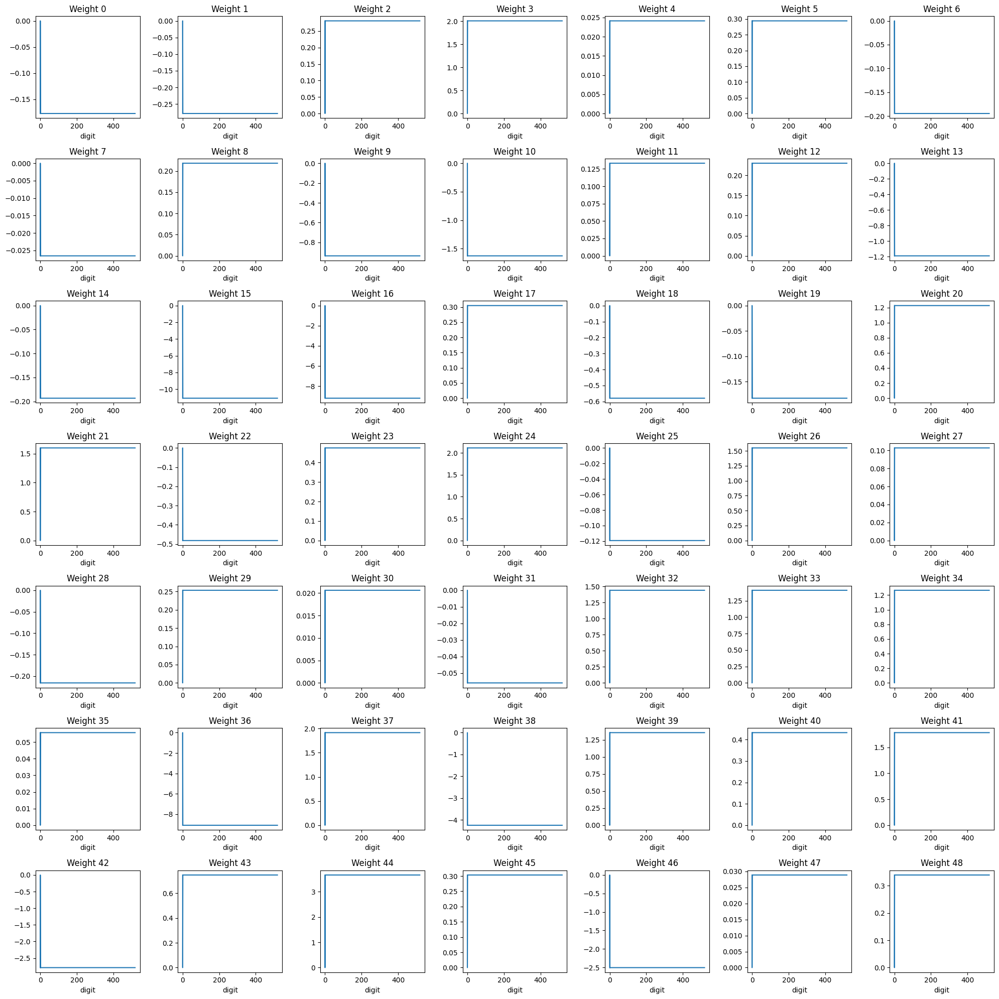

In [55]:
plot_neuron_weights(D2, r_neuron,subplot_sizex=7, subplot_sizey=7)

#### Selected neurons and Weights

Text(0.5, 1.0, 'Updated Weights')

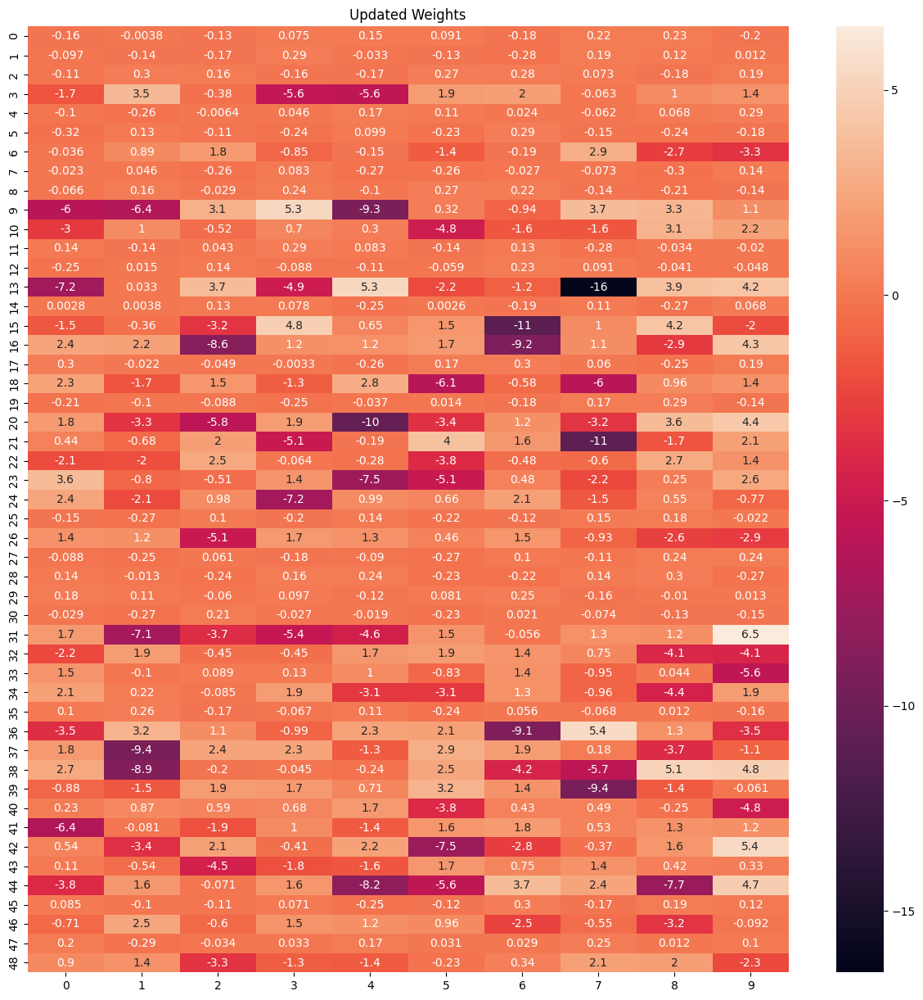

In [92]:
plt.figure(figsize=(15,15))
sns.heatmap(slc.D2, annot=True)#, cmap='YlGnBu', fmt="g")
plt.title('Updated Weights')

For the output layer, negative weights are kept.

By reading the code, D2 gets the model weights in the first pass. Afterwards, the algorithm makes the actual weights and the updated weights, which are equal. Therefore, no changes are made in the end.

Text(0.5, 1.0, 'Neurons selected for the module after CI procedure')

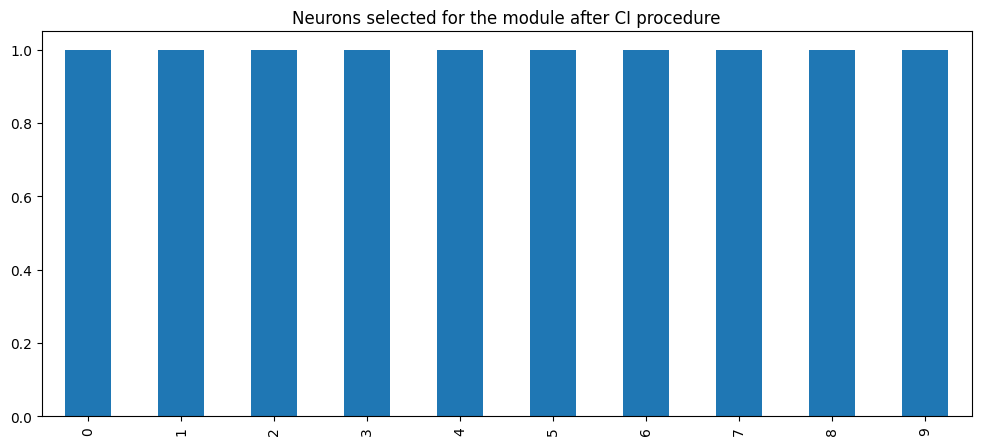

In [89]:
post_ci_output_df = pd.DataFrame(slc.D2).transform(lambda x: x > 0).astype(int).reset_index(drop=True)
post_ci_output_df.sum().map(lambda x: 1 if x >= 1 else 0).plot(kind='bar', figsize=(12,5))
plt.title('Neurons selected for the module after CI procedure')

All neurons neurons were kept after the CI phase of the algorithm.

Text(0.5, 1.0, 'Selected Weights for the module after CI procedure')

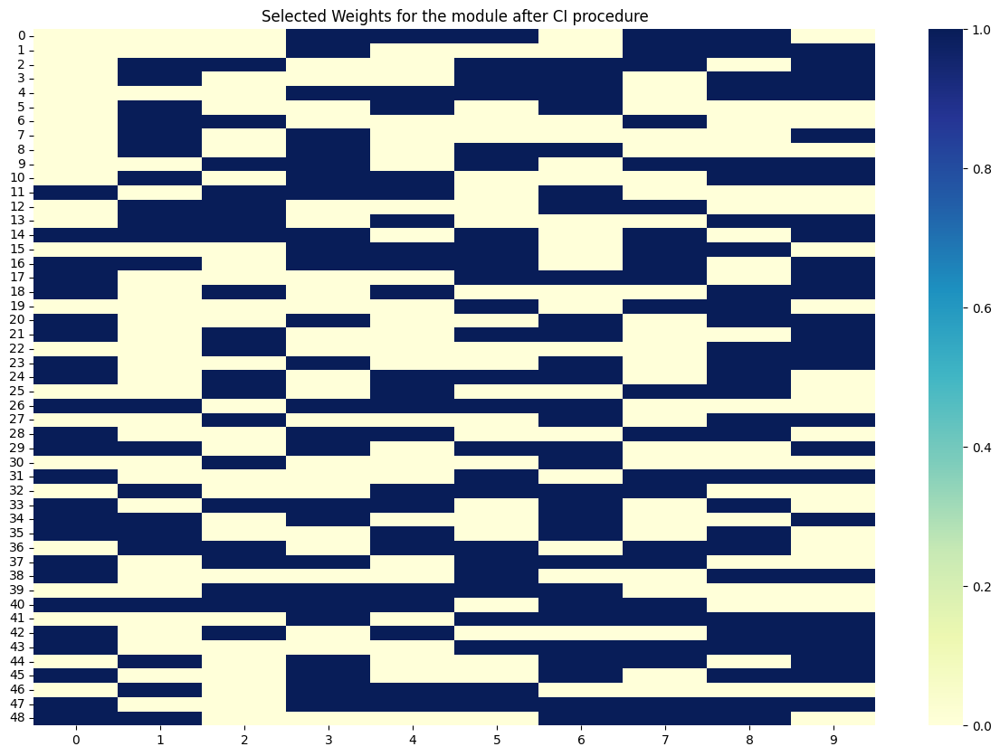

In [91]:
plt.figure(figsize=(15,10))
sns.heatmap(post_ci_output_df, cmap='YlGnBu', fmt="g")
plt.title('Selected Weights for the module after CI procedure')

From those, only a few weights will be used.

## Conclusion of the CI analysis

- They use the test set to update de weights.
- In the Dense layer
    - All the weights above 0 are kept, and the negatives are set to zero. 
        - One of the possible reasons is that negative weights would pull the output value down, thus not contibute to the final value - which goes through the ReLU function. Nevertheless, some more investigation should be taken w.r.t. understanding the role of the weight in the final module.
    - The max and min operations seen in the code have no effect, since self.W1 never changes and D1 is set to self.W1 in first pass. Thus, all weights in self.W1 are equal to the weights in D1.
    - If a single sample outputs zero in a neuron, all the neuron's weights are set to zero
    - [ ] See if the other approaches are the same.
- In the Output layer
    - Weights are kept as they are.

# Tangling Identification: Imbalance (TI-I).

First, the algorithm gets the examples that do not belong to the module.

In [68]:
digit=[]
for k in labs:
    if(k!=j):
        temp=xT[yT==k]
        print(len(temp))
        temp=temp[0:1]
        print(len(temp))
        for u in temp:
            digit.append(u)
np.random.shuffle(digit)

4800
1
4800
1
4800
1
4800
1
4800
1
4800
1
4800
1
4800
1
4800
1


For each digit, the algorithm gets only one example.
- shuffle should have happened before.

<Axes: >

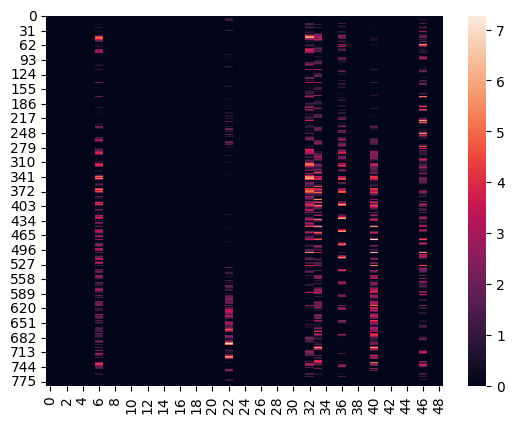

In [93]:
sns.heatmap(pd.DataFrame(slc.D1))

<Axes: >

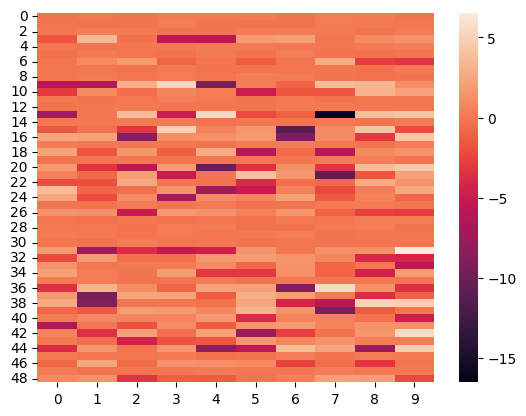

In [94]:
sns.heatmap(pd.DataFrame(slc.D2))

In [95]:
mc = 0
for x in digit:
    W1, W2,b1,b2 = slc.dynamicmodify(slicingModel,x, mc, sx,sy)
    mc=mc+1
    if np.count_nonzero(slc.D2) < 45:
        #print("Breaking at mc ", mc,np.count_nonzero(slc.D2))
        slc.first = True

In [104]:
import pandas as pd
path = "data/intermediate"

def concat_series_tii(param, path):
    result = pd.DataFrame()
    for index, file in [(file.split('_')[0], file) for file in os.listdir(path) if param in file and '_tii' in file]:
        df = pd.read_csv(os.path.join(path, file))
        
        if type(df) == pd.core.frame.DataFrame:
            df = df.drop(columns=['Unnamed: 0']).assign(digit=index)
            result = pd.concat([result, df])
        else:
            df = df['0'].rename(index)
            result = pd.concat([result, df], axis=1)
        
    
    return result


tii_d1 = concat_series_tii('dd1', path)
print(f"Shape of d1: {tii_d1.shape}")
tii_d2 = concat_series_tii('dd2', path)
print(f"Shape of d2: {tii_d2.shape}")
tii_X1 = concat_series_tii('X1', path)
print(f"Shape of X1: {tii_X1.shape}")
tii_X2 = concat_series_tii('X2', path)
print(f"Shape of X2: {tii_X2.shape}")
tii_D1 = concat_series_tii('D1', path)
print(f"Shape of D1: {tii_D1.shape}")
tii_D2 = concat_series_tii('D2', path)
print(f"Shape of D2: {tii_D2.shape}")

Shape of d1: (441, 2)
Shape of d2: (90, 2)
Shape of X1: (441, 2)
Shape of X2: (90, 2)
Shape of D1: (7056, 50)
Shape of D2: (441, 11)


In [105]:
tii_X1['output'] = tii_X1['0']
tii_X1 = tii_X1.reset_index(names=['neuron']).drop(columns=['0'])

tii_X2['output'] = tii_X2['0']
tii_X2 = tii_X2.reset_index(names=['neuron']).drop(columns=['0'])

In [106]:
tii_D1 = tii_D1.reset_index(names=['neuron'])

tii_D2 = tii_D2.reset_index(names=['neuron'])

In [107]:
tii_D1.digit = tii_D1.digit.astype('int')
tii_D1['weight'] = tii_D1.groupby('digit')['digit'].transform('cumcount')
tii_D1 = tii_D1.sort_values(['digit', 'weight'])

tii_D2.digit = tii_D2.digit.astype('int')
tii_D2['weight'] = tii_D2.groupby('digit')['digit'].transform('cumcount')
tii_D2 = tii_D2.sort_values(['digit', 'weight'])

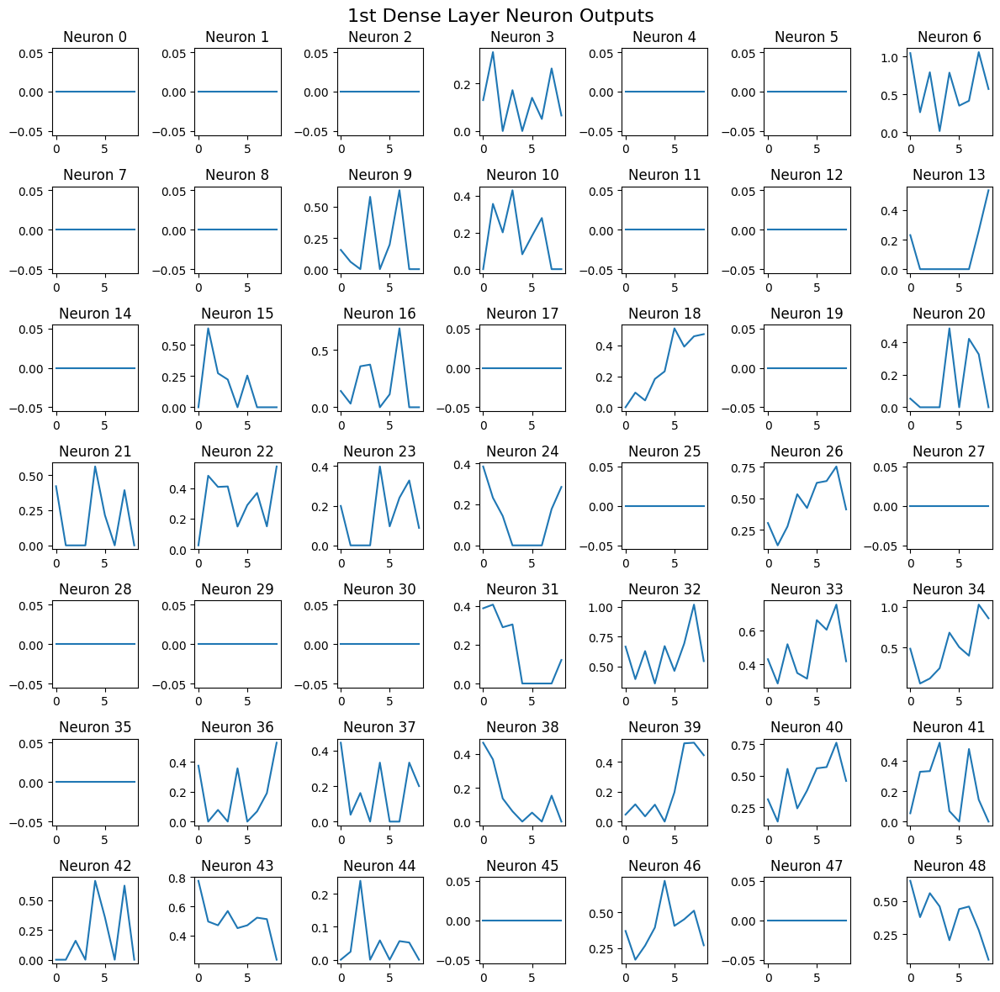

In [108]:
fig, axes = plt.subplots(7, 7, figsize=(12, 12))

for i, ax in enumerate(axes.flat):
    tii_X1[tii_X1.neuron == i].output.reset_index(drop=True).plot(ax=ax)
    ax.set_title(f'Neuron {i}')

fig.suptitle("1st Dense Layer Neuron Outputs", fontsize=16)
plt.tight_layout()  # Adjust the spacing between subplots
plt.show()

- Some neurons are not activated at all. E.g.: n0, n1, n25, n27, n47
- Because of the ReLU function, no output value is below zero. 
- Neurons like n6, n22 and n3 behave as expected
- More neurons hit zero.

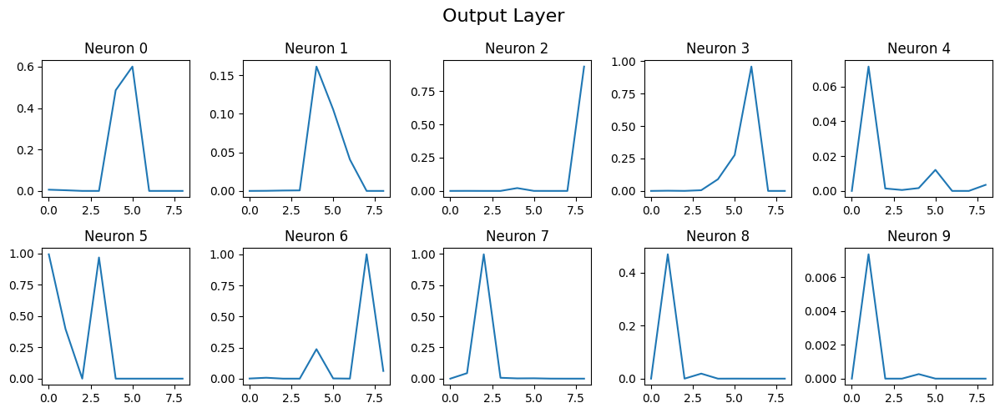

In [109]:
fig, axes = plt.subplots(2, 5, figsize=(12, 5))

for i, ax in enumerate(axes.flat):
    tii_X2[tii_X2.neuron == i].output.reset_index(drop=True).plot(ax=ax)
    ax.set_title(f'Neuron {i}')

fig.suptitle("Output Layer", fontsize=16)
plt.tight_layout()  # Adjust the spacing between subplots
plt.show()

## Dense Layer

### Regular Neuron

#### n26

In [110]:
r_neuron = 26

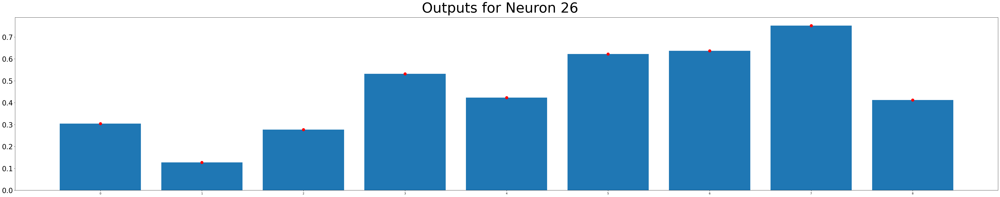

In [111]:
output_r = tii_X1[tii_X1.neuron == r_neuron][['output', 'digit']].reset_index(drop=True)

fig, axes = plt.subplots(1, 1, figsize=(50, 10), sharex=True)

# output_rn.plot(ax=axes, color='red')
# output_r.plot(kind='bar', ax=axes)
plt.bar(output_r.digit, output_r.output)
plt.scatter(output_r.digit, output_r.output, color='red', s=100)

axes.tick_params(axis='y', labelsize=25)

fig.suptitle(f"Outputs for Neuron {r_neuron}", fontsize=50)

# Display the plot
plt.tight_layout()
plt.show()

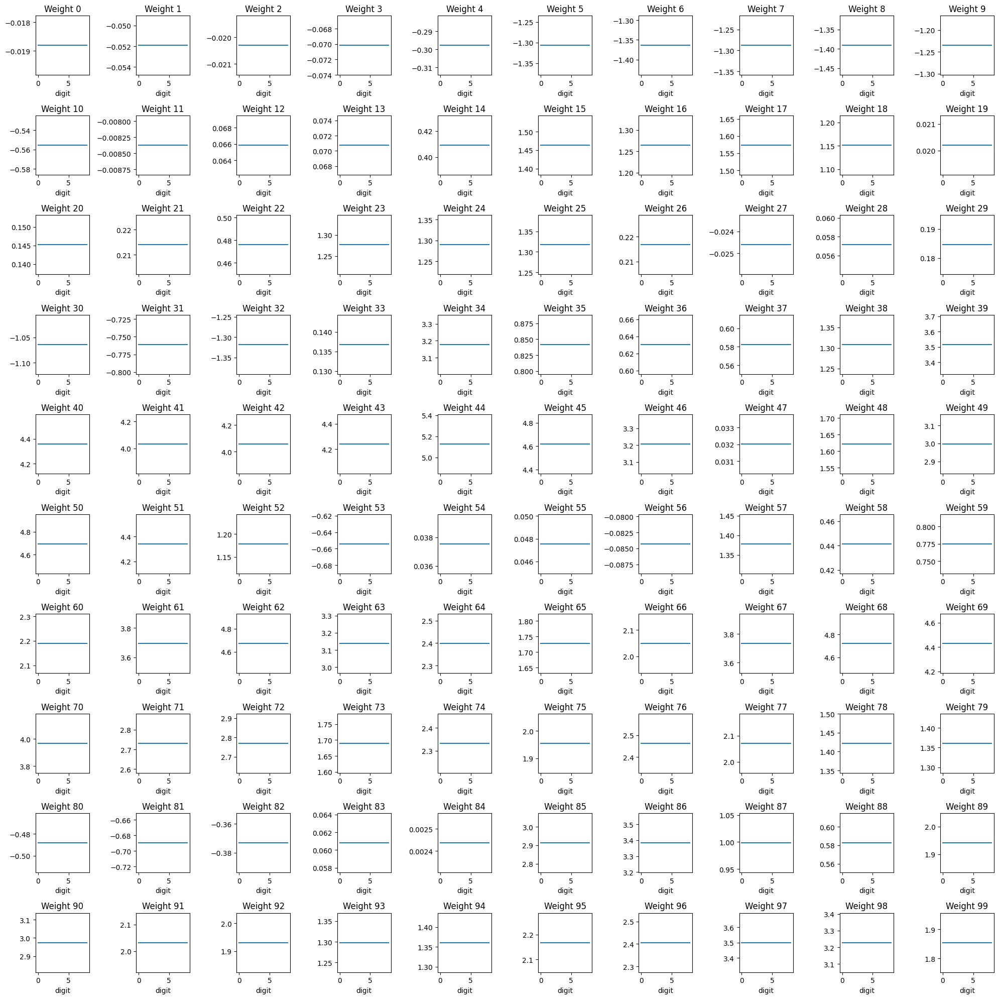

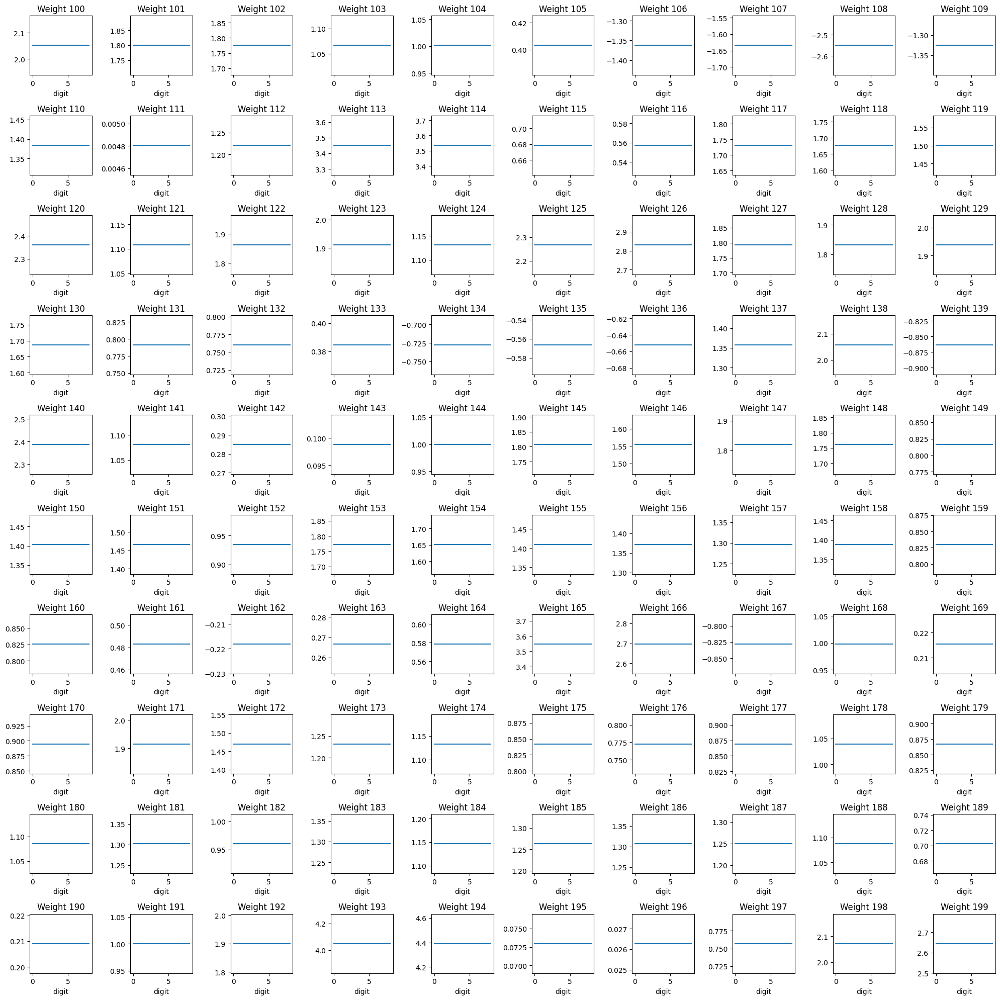

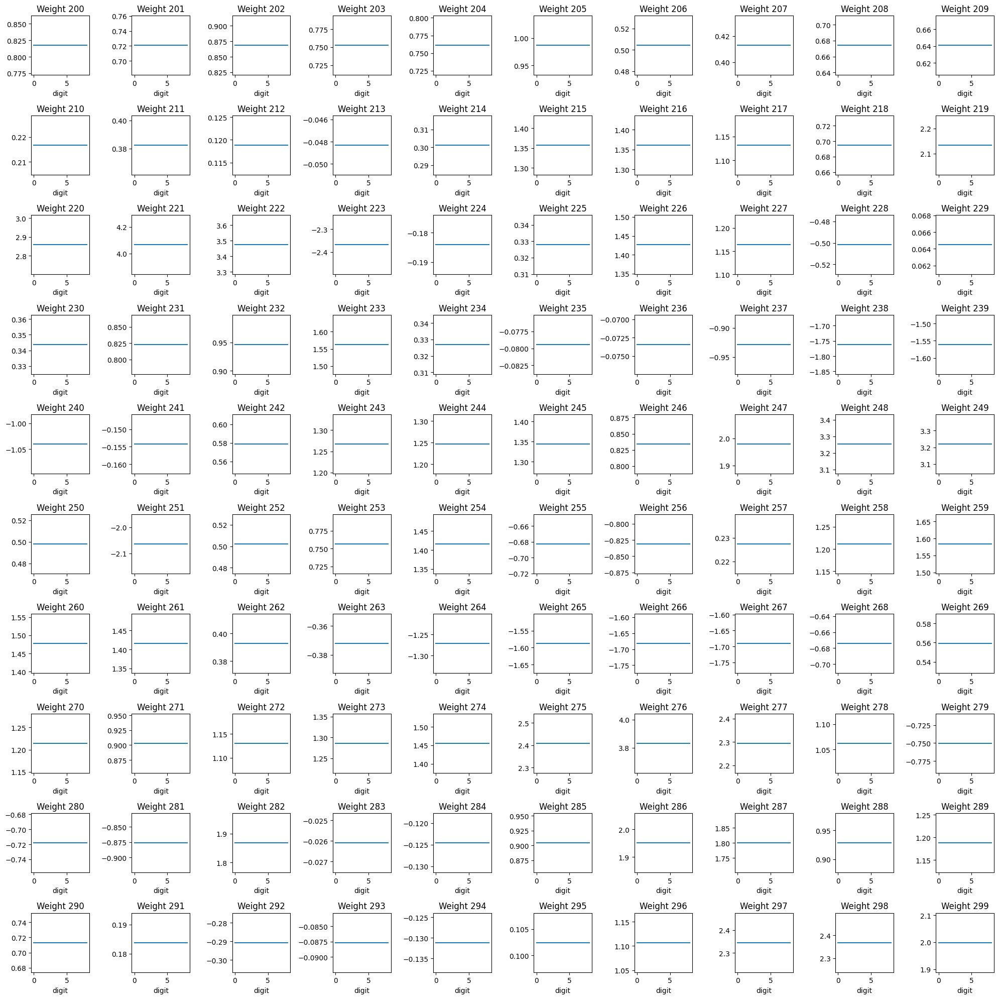

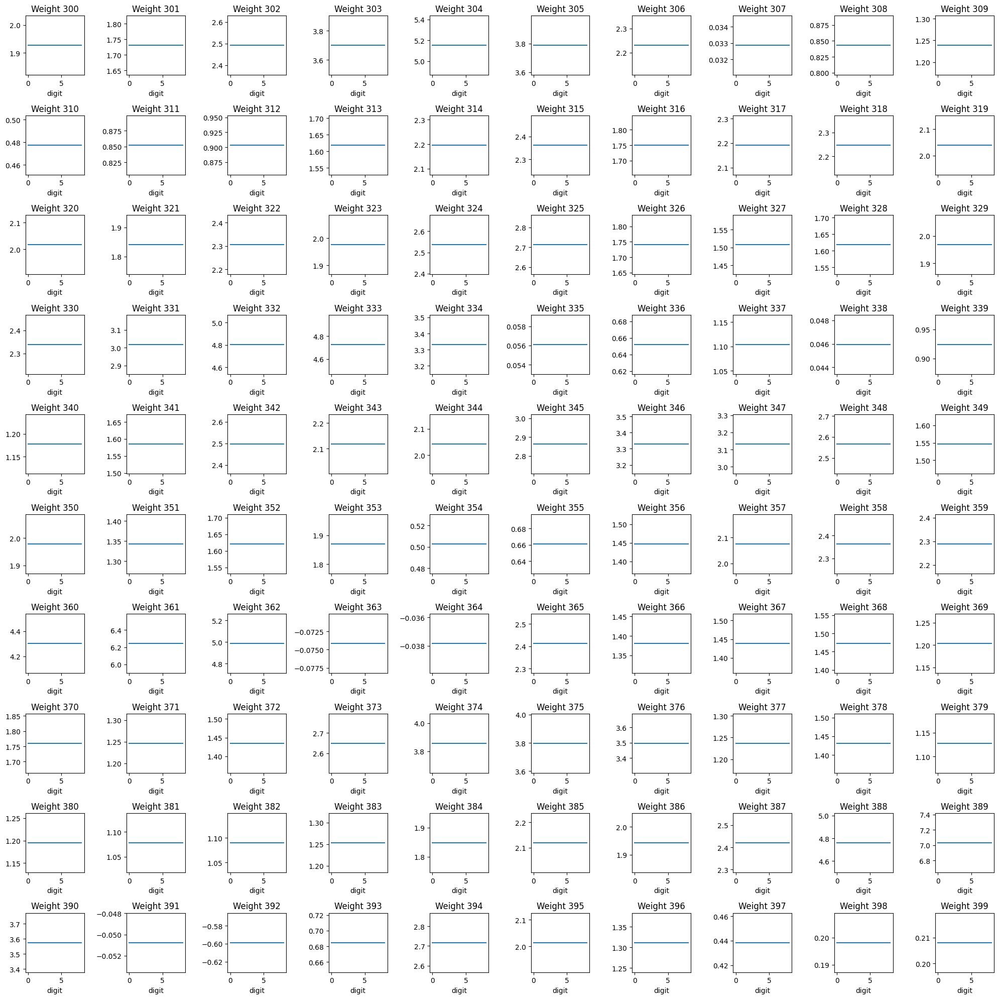

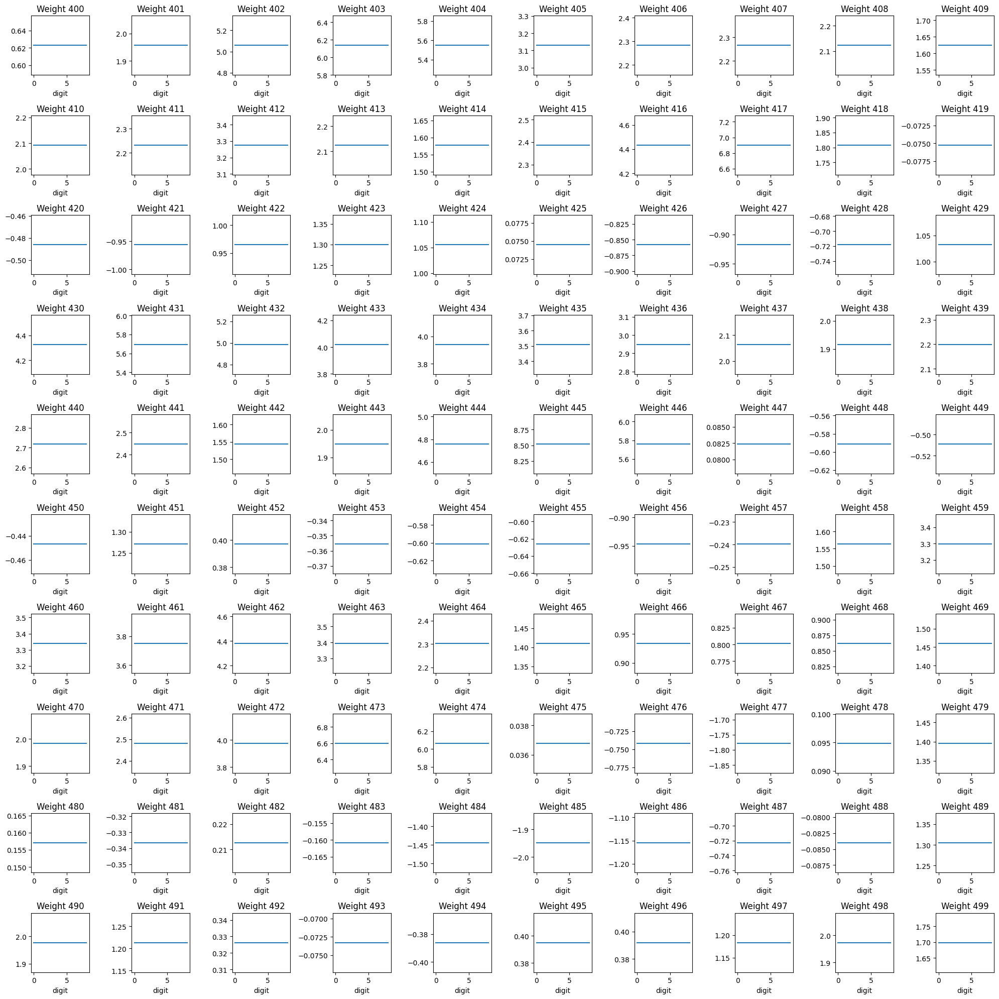

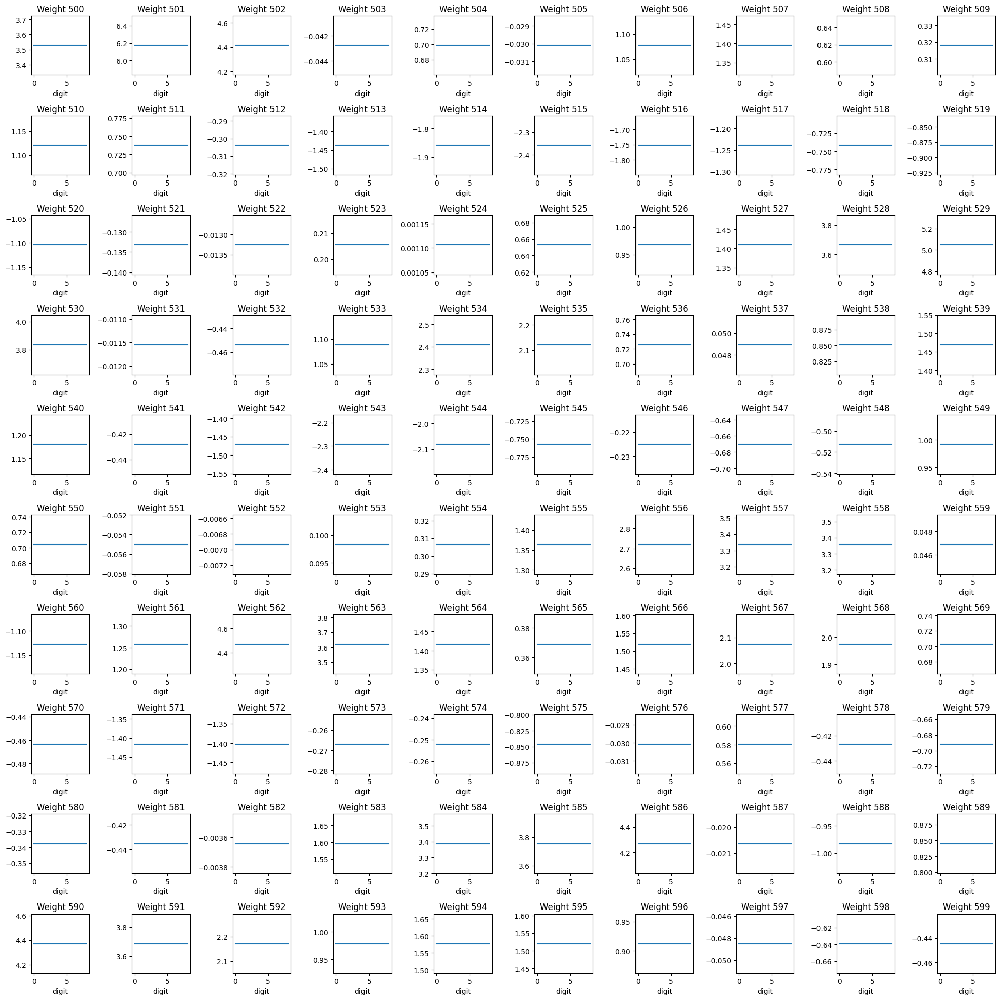

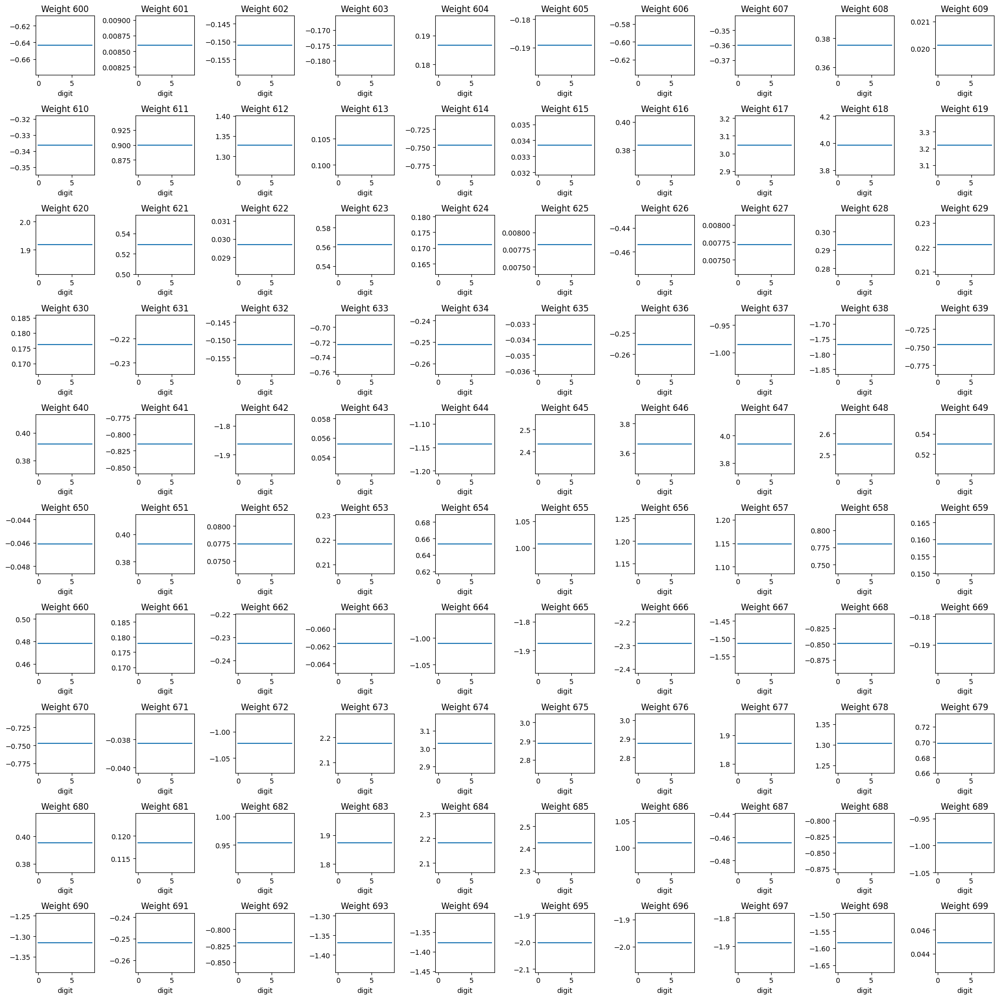

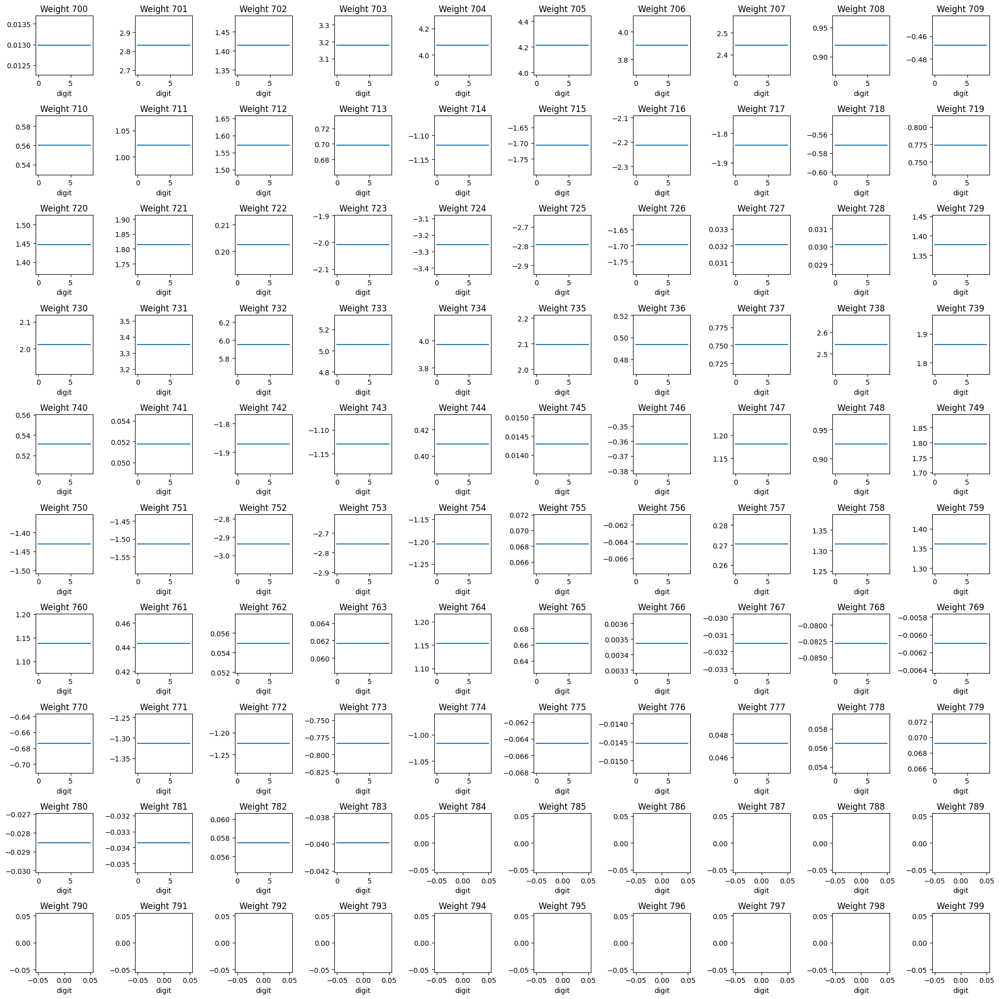

In [112]:
plot_neuron_weights(tii_D1, r_neuron)
plot_neuron_weights(tii_D1, r_neuron, pad=100)
plot_neuron_weights(tii_D1, r_neuron, pad=200)
plot_neuron_weights(tii_D1, r_neuron, pad=300)
plot_neuron_weights(tii_D1, r_neuron, pad=400)
plot_neuron_weights(tii_D1, r_neuron, pad=500)
plot_neuron_weights(tii_D1, r_neuron, pad=600)
plot_neuron_weights(tii_D1, r_neuron, pad=700)

From the code, if the output of the neuron is greater than zero, the weights are set back to the model weights. Else, they receive the value of the updated weight.
- The CI result is kept only in cases where all the outputs are zero. If a single output is greater than zero, all the weights go back to their original values for that neuron.

### Nonactivated Neuron

In [113]:
na_neuron = 14

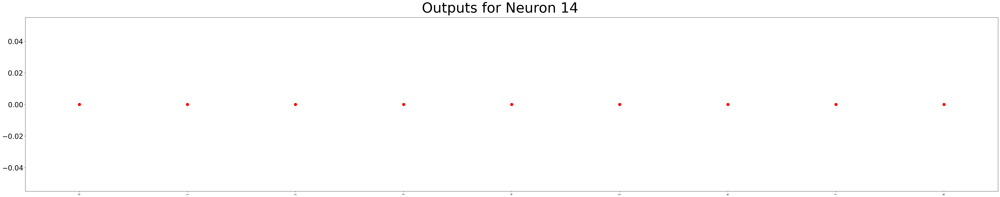

In [114]:
output_na = tii_X1[tii_X1.neuron == na_neuron].output.reset_index(drop=True)

fig, axes = plt.subplots(1, 1, figsize=(50, 10), sharex=True)

# output_rn.plot(ax=axes, color='red')
output_na.plot(kind='bar', ax=axes)
plt.scatter(output_na.index, output_na.values, color='red', s=100)

axes.tick_params(axis='y', labelsize=25)

fig.suptitle(f"Outputs for Neuron {na_neuron}", fontsize=50)

# Display the plot
plt.tight_layout()
plt.show()

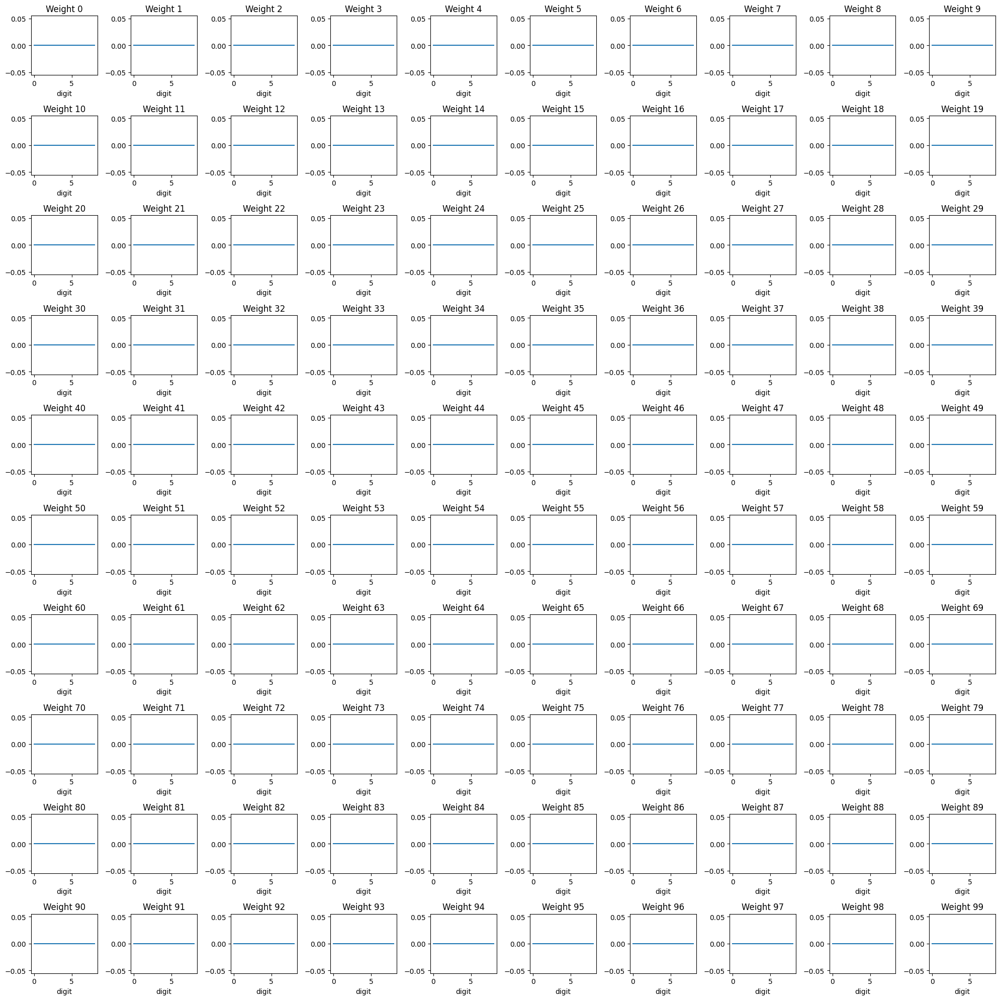

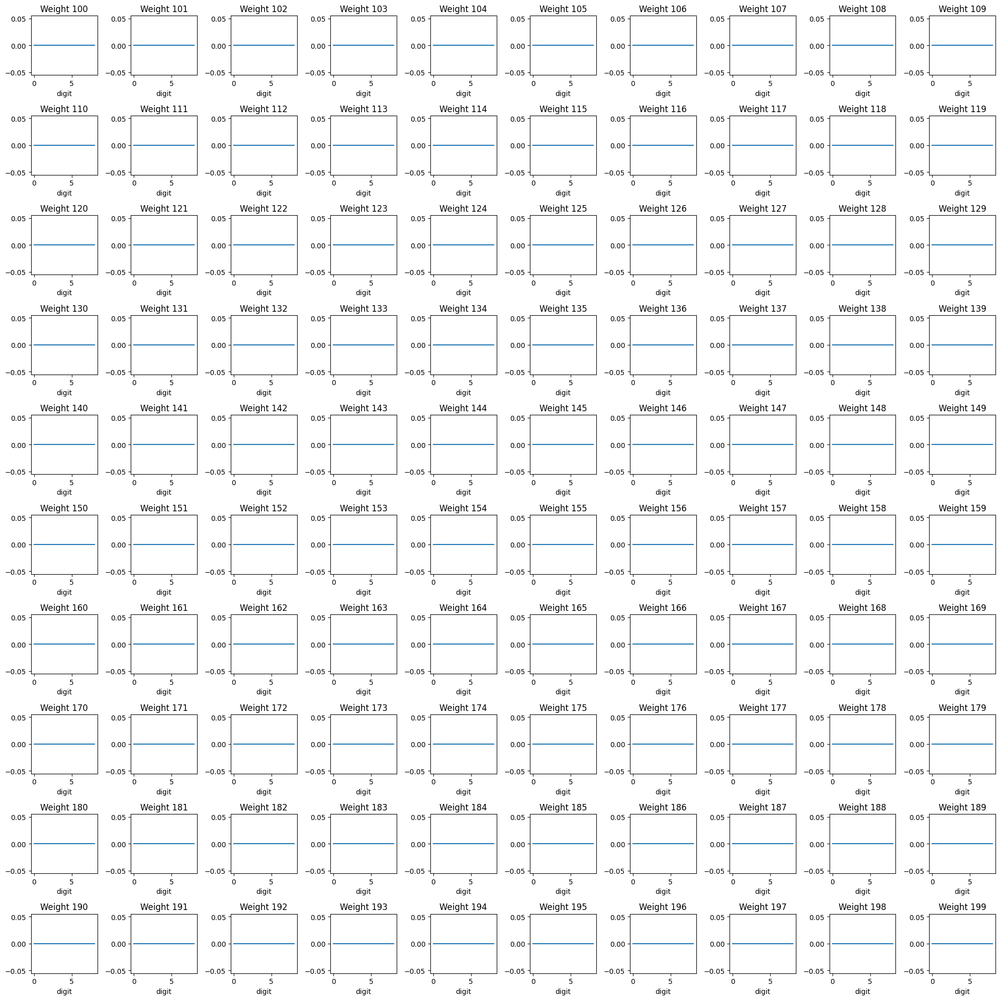

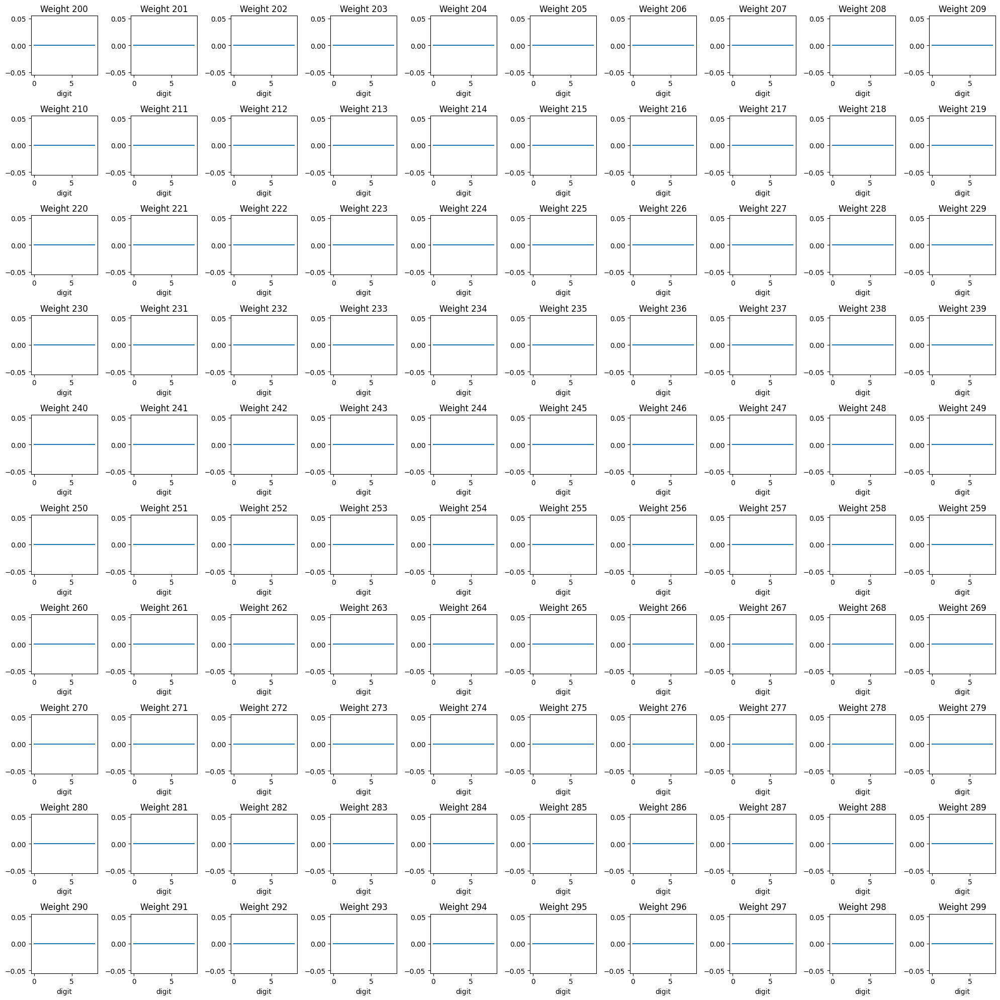

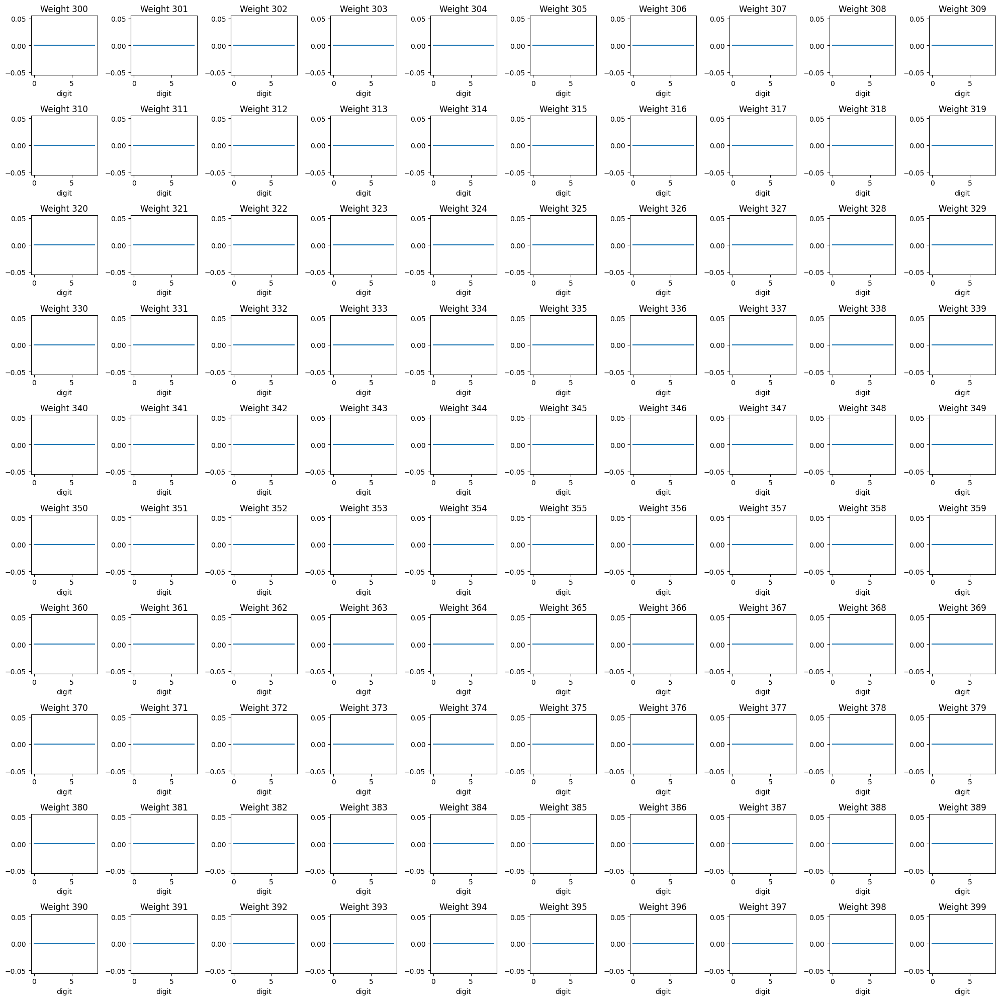

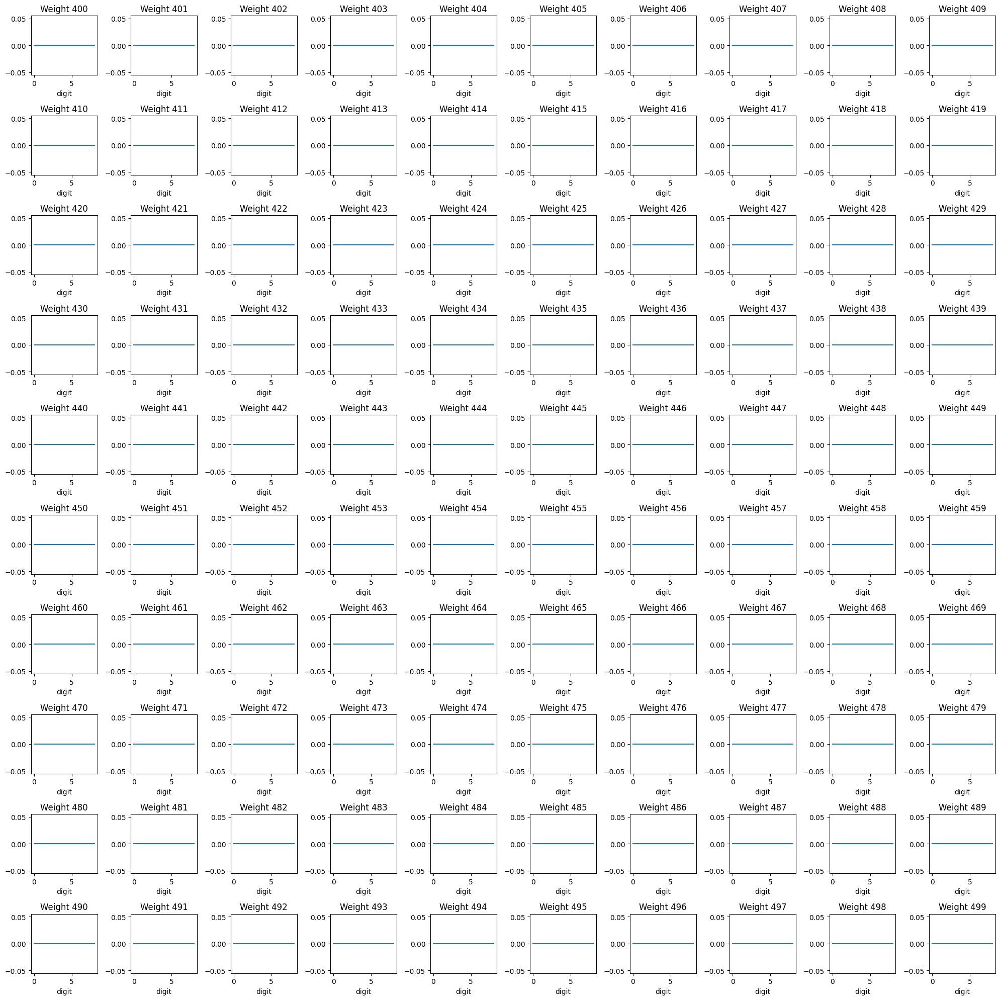

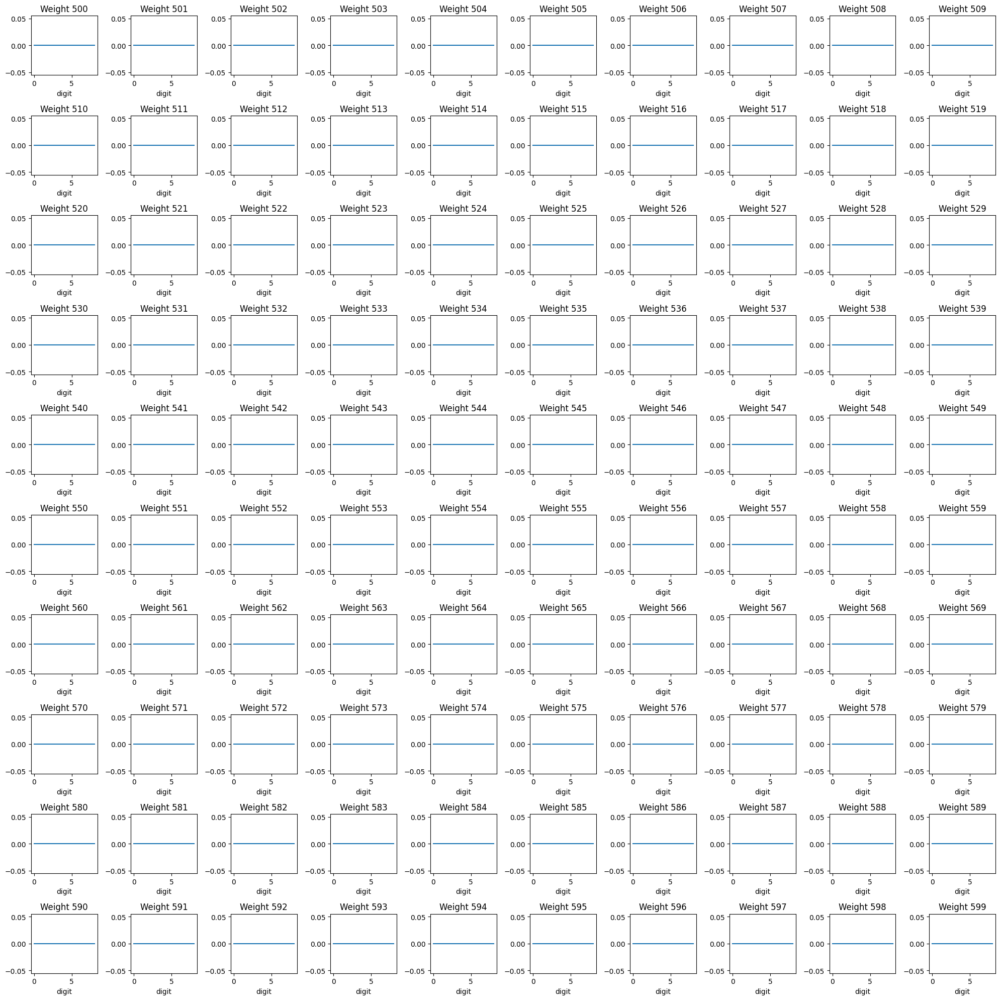

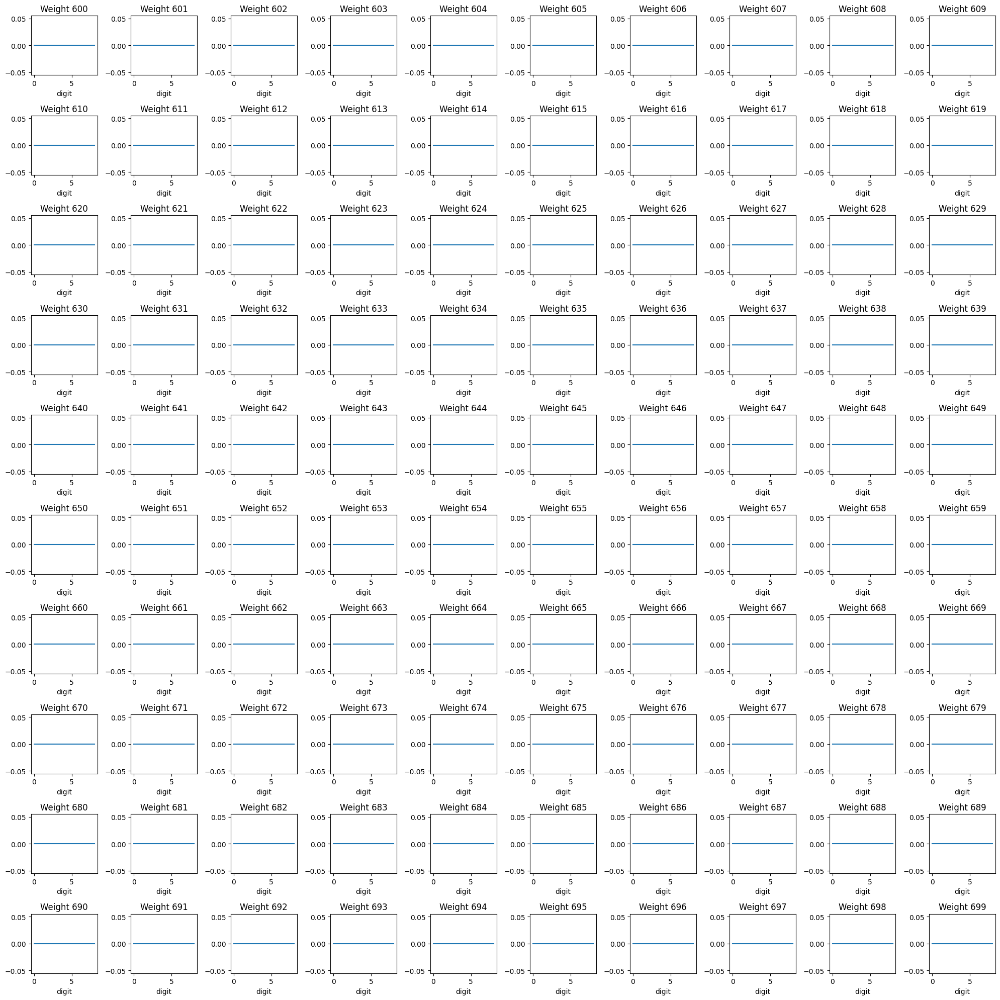

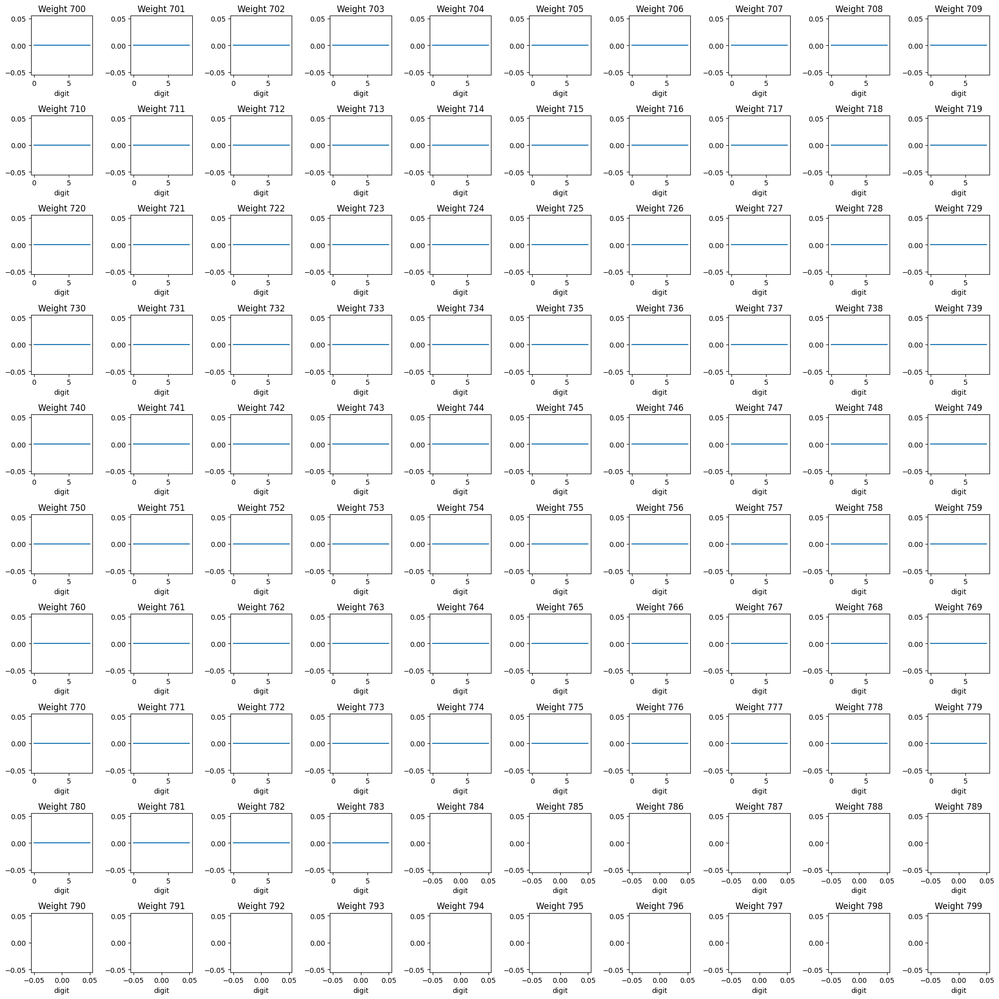

In [115]:
plot_neuron_weights(tii_D1, na_neuron)
plot_neuron_weights(tii_D1, na_neuron, pad=100)
plot_neuron_weights(tii_D1, na_neuron, pad=200)
plot_neuron_weights(tii_D1, na_neuron, pad=300)
plot_neuron_weights(tii_D1, na_neuron, pad=400)
plot_neuron_weights(tii_D1, na_neuron, pad=500)
plot_neuron_weights(tii_D1, na_neuron, pad=600)
plot_neuron_weights(tii_D1, na_neuron, pad=700)

In [116]:
D1[str(na_neuron)]

0         0.0
1         0.0
2         0.0
3         0.0
4         0.0
         ... 
365339    0.0
365340    0.0
365341    0.0
365342    0.0
365343    0.0
Name: 14, Length: 407680, dtype: float64

All the weights of this neuron were 0 after the CI operation. Thus, since no output was greater than zero, the weights were kept as zero.

### Neurons with Outputs that hit zero

#### n3

In [117]:
hz_neuron = 3

In [118]:
tii_X1[tii_X1.neuron == hz_neuron]

,neuron,digit,output
3,3,0,0.129886
52,3,1,0.331718
101,3,2,0.000000
150,3,3,0.171875
199,3,4,0.000000
248,3,5,0.139914
297,3,6,0.050690
346,3,7,0.263158
395,3,8,0.065343


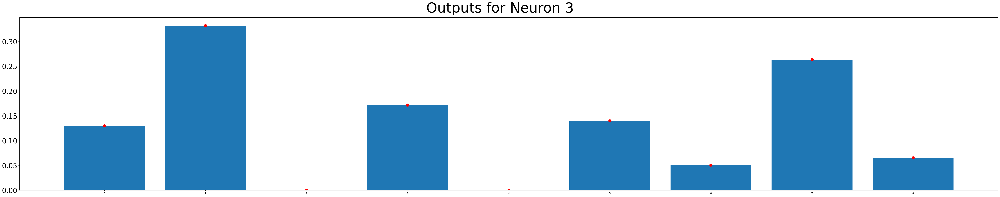

In [119]:
output_hz = tii_X1[tii_X1.neuron == hz_neuron][['output', 'digit']].reset_index(drop=True)

fig, axes = plt.subplots(1, 1, figsize=(50, 10), sharex=True)

# output_rn.plot(ax=axes, color='red')
# output_hz.plot(kind='bar', ax=axes)
plt.bar(output_hz.digit, output_hz.output)
plt.scatter(output_hz.digit, output_hz.output, color='red', s=100)

axes.tick_params(axis='y', labelsize=25)

fig.suptitle(f"Outputs for Neuron {hz_neuron}", fontsize=50)

# Display the plot
plt.tight_layout()
plt.show()

First zero is hit on example #2. 

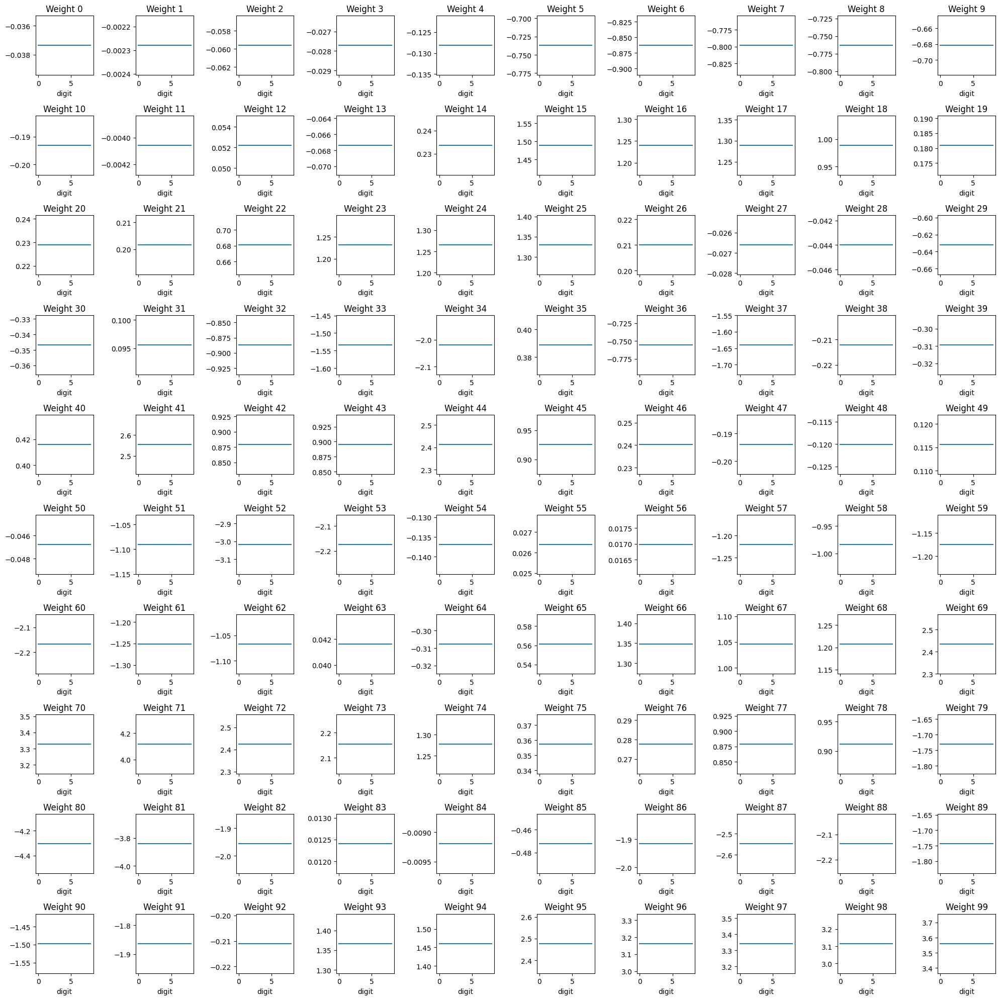

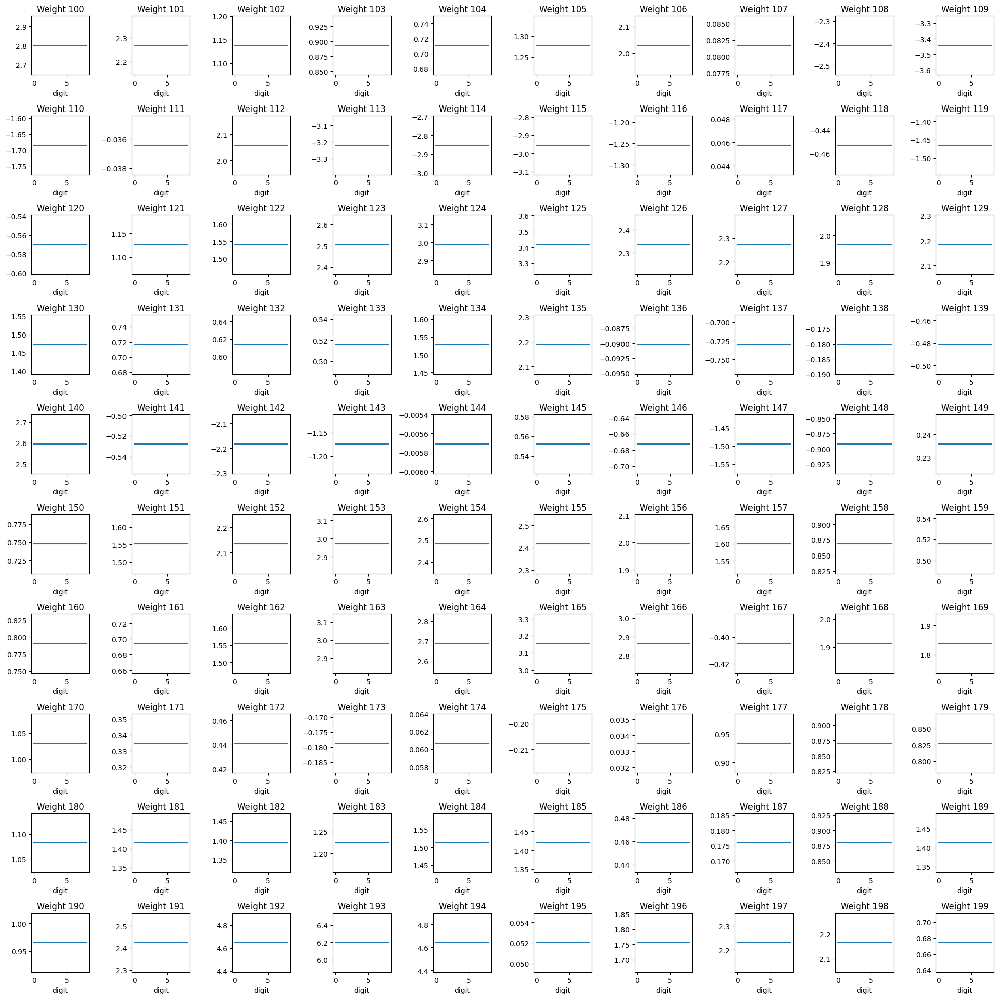

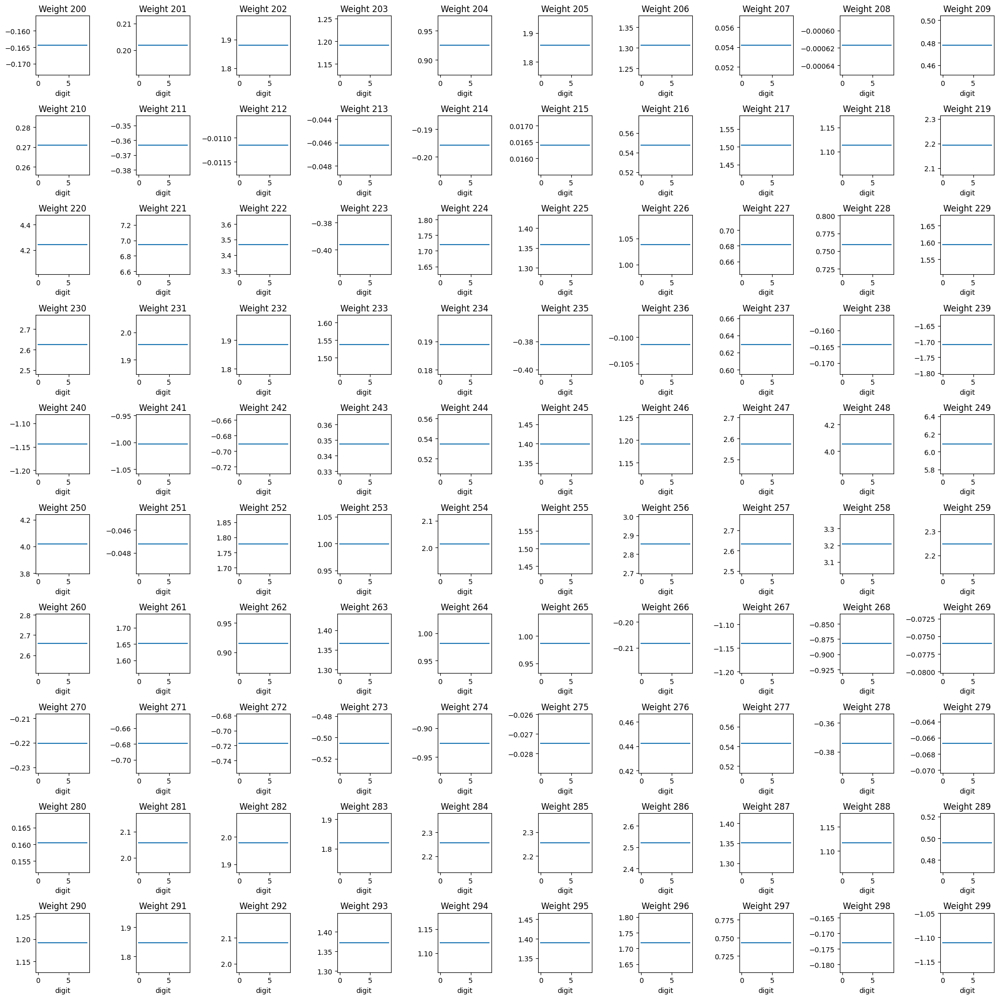

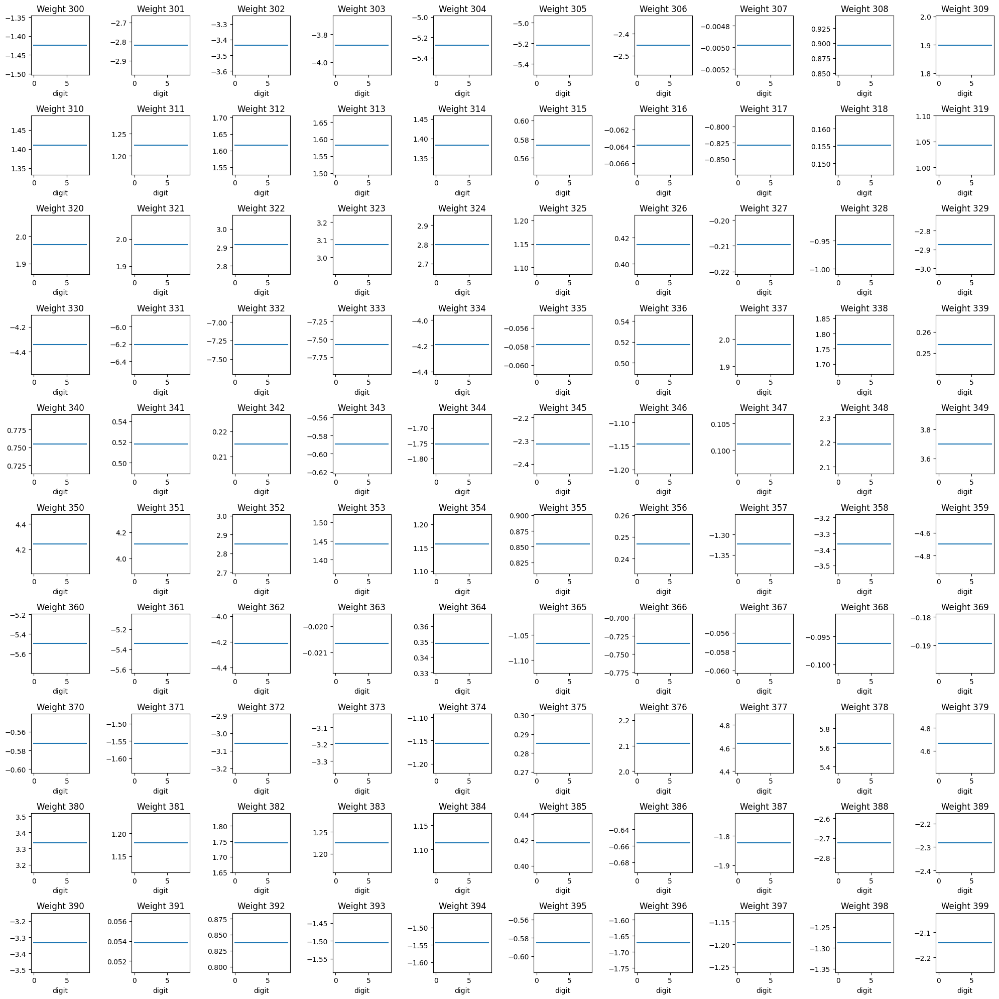

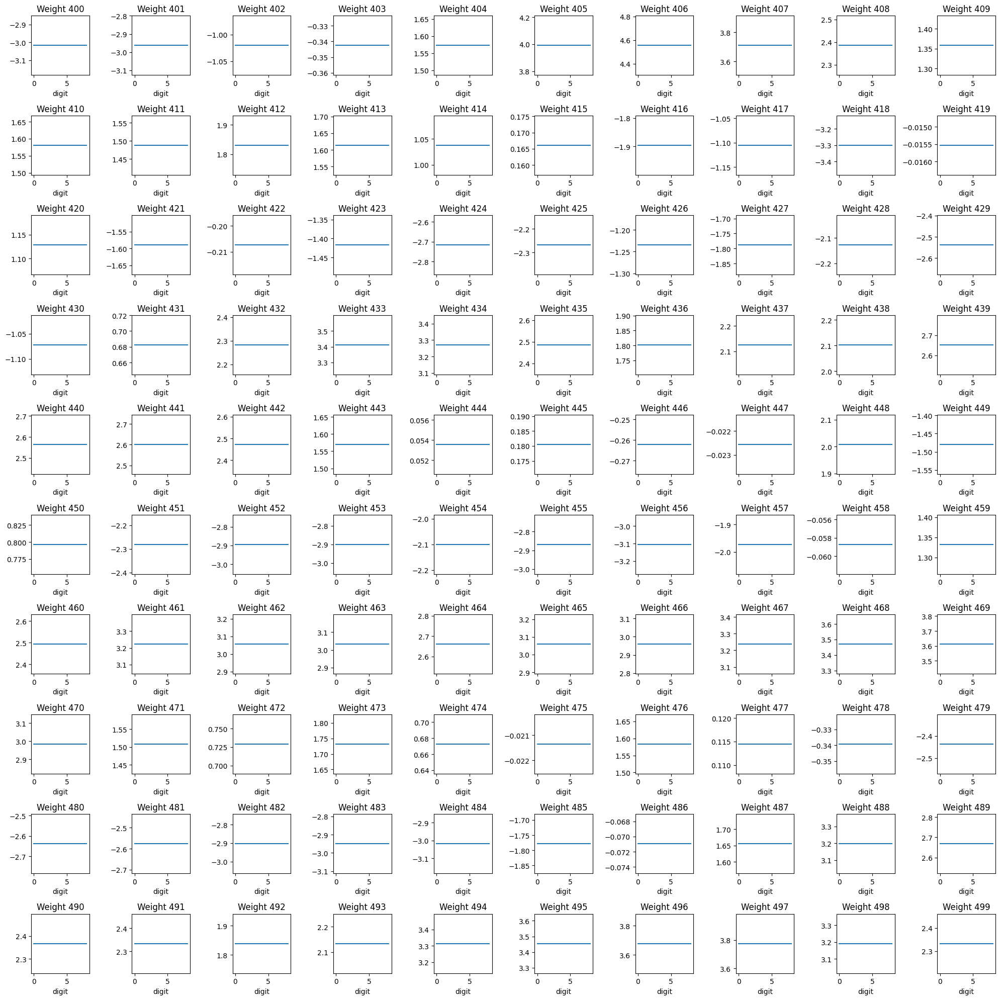

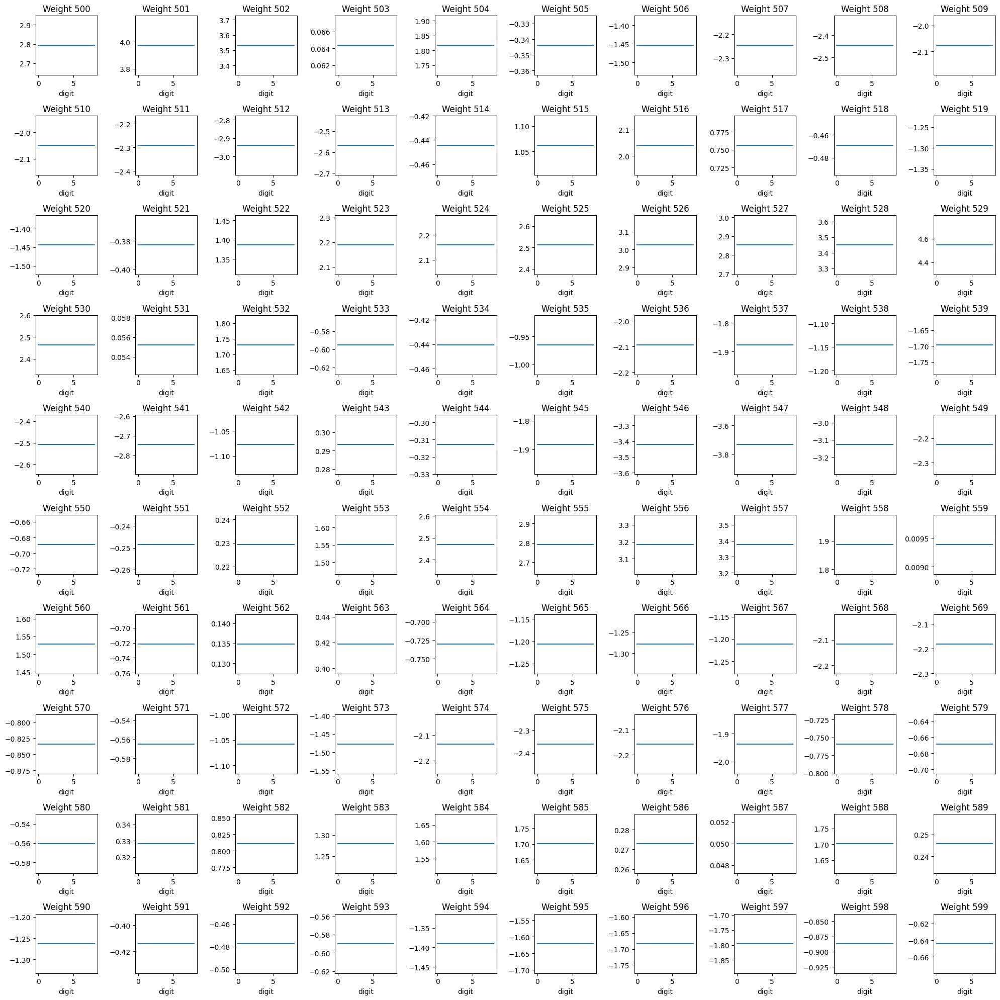

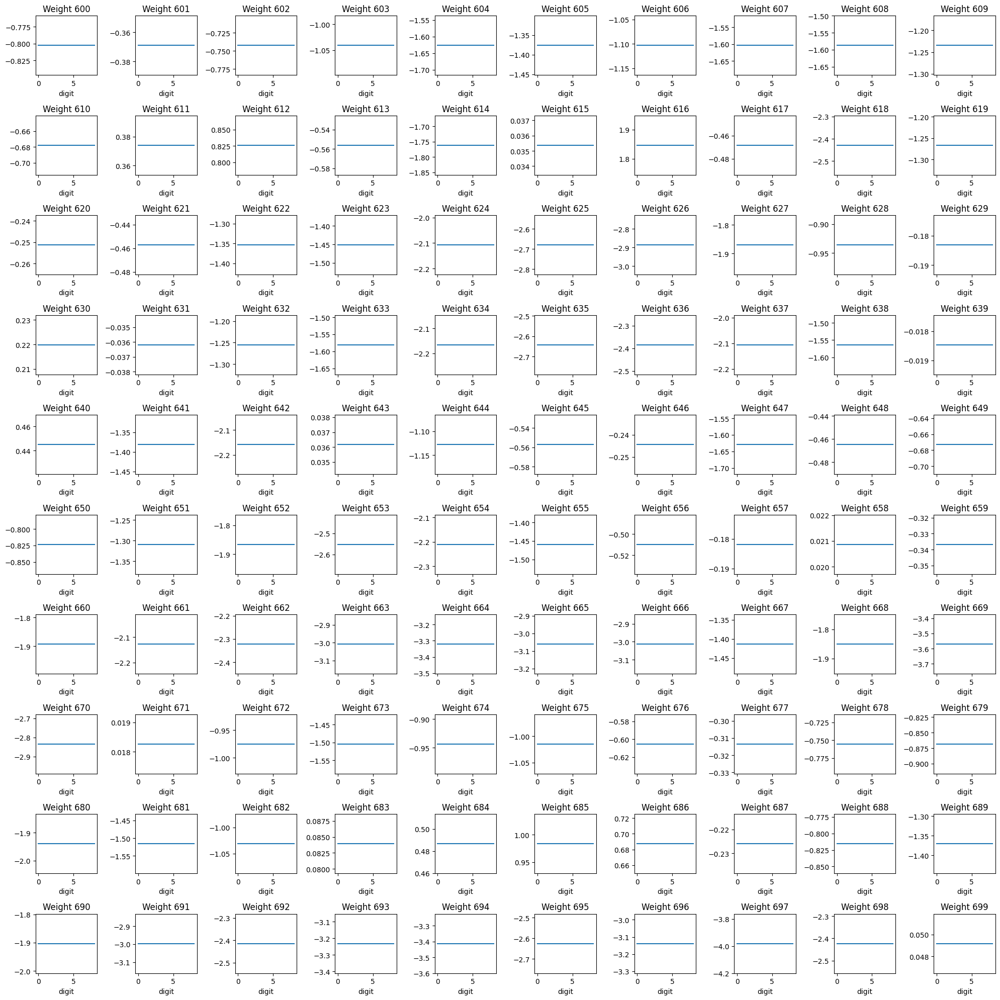

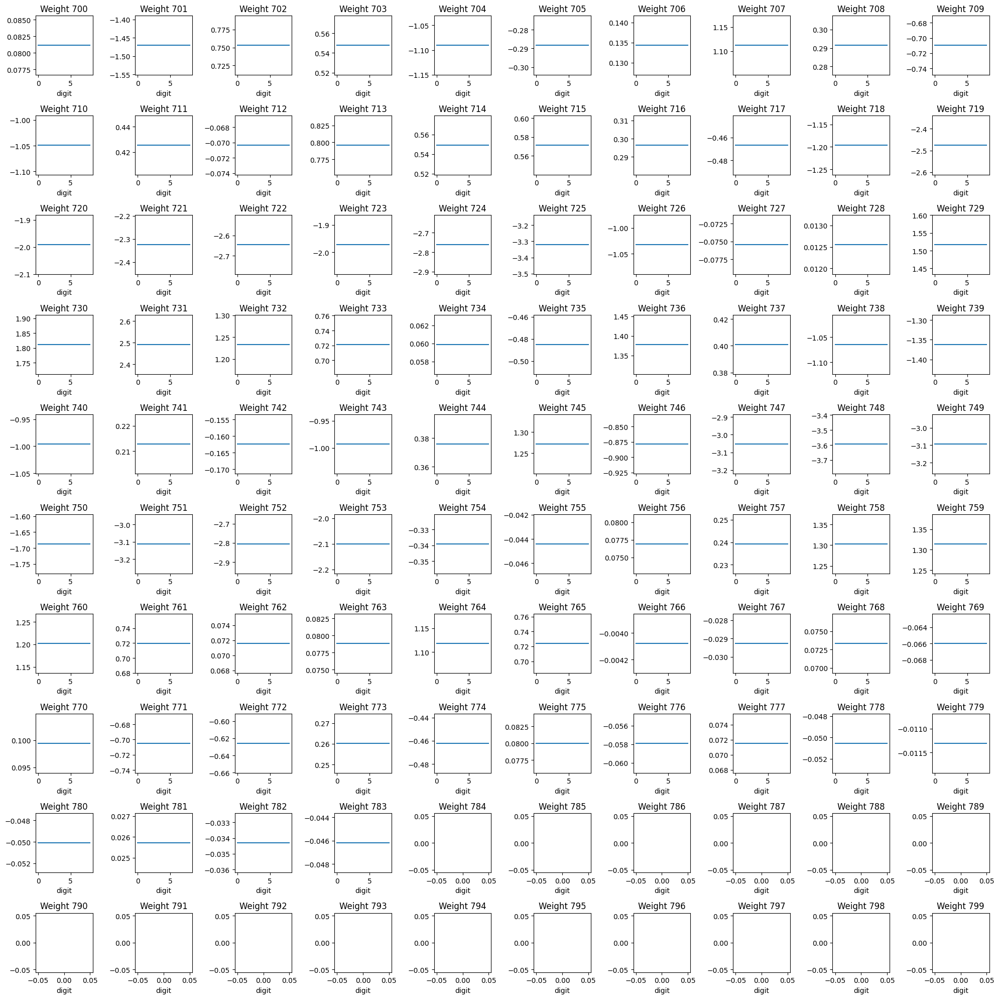

In [120]:
plot_neuron_weights(tii_D1, hz_neuron)
plot_neuron_weights(tii_D1, hz_neuron, pad=100)
plot_neuron_weights(tii_D1, hz_neuron, pad=200)
plot_neuron_weights(tii_D1, hz_neuron, pad=300)
plot_neuron_weights(tii_D1, hz_neuron, pad=400)
plot_neuron_weights(tii_D1, hz_neuron, pad=500)
plot_neuron_weights(tii_D1, hz_neuron, pad=600)
plot_neuron_weights(tii_D1, hz_neuron, pad=700)

Since the first output is greater than 0, the weights go back to their original value.

When the output is zero (example #2), the updated values are the same as the original weight values, which were changed in example #0. So, no updates were made.

#### n15

In [122]:
hz_neuron = 15

In [123]:
tii_X1[tii_X1.neuron == hz_neuron]

,neuron,digit,output
15,15,0,0.000000
64,15,1,0.632523
113,15,2,0.272594
162,15,3,0.222378
211,15,4,0.000000
260,15,5,0.254198
309,15,6,0.000000
358,15,7,0.000000
407,15,8,0.000000


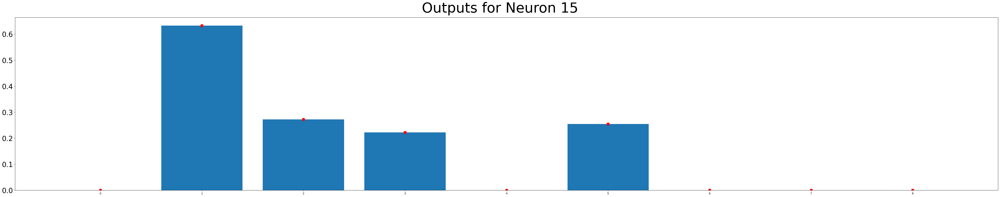

In [124]:
output_hz = tii_X1[tii_X1.neuron == hz_neuron][['output', 'digit']].reset_index(drop=True)

fig, axes = plt.subplots(1, 1, figsize=(50, 10), sharex=True)

# output_rn.plot(ax=axes, color='red')
# output_hz.plot(kind='bar', ax=axes)
plt.bar(output_hz.digit, output_hz.output)
plt.scatter(output_hz.digit, output_hz.output, color='red', s=100)

axes.tick_params(axis='y', labelsize=25)

fig.suptitle(f"Outputs for Neuron {hz_neuron}", fontsize=50)

# Display the plot
plt.tight_layout()
plt.show()

First zero is hit on example #0. 

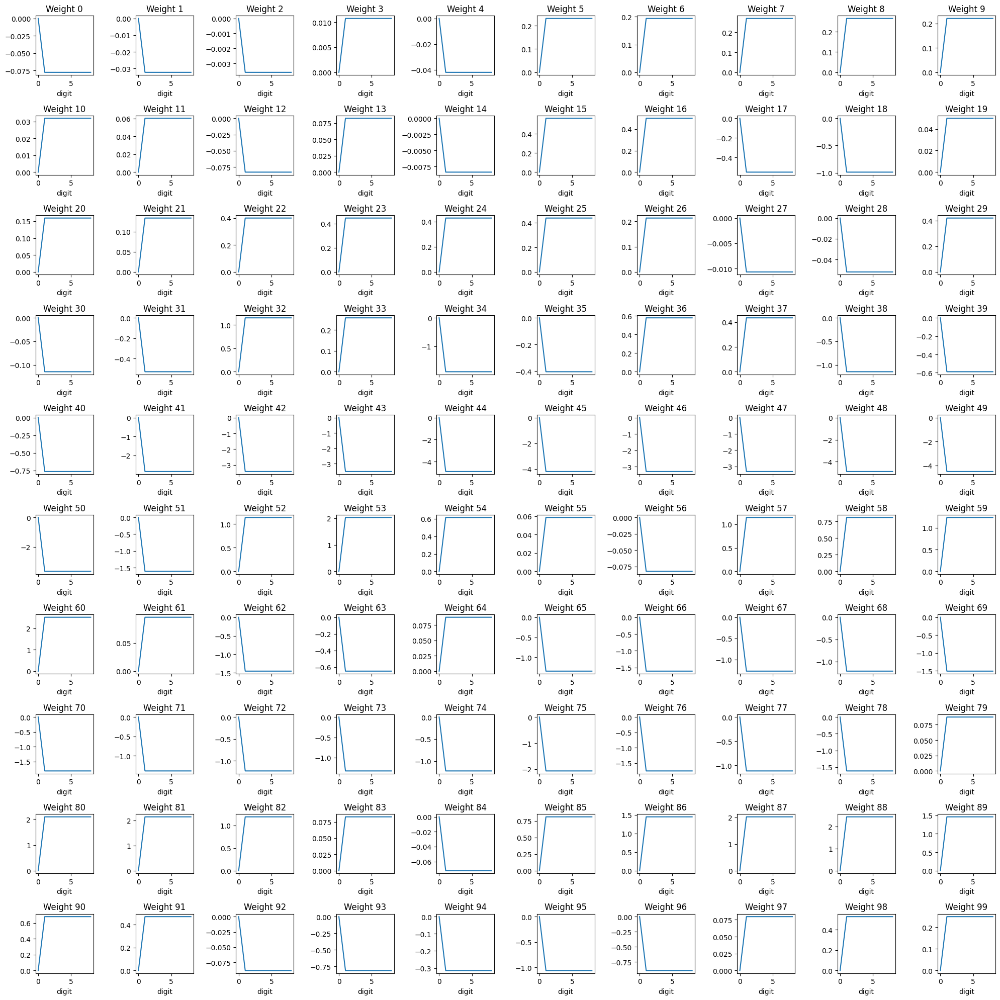

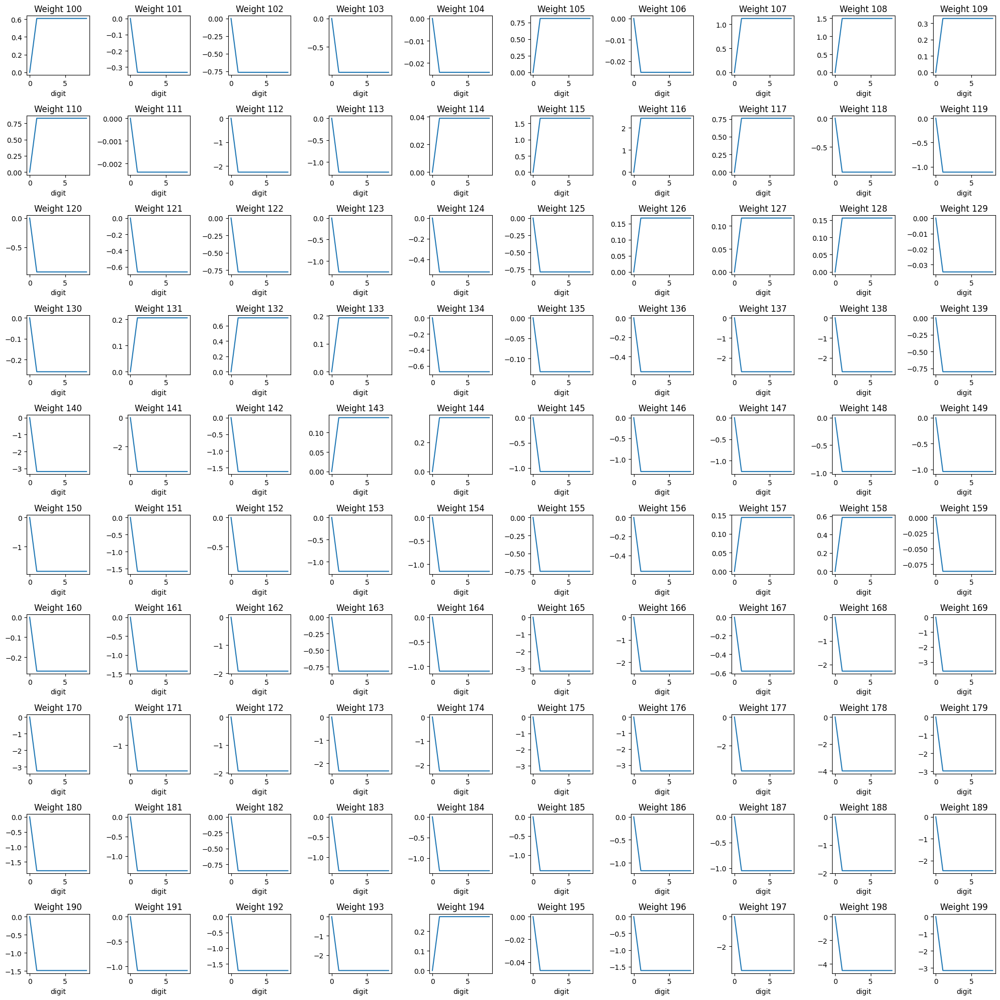

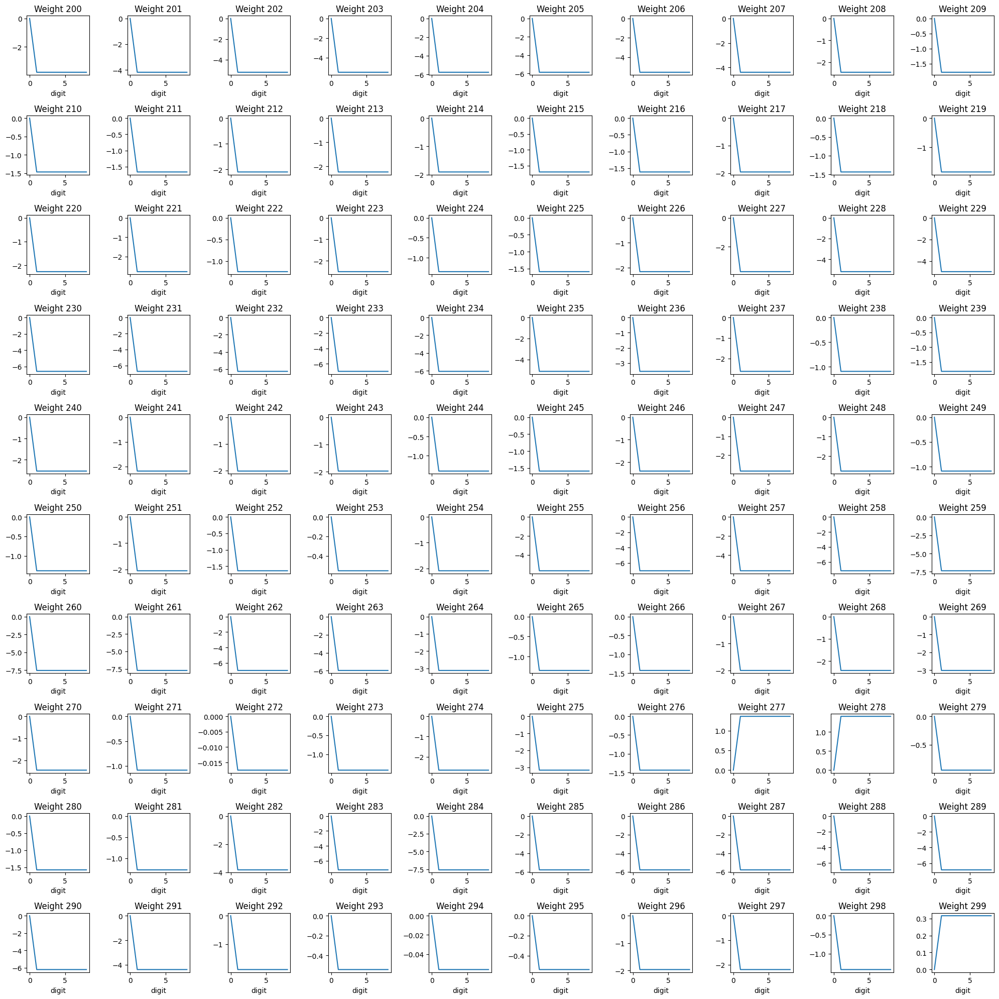

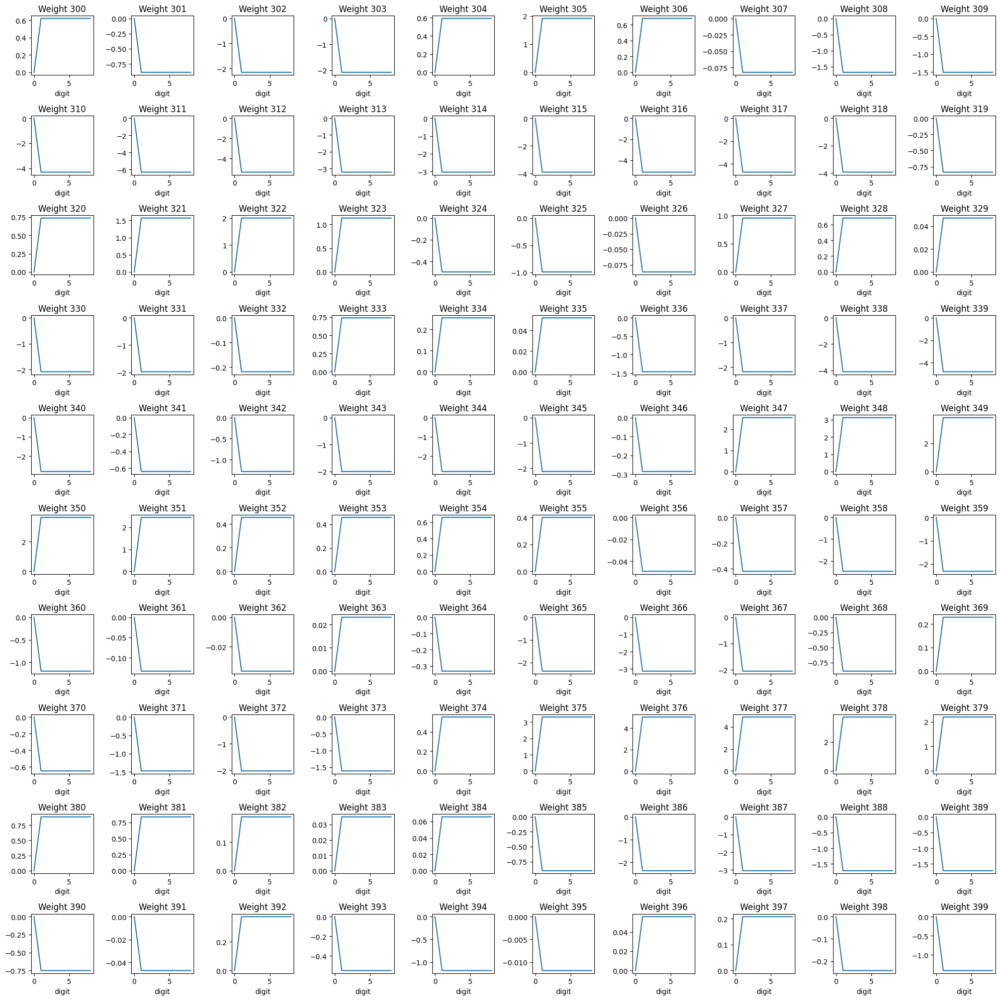

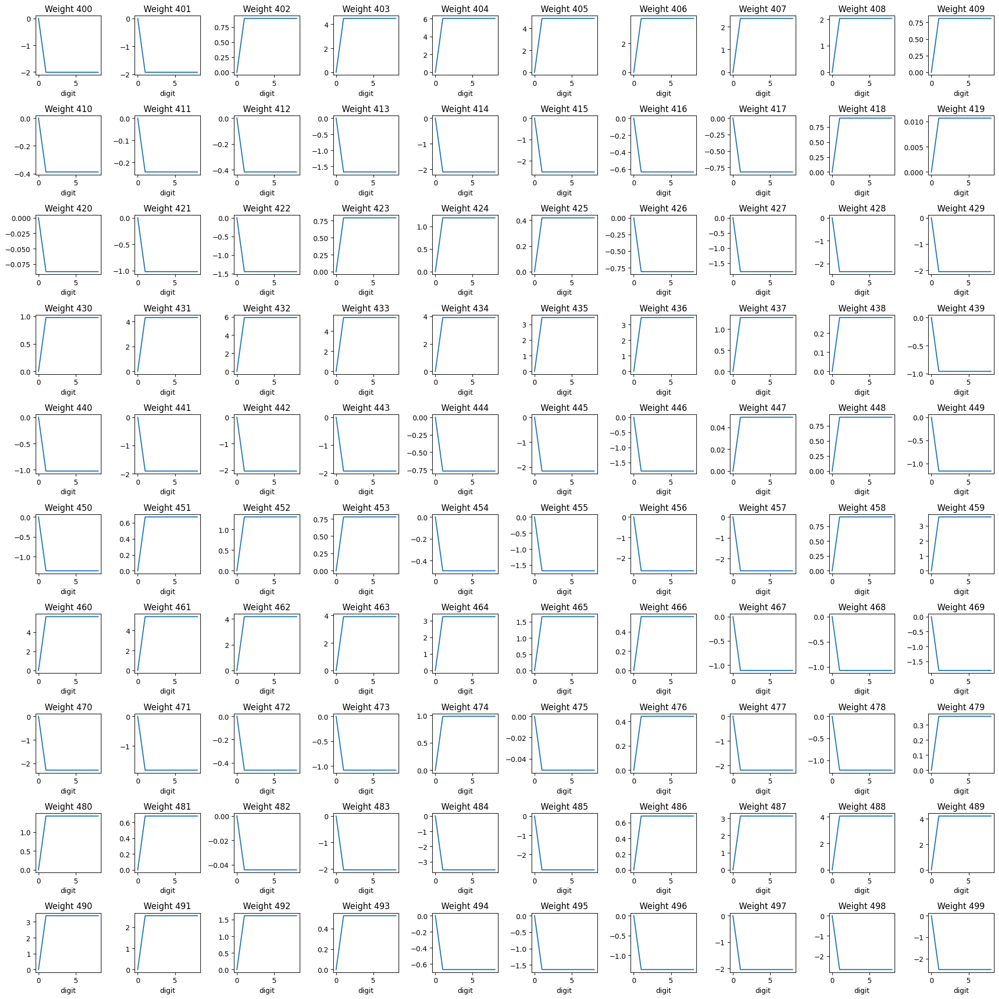

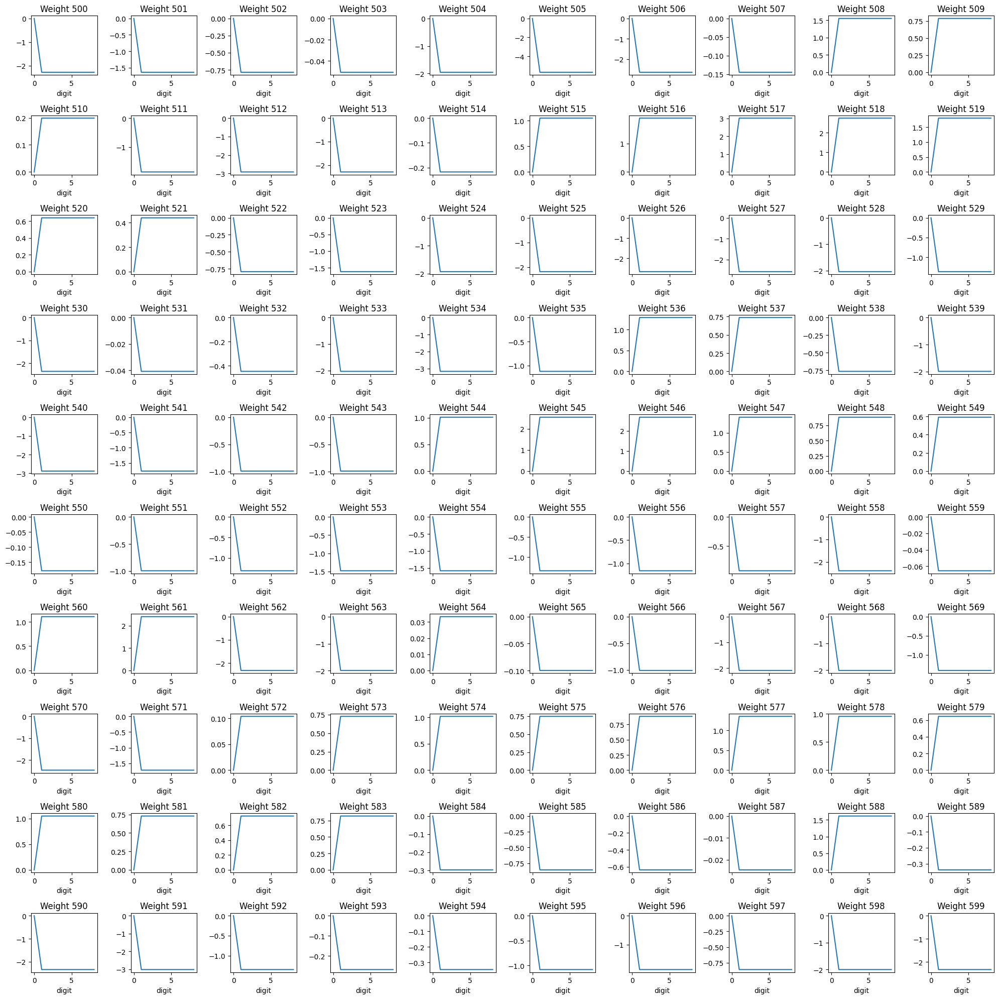

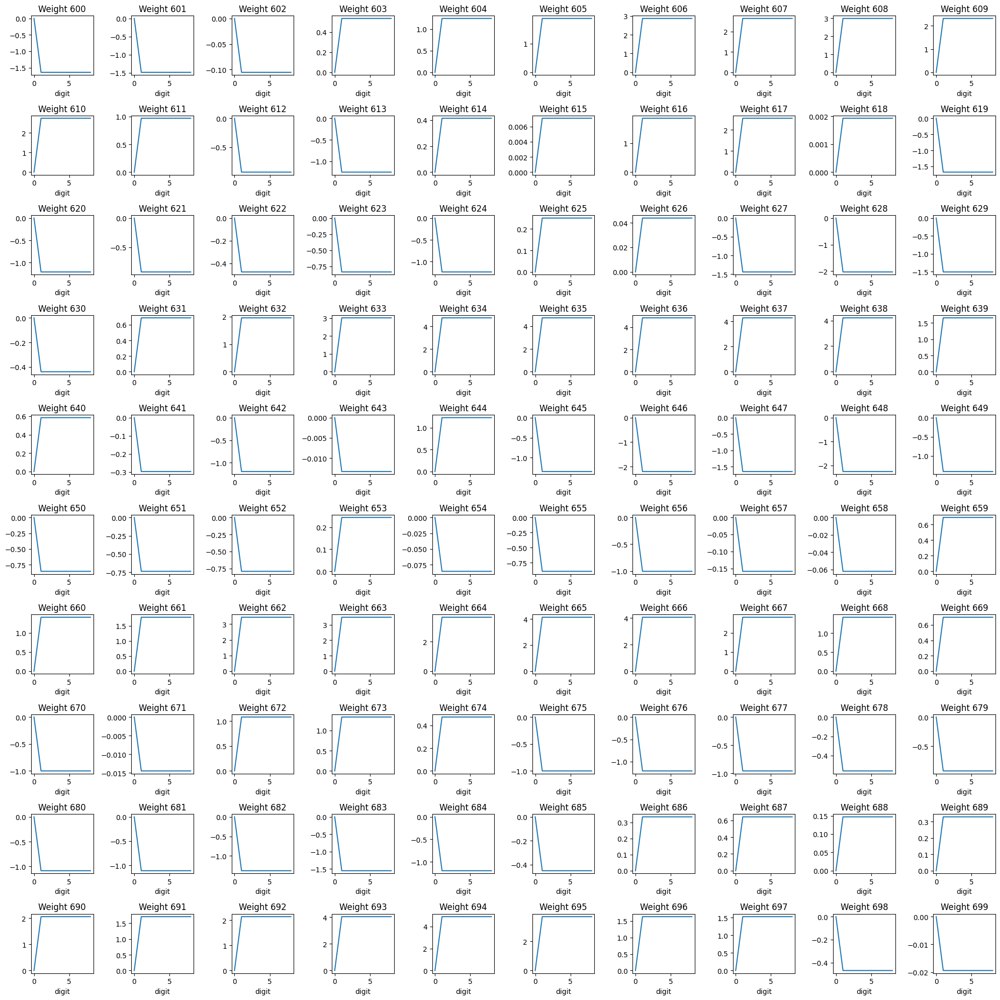

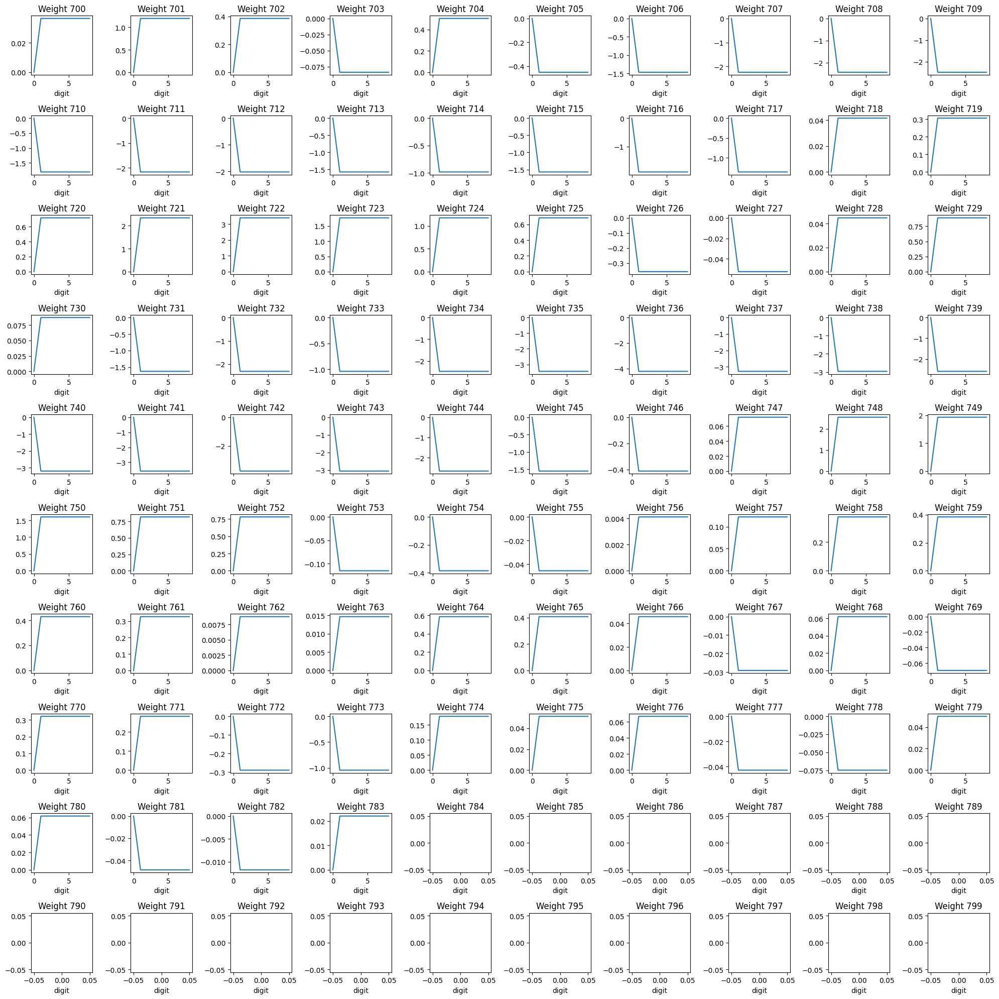

In [125]:
plot_neuron_weights(tii_D1, hz_neuron)
plot_neuron_weights(tii_D1, hz_neuron, pad=100)
plot_neuron_weights(tii_D1, hz_neuron, pad=200)
plot_neuron_weights(tii_D1, hz_neuron, pad=300)
plot_neuron_weights(tii_D1, hz_neuron, pad=400)
plot_neuron_weights(tii_D1, hz_neuron, pad=500)
plot_neuron_weights(tii_D1, hz_neuron, pad=600)
plot_neuron_weights(tii_D1, hz_neuron, pad=700)

In [126]:
D1[str(hz_neuron)]

0         0.0
1         0.0
2         0.0
3         0.0
4         0.0
         ... 
365339    0.0
365340    0.0
365341    0.0
365342    0.0
365343    0.0
Name: 15, Length: 407680, dtype: float64

Originally, all the weights for this neuron were zero. In the first example, the output of the neuron was zero. So, the weights of the CI operation were kept. In the Second example, the output was greater than zero. Then, the weights were updated to their original values. With this update, no other changes could be made, since comparisons always result in the original weight values.

## Selected neurons and Weights

#### Dense Layer

In [141]:
post_tii_df = pd.DataFrame(slc.D1).transform(lambda x: x != 0).astype(int).reset_index(drop=True)

In [143]:
print("Neurons with any positive weights:")
post_tii_df.sum().transform(lambda x: x != 0).astype(int).value_counts()

Neurons with any positive weights:


1    29
0    20
Name: count, dtype: int64

Text(0.5, 1.0, 'Neurons selected for the module after CI procedure')

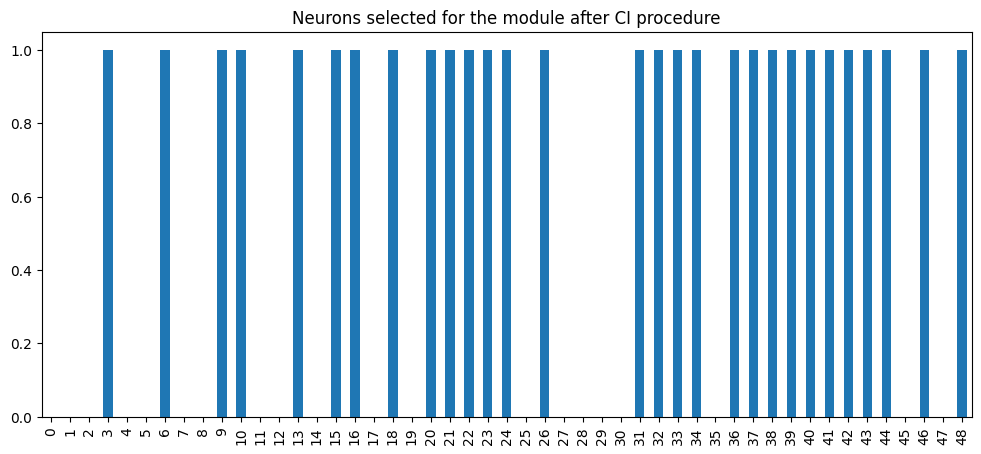

In [129]:
post_tii_df.sum().map(lambda x: 1 if x >= 1 else 0).plot(kind='bar', figsize=(12,5))
plt.title('Neurons selected for the module after CI procedure')

29 neurons were selected during the TI phase of the algorithm.

<Axes: >

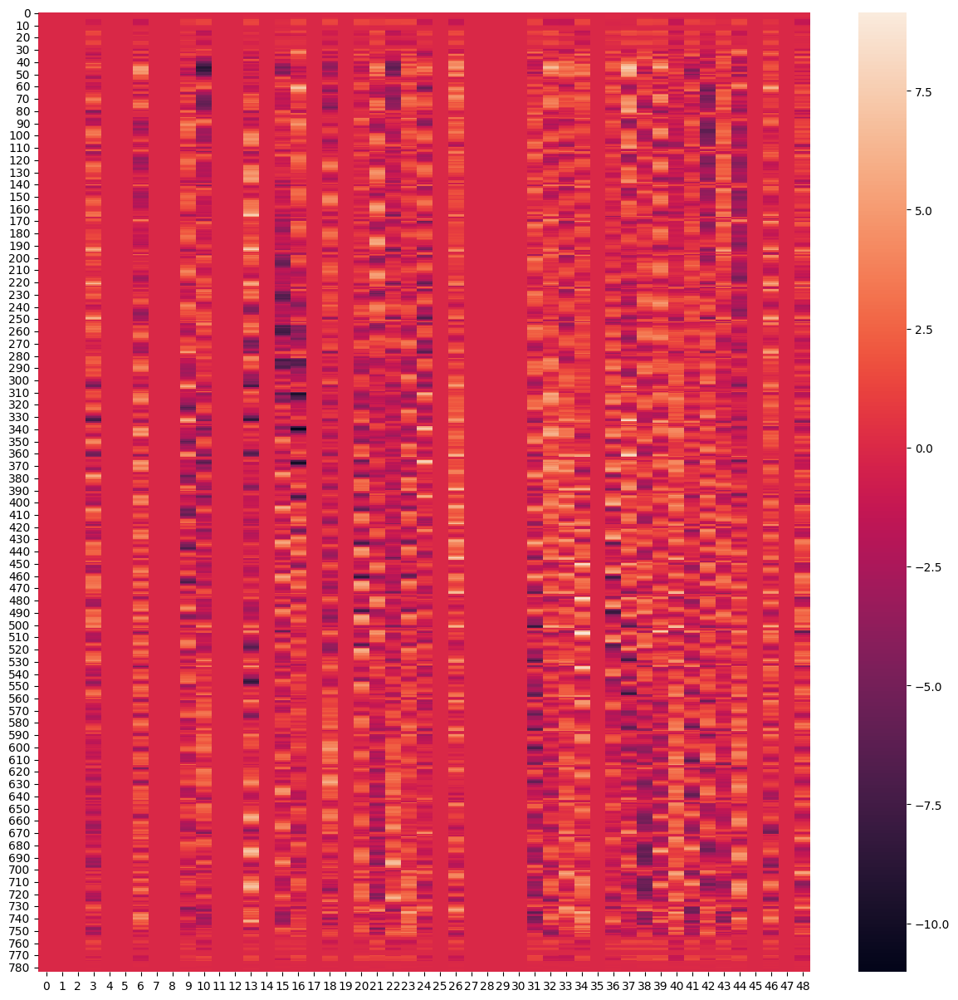

In [144]:
plt.figure(figsize=(15,15))
sns.heatmap(pd.DataFrame(slc.D1))#, annot=True)

Since the weights of some neurons were brought back, some negative weights are present in the final selection.

Text(0.5, 1.0, 'Selected Weights for the module after CI procedure')

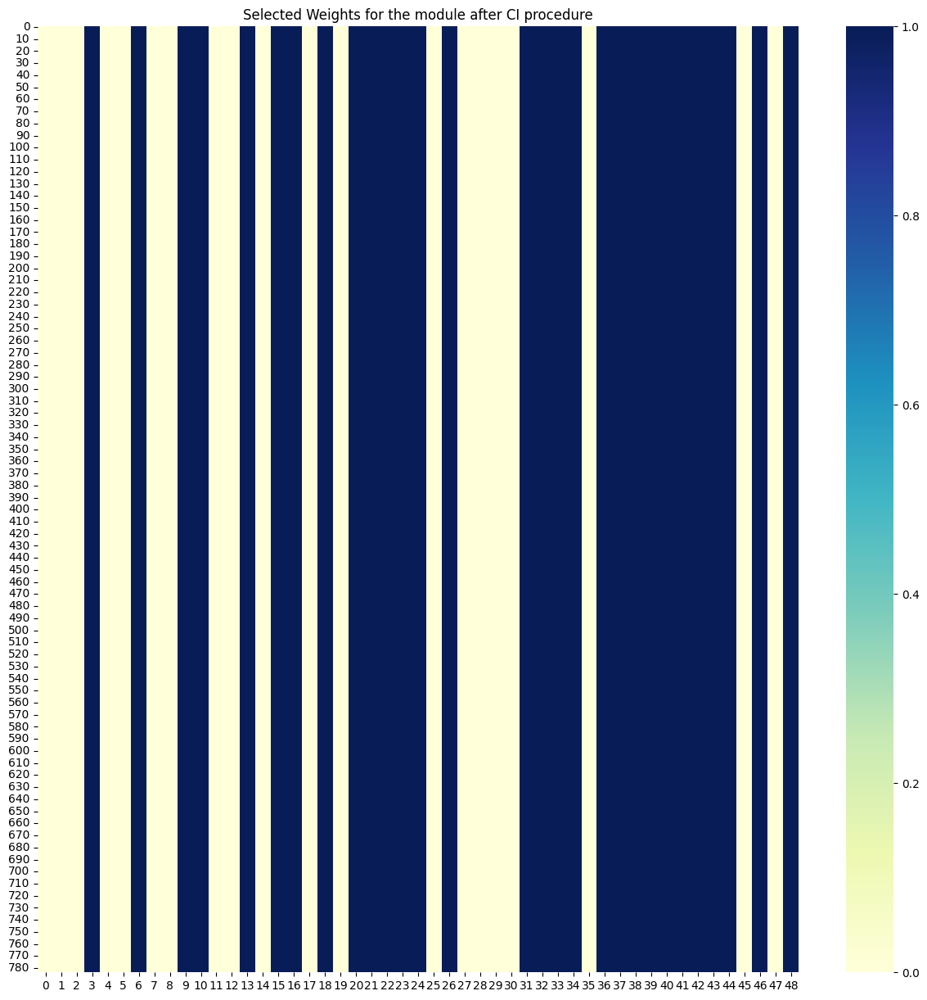

In [145]:
plt.figure(figsize=(15,15))
sns.heatmap(post_tii_df, cmap='YlGnBu', fmt="g")
plt.title('Selected Weights for the module after CI procedure')

All the weights of the selected neurons are utilized.

#### Output Layer

In [146]:
post_tii_output_df = pd.DataFrame(slc.D2).transform(lambda x: x != 0).astype(int).reset_index(drop=True)

In [147]:
print("Neurons with any positive weights:")
post_tii_output_df.sum().transform(lambda x: x != 0).astype(int).value_counts()

Neurons with any positive weights:


1    10
Name: count, dtype: int64

Text(0.5, 1.0, 'Neurons selected for the module after CI procedure')

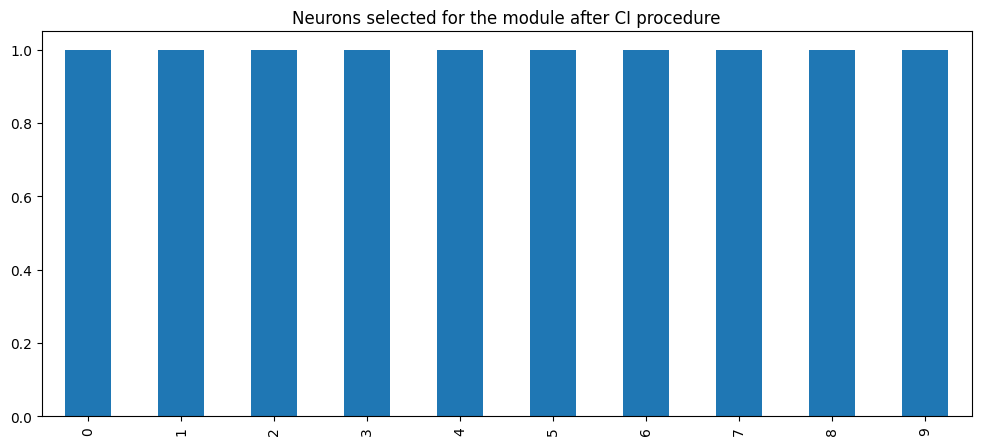

In [148]:
post_tii_output_df.sum().map(lambda x: 1 if x >= 1 else 0).plot(kind='bar', figsize=(12,5))
plt.title('Neurons selected for the module after CI procedure')

All output neurons were selected during the TI phase of the algorithm.

<Axes: >

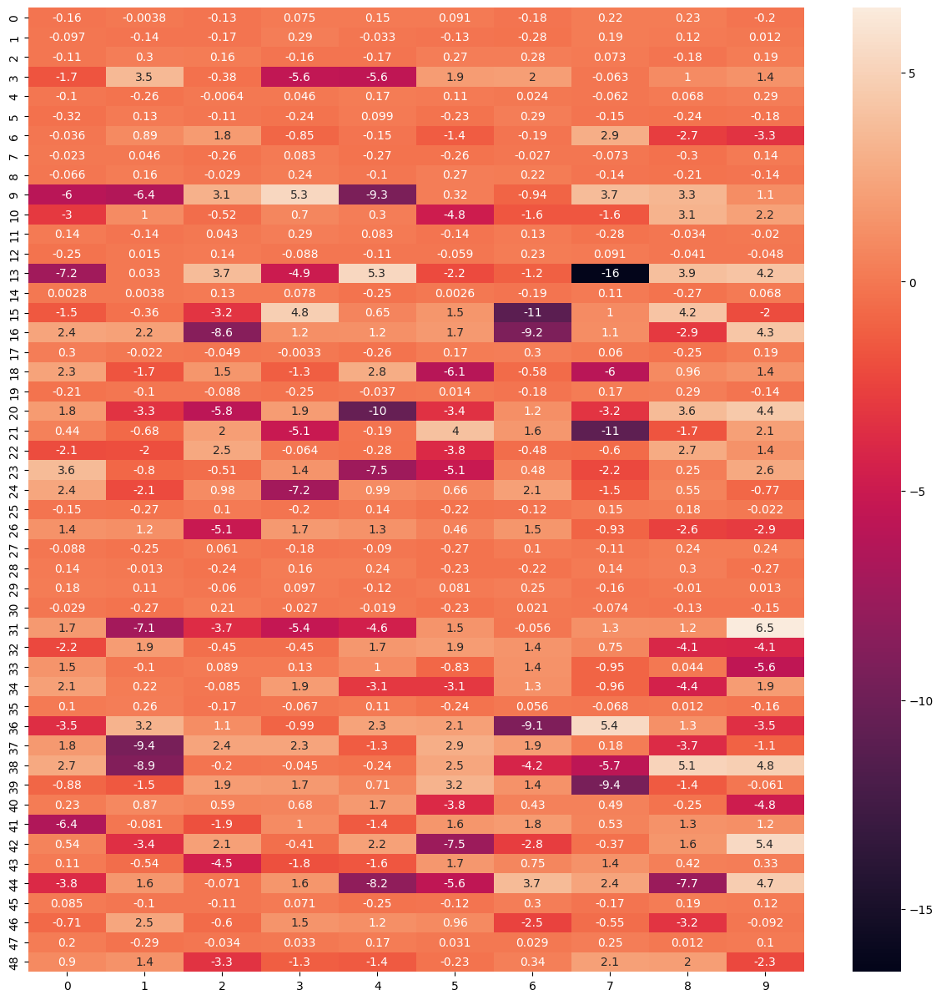

In [151]:
plt.figure(figsize=(15,15))
sns.heatmap(pd.DataFrame(slc.D2), annot=True)

In [ ]:
display(pd.DataFrame(slc.D2).sum() == pd.DataFrame(W2).sum())


0    True
1    True
2    True
3    True
4    True
5    True
6    True
7    True
8    True
9    True
dtype: bool

The output layer weights are the same as the original model.

## Conclusion of the TI-I analysis

- They use the test set to update de weights.
- In the Dense layer
    - The CI result is kept only in cases where all the outputs are zero. If a single output is greater than zero, all the weights go back to their original values for that neuron.
- In the Output layer
    - Weights are kept as they are.